In [1]:
%matplotlib inline

import pickle
import matplotlib.pyplot as plt
from matplotlib import colors
from mpl_toolkits.mplot3d import Axes3D
from functools import reduce
import numpy as np
import pandas as pd
import ipdb
import copy
plt.rcParams['figure.dpi'] = 150

In [2]:
p2AUC_dict_intersect = '/data/jianhao/hepatocyte_update_dataset_101619/intersect_same_length_weight/intersected_AUC_dict_monoc_3_states_hepa_simic'
p2AUC_dict_all = '/data/jianhao/hepatocyte_update_dataset_101619/AUC_dict_monoc_3groups_1118'

In [3]:
p2assignment = '/data/jianhao/hepatocyte_update_dataset_101619/monoc_simple_group_assign'
assign_list = []
with open(p2assignment, 'r') as f:
    for line in f:
        assign_list.append(int(line))
print(len(assign_list))
print(set(assign_list))

18272
{0, 1, 2}


------
# Compute histogram of AUC for all TFs

In [4]:
def separate_state(AUC_dict):
    for state in AUC_dict.keys():
        tmp_AUC = AUC_dict[state]
        tmp_AUC = tmp_AUC.iloc[[idx for idx, label in enumerate(assign_list) if label == state]]
        AUC_dict[state] = tmp_AUC
    return AUC_dict

In [5]:
def compute_hist(AUC_dict, num_TF = 200):
    x_min = np.ones(num_TF)
    x_max = -1 * np.ones(num_TF)
    # find min and max of AUC values in all states.
    for label in AUC_dict:
        min_AUC = AUC_dict[label].min(axis = 0)
        max_AUC = AUC_dict[label].max(axis = 0)
        x_min = np.minimum(min_AUC, x_min)
        x_max = np.maximum(max_AUC, x_max)

    i = 5
    TF_hist_dict = {}
    for idx, TF in enumerate(AUC_dict[1].columns):    
    #     i -= 1
        cap_TF = TF.capitalize()
        TF_hist_dict[cap_TF] = {}
        nbins = 50
        bar_width =  (-x_min[idx] + x_max[idx]) / nbins
        if bar_width != 0:
            bin_list = np.arange(x_min[idx], x_max[idx] + bar_width, bar_width)
        else:
            bin_list = np.arange(0, 1 + 1/nbins, 1/nbins)


        label_order = sorted(list(AUC_dict.keys()))

        for label in label_order:
            AUC_df = AUC_dict[label]      
            y = AUC_df[TF].values.tolist()

            hist, _ = np.histogram(y, bins = bin_list,
                                  weights=np.ones(len(y)) / len(y))

            xs = (bin_list[:-1] + bin_list[1:])/2
            legend_name = 'state {}'.format(label)

            TF_hist_dict[cap_TF][label] = {
                'hist': hist,
                'xs': xs
            }
        if i < 0:
            break
    return TF_hist_dict

def compute_hist_mat(TF_hist_dict):
    TF_hist_mat_dict = {}
    num_of_TF = len(TF_hist_dict)
    for TF in TF_hist_dict:
        num_of_bins = len(TF_hist_dict[TF][1]['hist'])
        num_of_labels = len(TF_hist_dict[TF])
        tmp_hist_mat = np.zeros((num_of_labels, num_of_bins))
        for row_idx, label in enumerate(TF_hist_dict[TF]):
            tmp_row = TF_hist_dict[TF][label]['hist']
            tmp_hist_mat[row_idx, :] = tmp_row
        TF_hist_mat_dict[TF] = tmp_hist_mat
    return TF_hist_mat_dict
        
def get_hist_mat_dict(p2AUC_dict, num_TF = 200):
    with open(p2AUC_dict, 'rb') as f:
        AUC_dict = pickle.load(f)
    AUC_dict = separate_state(AUC_dict)
    TF_hist_dict = compute_hist(AUC_dict, num_TF)
    TF_hist_mat_dict = compute_hist_mat(TF_hist_dict)
    return TF_hist_mat_dict, TF_hist_dict

In [6]:
TF_hist_mat_dict_simic, TF_hist_dict_simic = get_hist_mat_dict(p2AUC_dict_intersect)
TF_hist_mat_dict_no_simic, TF_hist_dict_no_simic = get_hist_mat_dict(p2AUC_dict_all)
len(TF_hist_mat_dict_simic)

200

In [7]:
# TF_hist_dict_simic
# TF_hist_mat_dict_simic

------
# Compute the total variant of histograms

In [8]:
def total_variant(dist1, dist2):
    abs_diff = np.abs(np.array(dist1) - np.array(dist2))
    TV = 1/2 * np.sum(abs_diff)
    return TV

def aver_TV_of_hist(hist_mat):
    '''
    hist_mat: num_labels * len_of_hist
    '''
    num_labels, _ = hist_mat.shape
    count_of_TVs = num_labels * (num_labels - 1)
    sum_of_TVs = 0
    for row_idx in range(num_labels):
        remaining_rows = np.delete(np.arange(num_labels), row_idx)
        row_1 = hist_mat[row_idx, :]
        for row_2_idx in remaining_rows:
            row_2 = hist_mat[row_2_idx, :]
            sum_of_TVs += total_variant(row_1, row_2)
    average_TV = sum_of_TVs / count_of_TVs
    return average_TV
    
def list_of_TV_of_hist(hist_mat):
    '''
    hist_mat: num_labels * len_of_hist
    '''
    num_labels, _ = hist_mat.shape
    count_of_TVs = num_labels * (num_labels - 1)
    list_of_TVs = []
    for row_idx in range(num_labels):
        remaining_rows = range(row_idx + 1, num_labels)
        row_1 = hist_mat[row_idx, :]
        for row_2_idx in remaining_rows:
            row_2 = hist_mat[row_2_idx, :]
            tmp_TV = total_variant(row_1, row_2)
            list_of_TVs.append(tmp_TV)
    return list_of_TVs

def minmax_variant_of_hist(hist_mat):
    max_hist = np.max(hist_mat, axis = 0)
    min_hist = np.min(hist_mat, axis = 0)
    minmax_diff = max_hist - min_hist
    variant = np.sum(np.abs(minmax_diff)) / hist_mat.shape[0]
    
    return variant

In [9]:
def get_divergence_df(TF_hist_mat_dict):
    hist_divergence_df = pd.DataFrame(columns = TF_hist_mat_dict.keys(), 
                                      index = ['average TV', 'median TV', 'max TV', 'minmax variant'])
    for TF in TF_hist_mat_dict.keys():
        tmp_hist_mat = TF_hist_mat_dict[TF]
        tf_aver_TV = aver_TV_of_hist(tmp_hist_mat)
        hist_divergence_df[TF]['average TV'] = tf_aver_TV

        TV_list = list_of_TV_of_hist(tmp_hist_mat)

        tf_median_TV = np.median(TV_list)
        hist_divergence_df[TF]['median TV'] = tf_median_TV

        tf_max_TV = np.max(TV_list)
        hist_divergence_df[TF]['max TV'] = tf_max_TV

        tf_minmax_variant = minmax_variant_of_hist(tmp_hist_mat)
        hist_divergence_df[TF]['minmax variant'] = tf_minmax_variant
    return hist_divergence_df

def get_TF_list_intersection(hist_divergence_df, k):
    sorted_by_ave_hist_divergence_df = hist_divergence_df.sort_values(by = 'average TV', axis = 1, ascending = False)
    sorted_by_med_hist_divergence_df = hist_divergence_df.sort_values(by = 'median TV', axis = 1, ascending = False)
    sorted_by_max_hist_divergence_df = hist_divergence_df.sort_values(by = 'max TV', axis = 1, ascending = False)
    sorted_by_minmax_var_divergence_df = hist_divergence_df.sort_values(by = 'minmax variant', axis = 1, ascending = False)
        
    top_k_minmax_TF = sorted_by_minmax_var_divergence_df.columns.values[:k]
    last_k_minmax_TF = sorted_by_minmax_var_divergence_df.columns.values[-k:]

    top_k_max_TF = sorted_by_max_hist_divergence_df.columns.values[:k]
    last_k_max_TF = sorted_by_max_hist_divergence_df.columns.values[-k:]

    top_k_median_TF = sorted_by_med_hist_divergence_df.columns.values[:k]
    last_k_median_TF = sorted_by_med_hist_divergence_df.columns.values[-k:]

    top_k_average_TF = sorted_by_ave_hist_divergence_df.columns.values[:k]
    last_k_average_TF = sorted_by_ave_hist_divergence_df.columns.values[-k:]

    top_d = (top_k_minmax_TF, top_k_max_TF, top_k_median_TF, top_k_average_TF)
    top_variant_TF = set.intersection(*map(set,top_d))

    last_d = (last_k_minmax_TF, last_k_max_TF, last_k_median_TF, last_k_average_TF)
    last_variant_TF = set.intersection(*map(set, last_d))
    
    return top_variant_TF, last_variant_TF

------
# Get TF list

In [10]:
k = 50

diver_df_simic = get_divergence_df(TF_hist_mat_dict_simic)
top_TF_simic, last_TF_simic = get_TF_list_intersection(diver_df_simic, k)

diver_df_no_simic = get_divergence_df(TF_hist_mat_dict_no_simic)
top_TF_no_simic, last_TF_no_simic = get_TF_list_intersection(diver_df_no_simic, k)

# find the common and difference among sets.
common_top = top_TF_simic.intersection(top_TF_no_simic)
common_last = last_TF_simic.intersection(last_TF_no_simic)

top_only_simic = top_TF_simic.difference(common_top)
top_only_no_simic = top_TF_no_simic.difference(common_top)

last_only_simic = last_TF_simic.difference(common_last)
last_only_no_simic = last_TF_no_simic.difference(common_last)

top_simic_last_no_simic = top_TF_simic.intersection(last_TF_no_simic)
last_simic_top_no_simic = last_TF_simic.intersection(top_TF_no_simic)

print('common top in simic and no-simic: ', len(common_top))
print(common_top)
print('- ' * 7)

print('common last in simic and no-simic: ', len(common_last))
print(common_last)
print('- ' * 7)

print()
print('>>' * 7, 'simic', '>>' * 7)
print('top only in simic: ', len(top_only_simic))
print(top_only_simic)
print('- ' * 7)

print('last only in simic: ', len(last_only_simic))
print(last_only_simic)
print('- ' * 7)

print()
print('>>' * 7, 'no-simic', '>>' * 7)
print('top only in no-simic: ', len(top_only_no_simic))
print(top_only_no_simic)
print('- ' * 7)

print('last only in no-simic: ', len(last_only_no_simic))
print(last_only_no_simic)
print('- ' * 7)

print()
print('>>' * 7, 'contradicting cases', '>>' * 7)
print('top in simic, but last in no-simic: ', len(top_simic_last_no_simic))
print(top_simic_last_no_simic)
print('- ' * 7)

print('last in simic, but top in no-simic: ', len(last_simic_top_no_simic))
print(last_simic_top_no_simic)
print('- ' * 7)

common top in simic and no-simic:  6
{'Foxa3', 'Prox1', 'Tsc22d1', 'Tfdp2', 'Ybx3', 'Klf15'}
- - - - - - - 
common last in simic and no-simic:  3
{'Cebpa', 'Atrx', 'Nr1d2'}
- - - - - - - 

>>>>>>>>>>>>>> simic >>>>>>>>>>>>>>
top only in simic:  18
{'Stat3', 'Foxq1', 'Irf9', 'Stat6', 'Mafg', 'Ncor1', 'Mxd4', 'Nfyb', 'Srebf1', 'Crebl2', 'Foxa2', 'Tsc22d2', 'Ssrp1', 'Jund', 'Hnf4a', 'Zkscan3', 'Foxo1', 'Nfx1'}
- - - - - - - 
last only in simic:  29
{'Bcl3', 'Tfam', 'Tsc22d3', 'Nfix', 'Nono', 'Junb', 'Pbrm1', 'Ncoa2', 'Sfpq', 'Mlxipl', 'Rora', 'Mef2a', 'Gtf3a', 'Zbtb38', 'Dnmt1', 'Zfp91', 'Lrrfip1', 'Nr1h3', 'Rreb1', 'Klf9', 'Nr5a2', 'Smarce1', 'Nfic', 'Nr0b2', 'Phf5a', 'Nr3c1', 'Peg3', 'Bhlhe40', 'Tcf25'}
- - - - - - - 

>>>>>>>>>>>>>> no-simic >>>>>>>>>>>>>>
top only in no-simic:  31
{'Bcl3', 'Tfam', 'Tcf25', 'Nfia', 'Tsc22d3', 'Junb', 'Nono', 'Onecut2', 'Pbrm1', 'Smarca5', 'Nr2f6', 'Sfpq', 'Rora', 'Epas1', 'Zfp91', 'Foxn3', 'Hes6', 'Stat1', 'Mier1', 'Smarce1', 'Rxra', 'Klf13', 'Nr1i3', 

In [11]:
def plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, gene_list):
    plt.rcParams['figure.dpi'] = 150
    for _, TF in enumerate(gene_list):    
        fig = plt.figure(figsize=plt.figaspect(0.4))
        print(TF)
        for idx, TF_hist_dict in enumerate([TF_hist_dict_simic, TF_hist_dict_no_simic]):
            label_order = sorted(list(TF_hist_dict[TF].keys()))
            ax = fig.add_subplot(1, 2, idx + 1, projection='3d')
            
            for label in label_order:
                xs = TF_hist_dict[TF][label]['xs']
                hist = TF_hist_dict[TF][label]['hist']
                nbins = len(xs)
                bar_width =  (xs[-1] - xs[0]) / nbins

                try:
                    ax.bar(xs, hist, zs = label, 
                           zdir = 'y',
                           width = bar_width,
                           alpha = 0.8,
                          )
                except:
                    print('error in ax.bar')
                    continue

            
            ax.set_xlabel('AUC')
            ax.set_ylabel('cell states')
            ax.set_yticks(label_order)
            if idx == 0:
                cond = 'intersection of targets'
            else:
                cond = 'all targets'
            ax.set_title('{}: Histogram of TF {}'.format(cond, TF.upper()))
        plt.show()


# TFs that are only rank top variant in intersection

Stat3


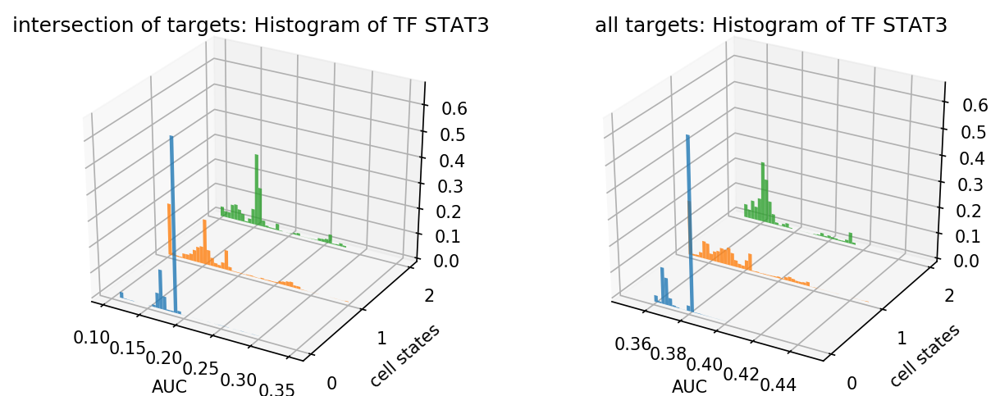

Foxq1


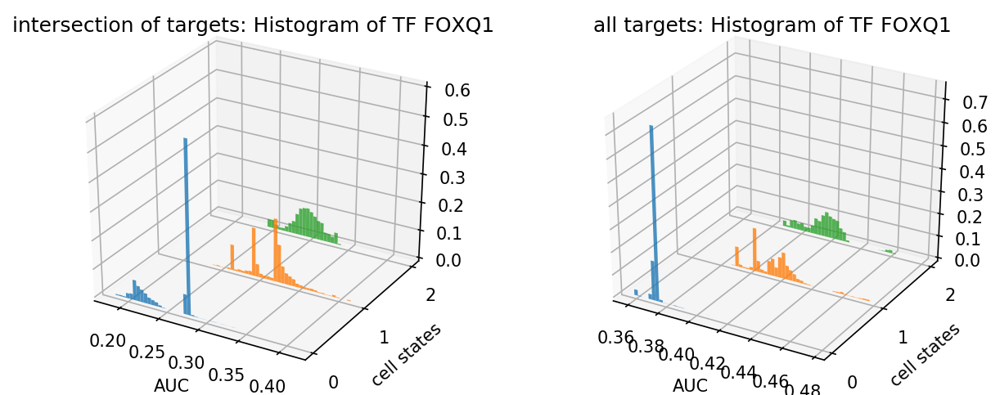

Irf9


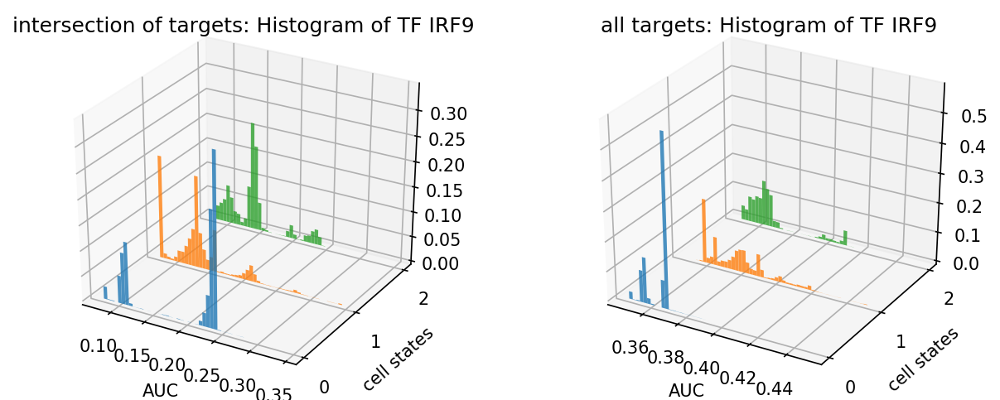

Stat6


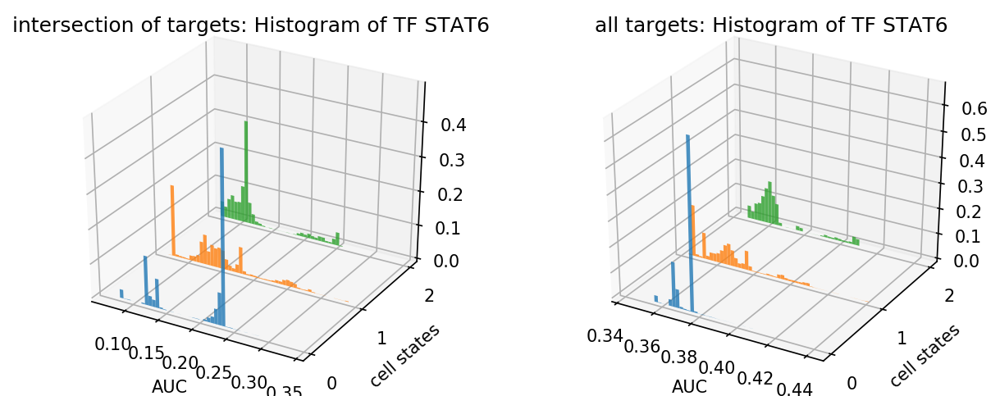

Mafg


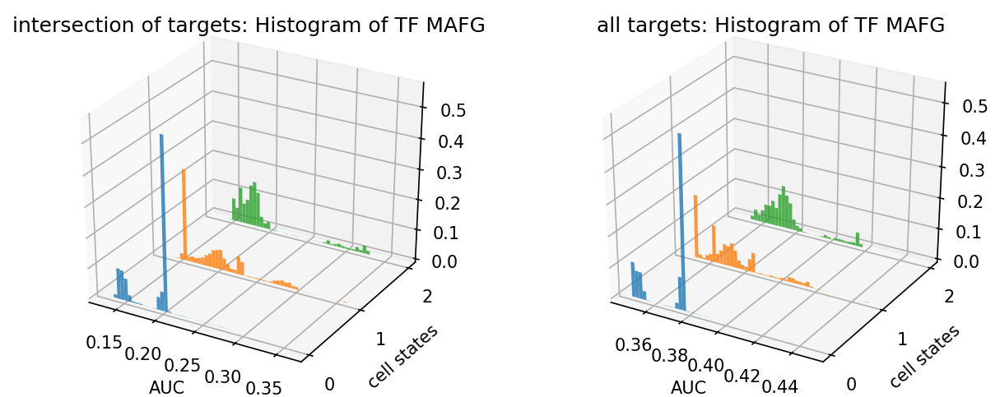

Ncor1


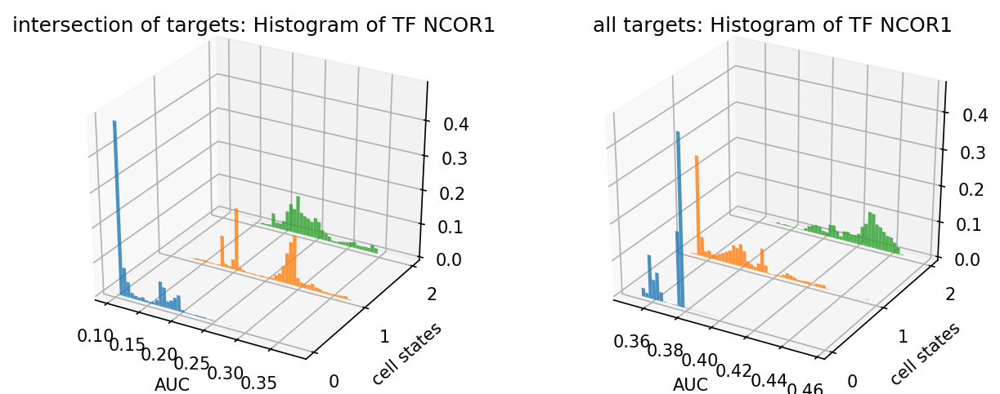

Mxd4


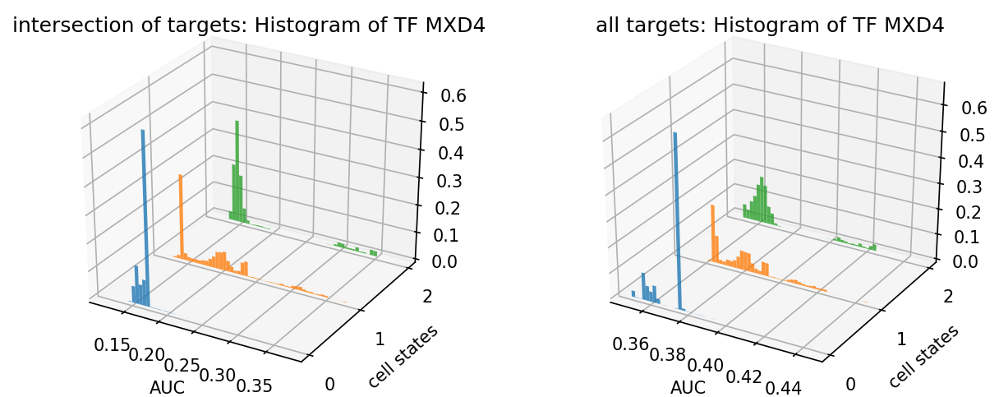

Nfyb


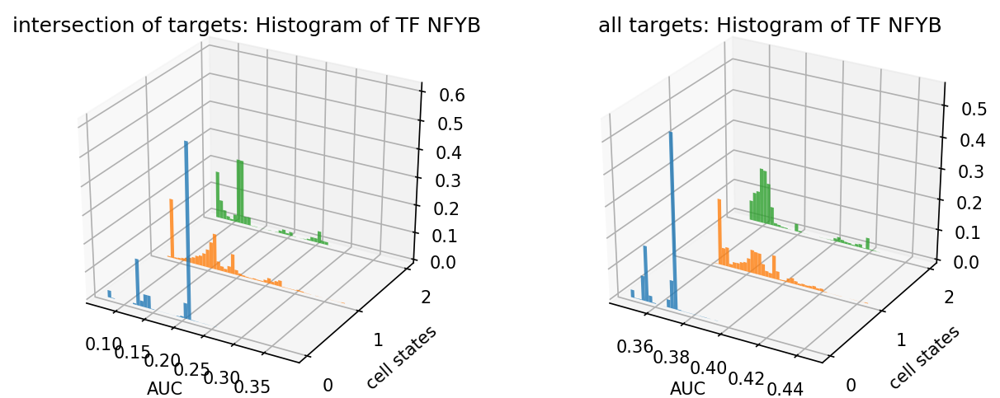

Srebf1


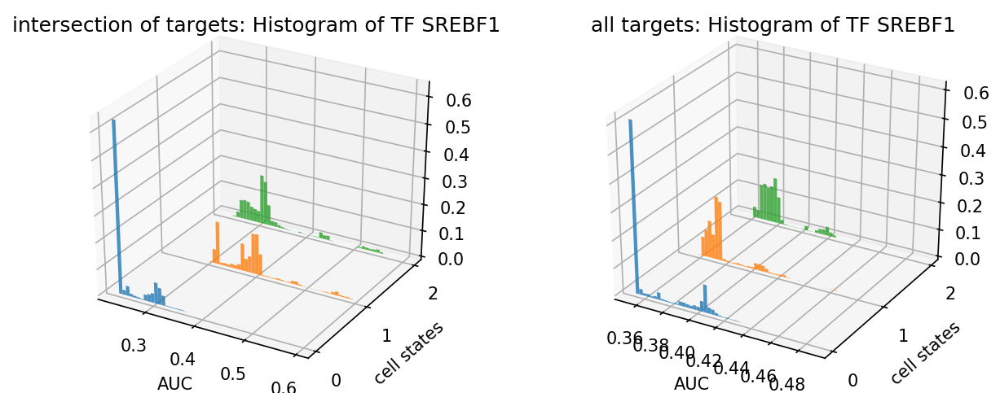

Crebl2


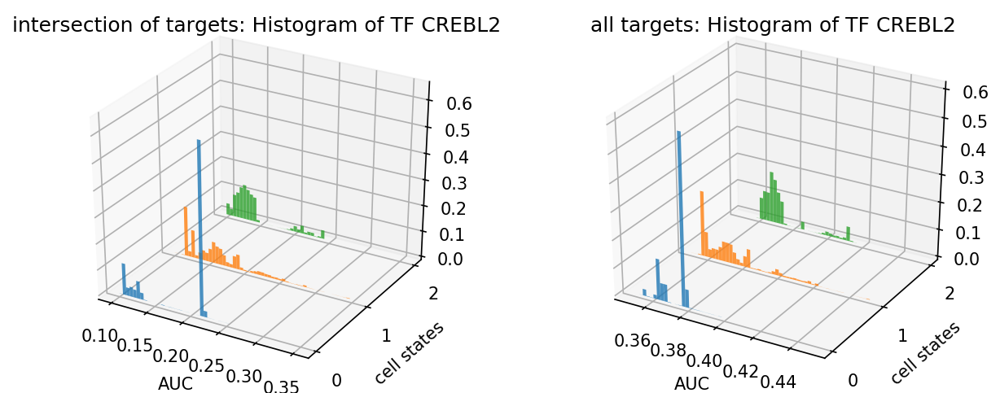

Foxa2


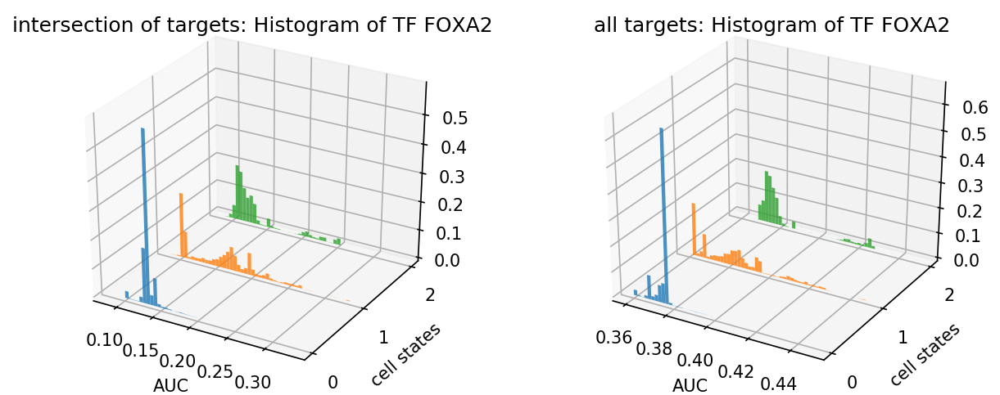

Tsc22d2


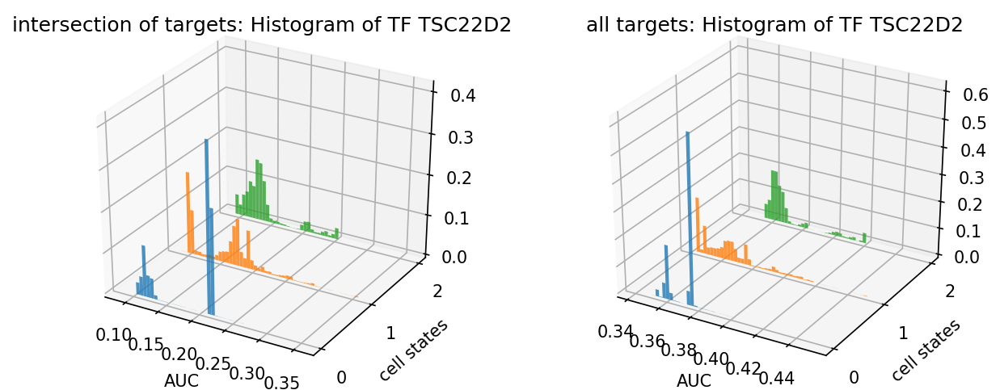

Ssrp1


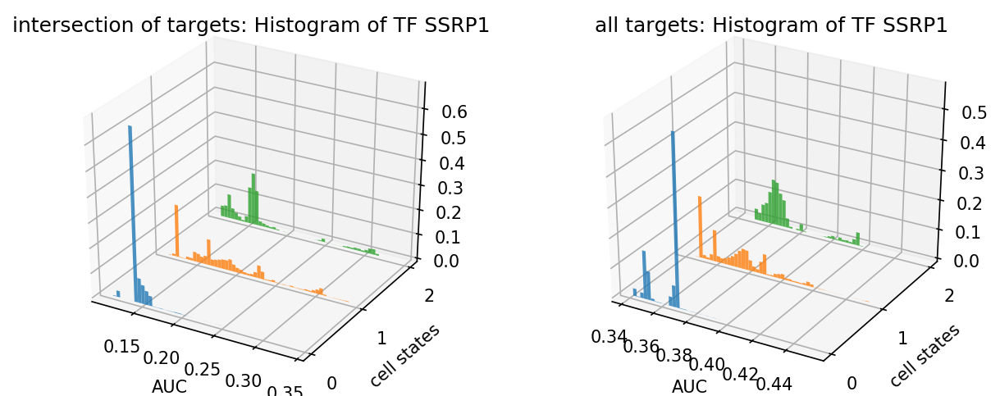

Jund


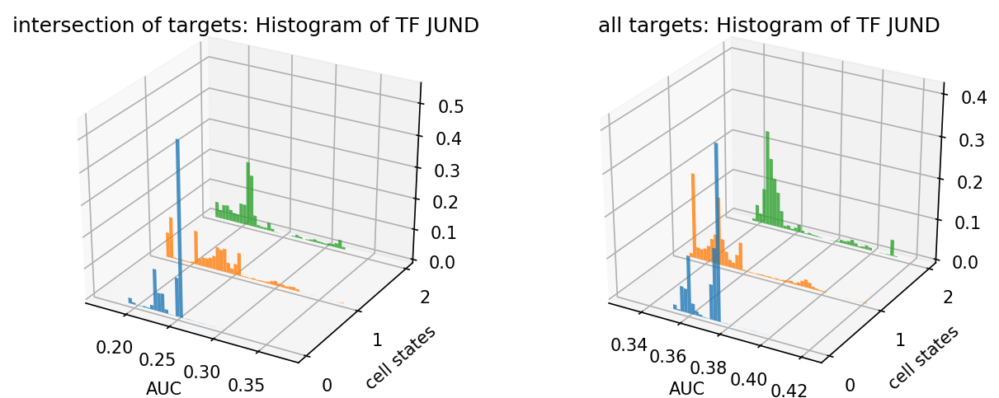

Hnf4a


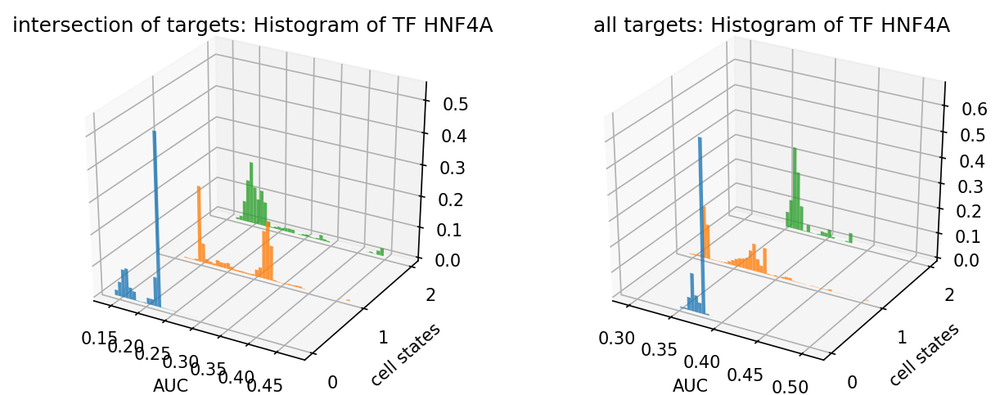

Zkscan3


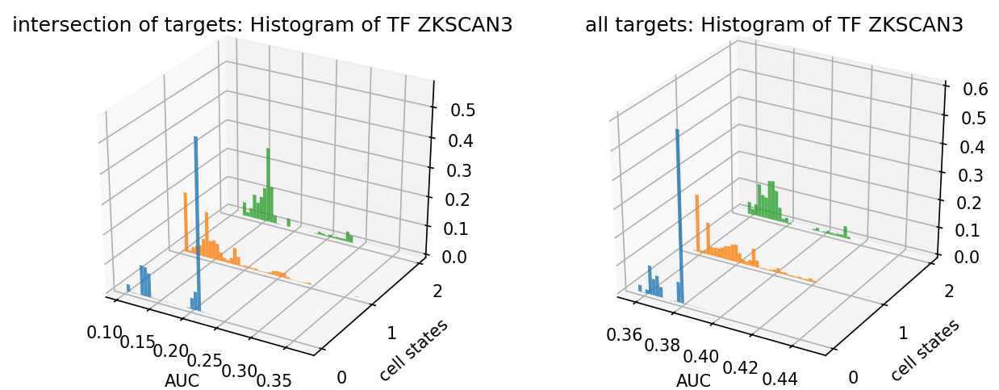

Foxo1


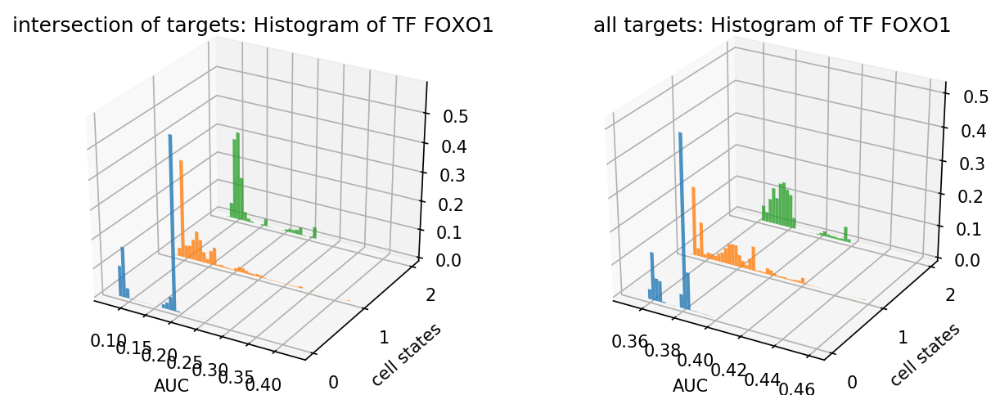

Nfx1


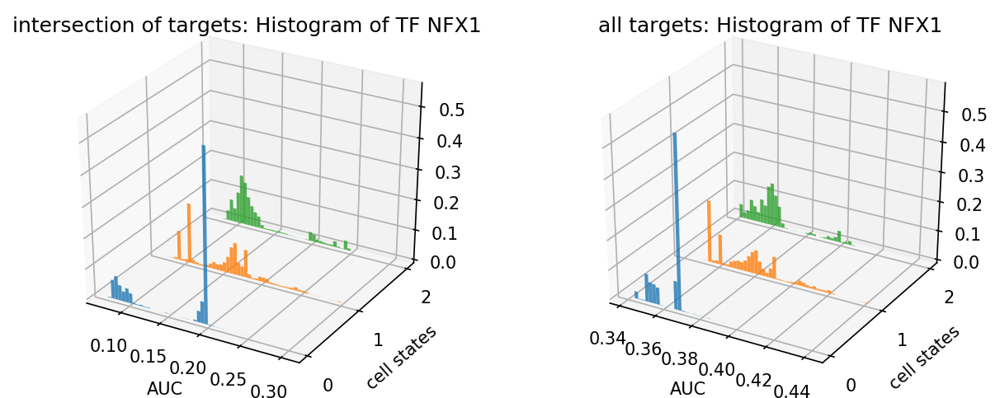

In [12]:
plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, top_only_simic)

# TFs that are only rank top varint in all targets

Bcl3


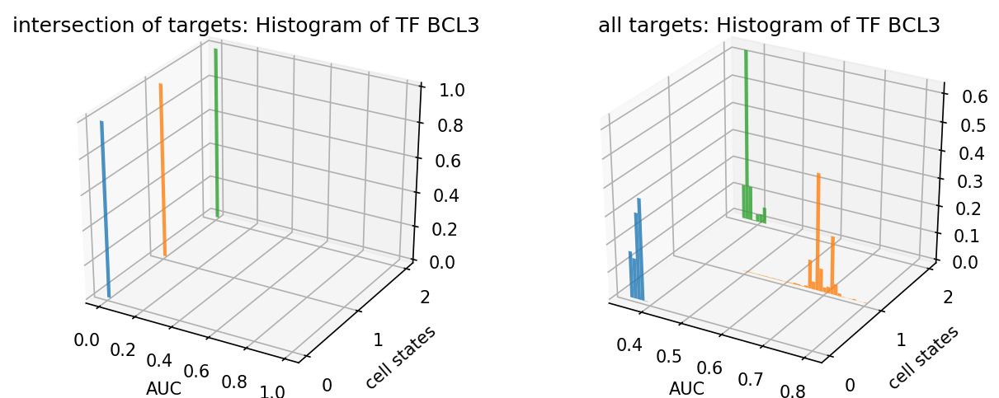

Tfam


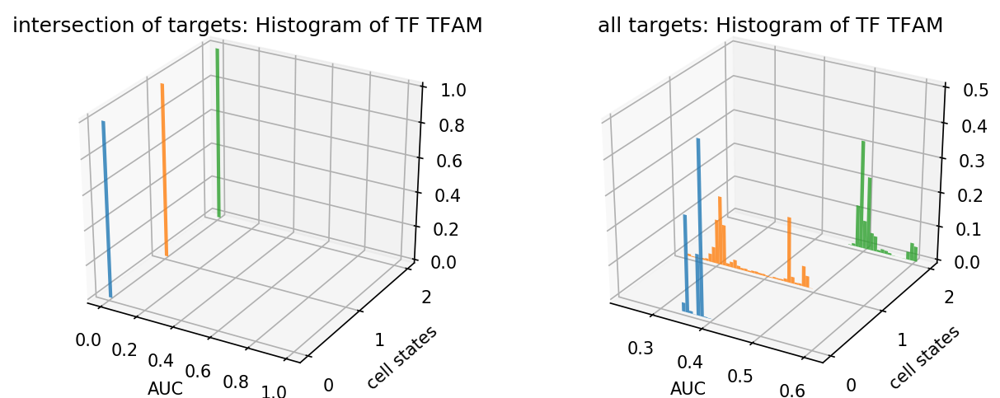

Tcf25


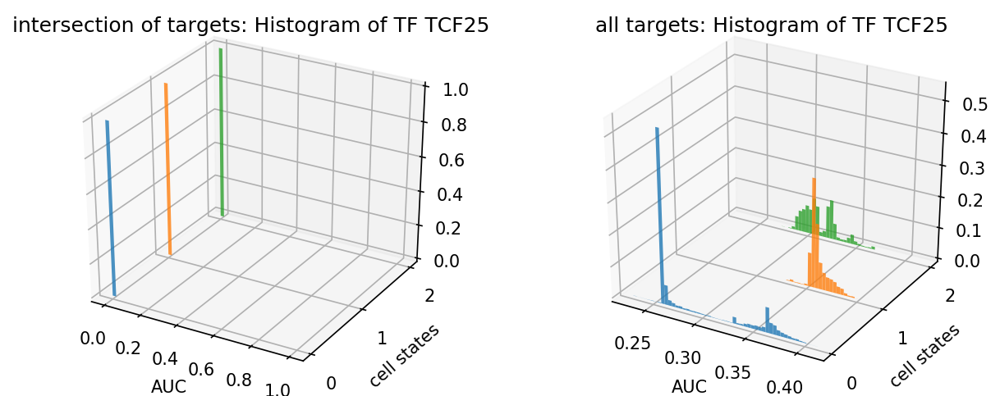

Nfia


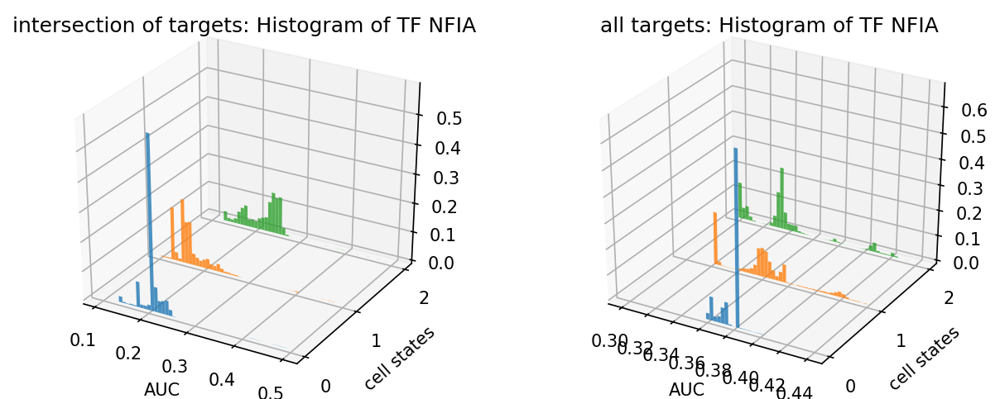

Tsc22d3


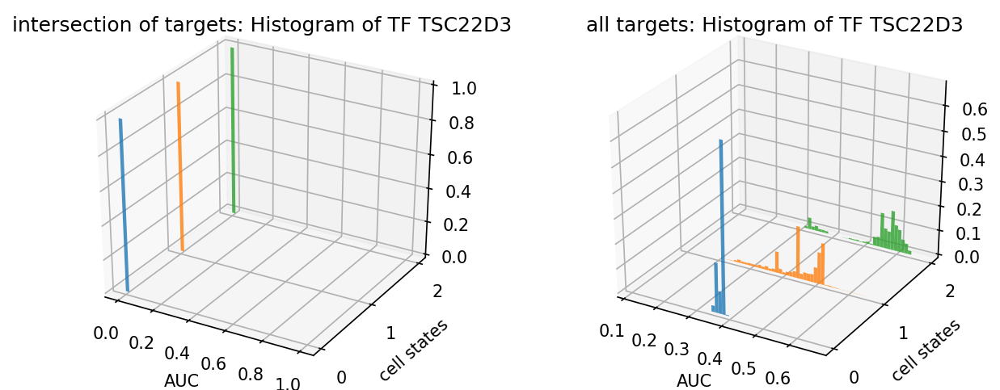

Junb


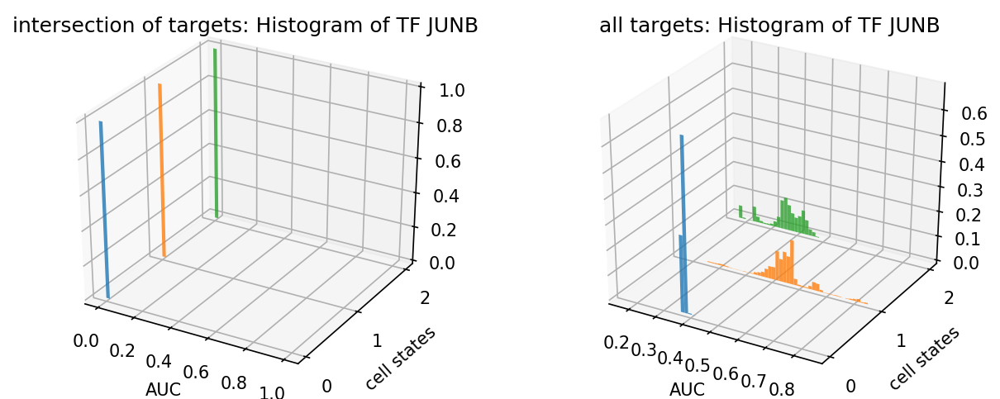

Nono


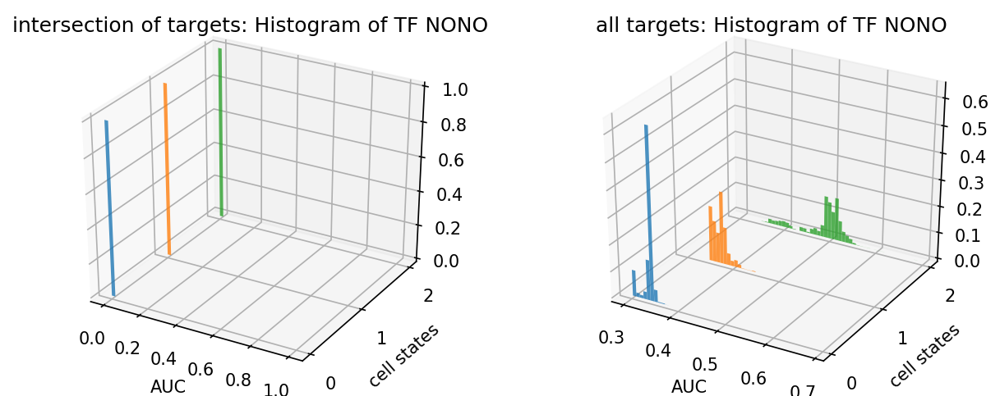

Onecut2


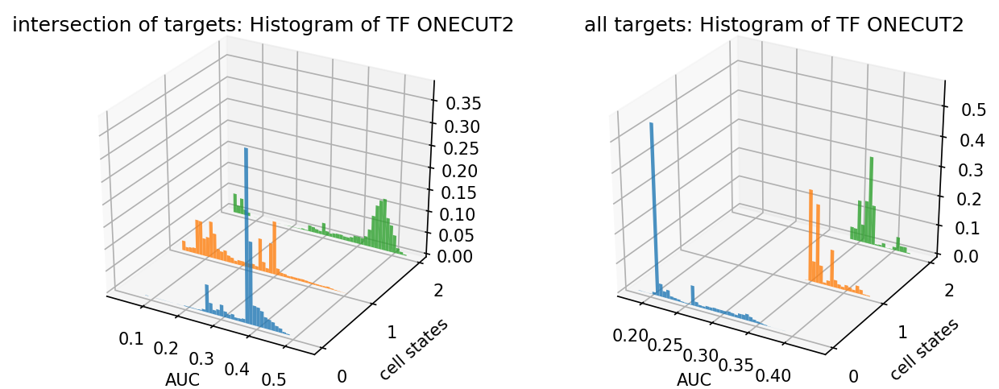

Pbrm1


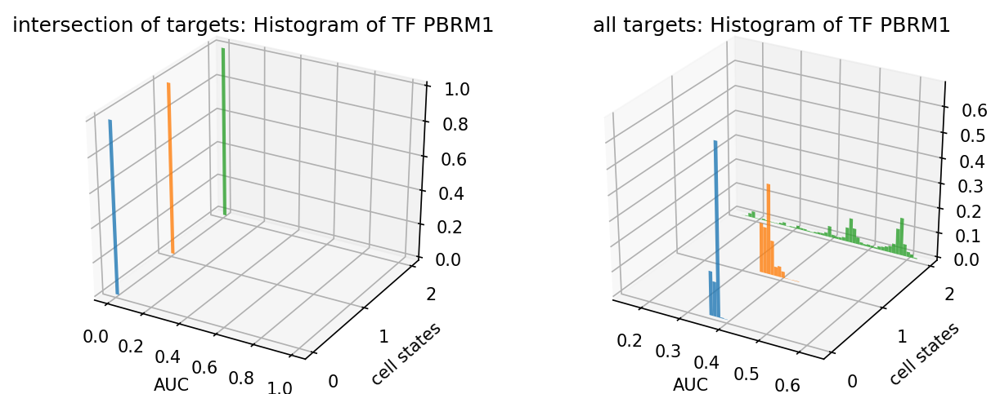

Smarca5


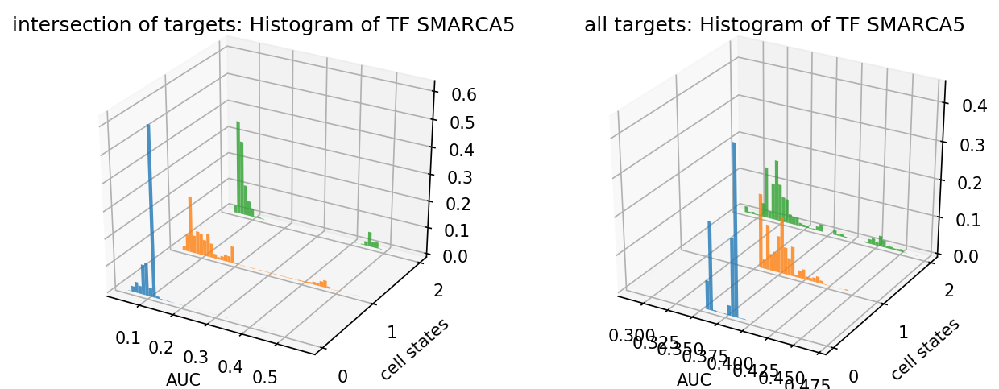

Nr2f6


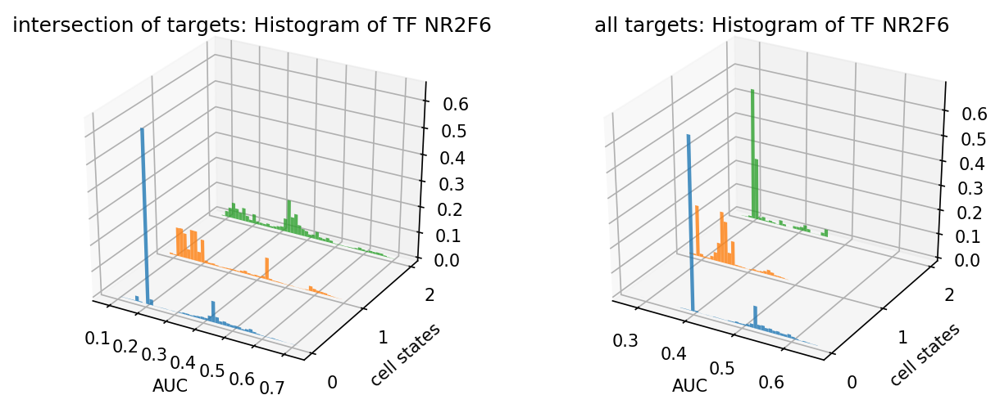

Sfpq


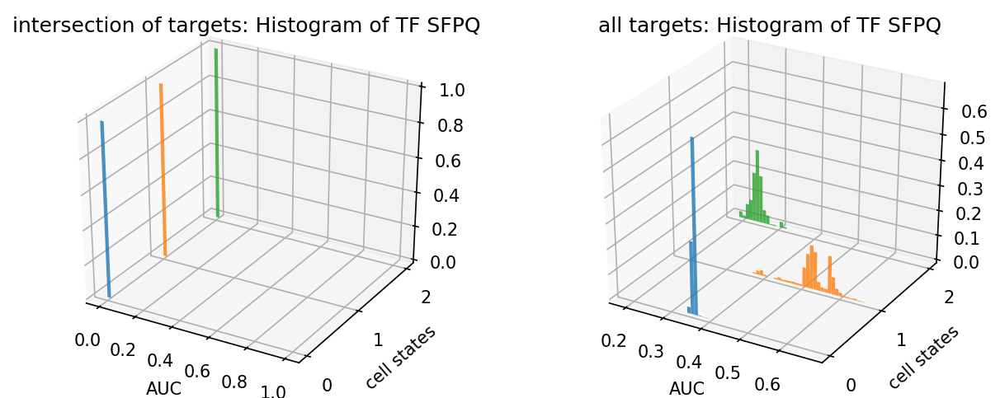

Rora


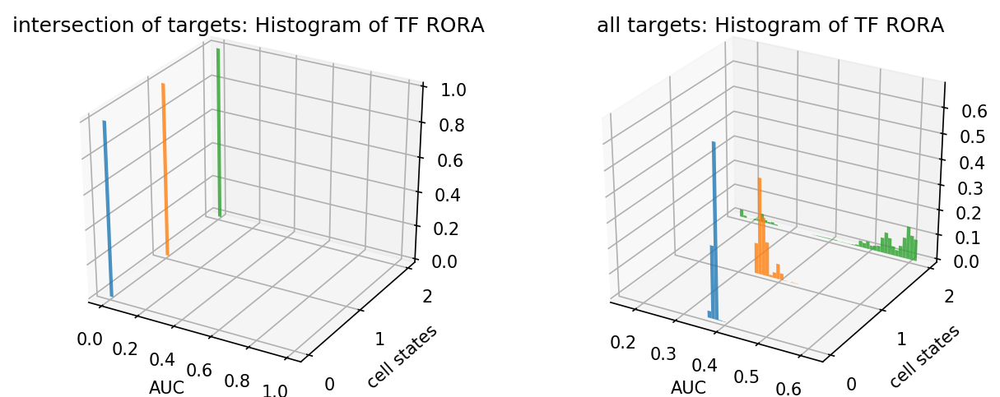

Epas1


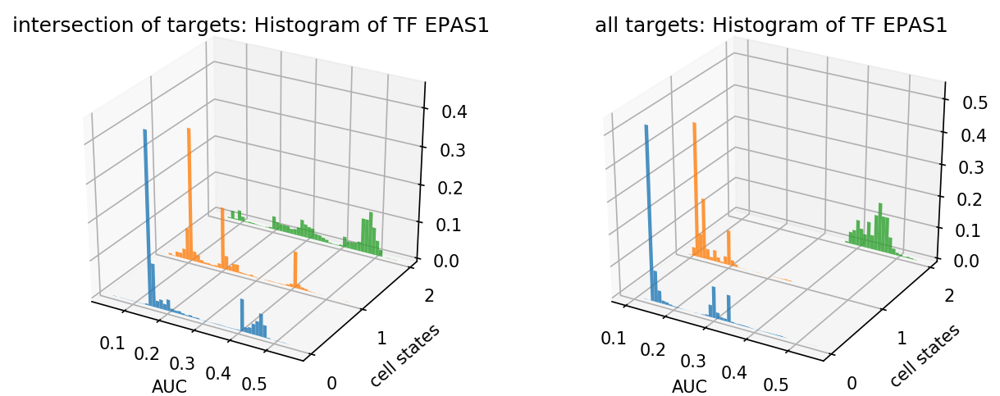

Zfp91


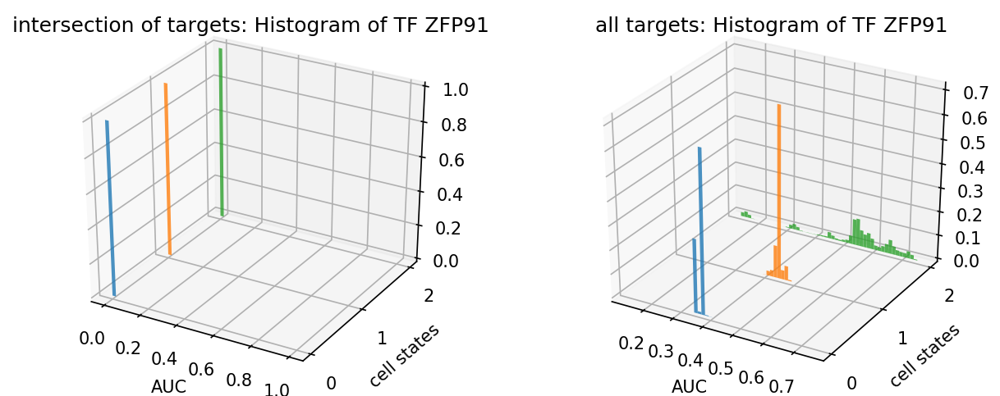

Foxn3


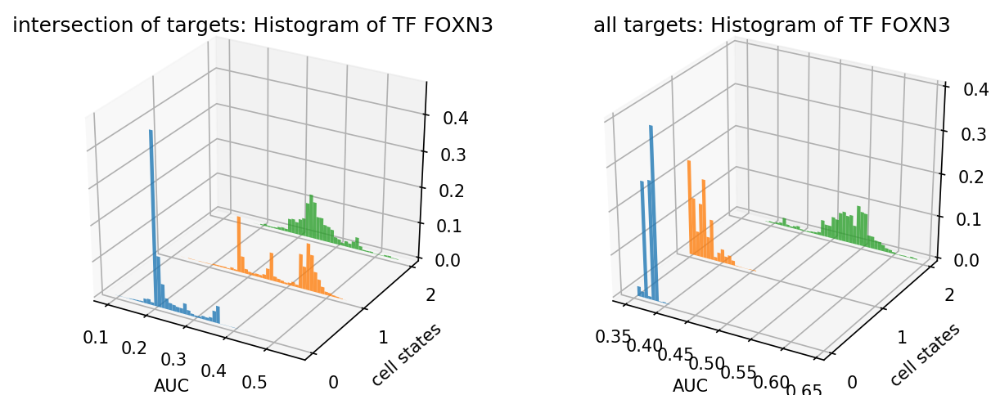

Hes6


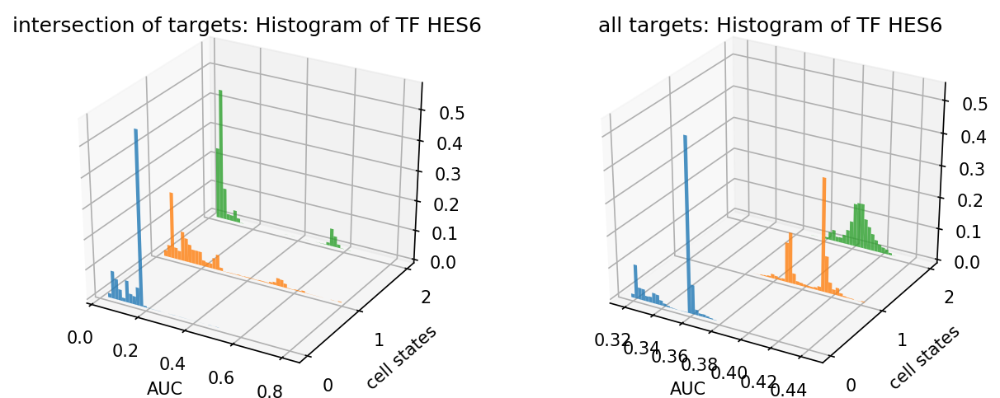

Stat1


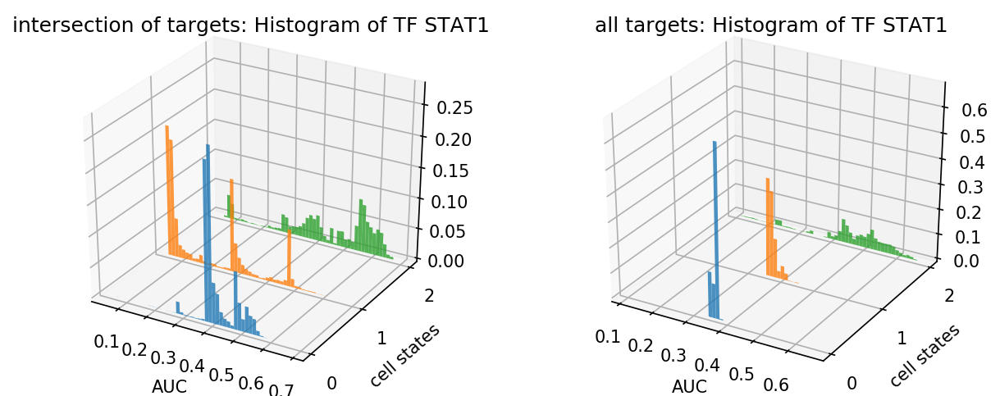

Mier1


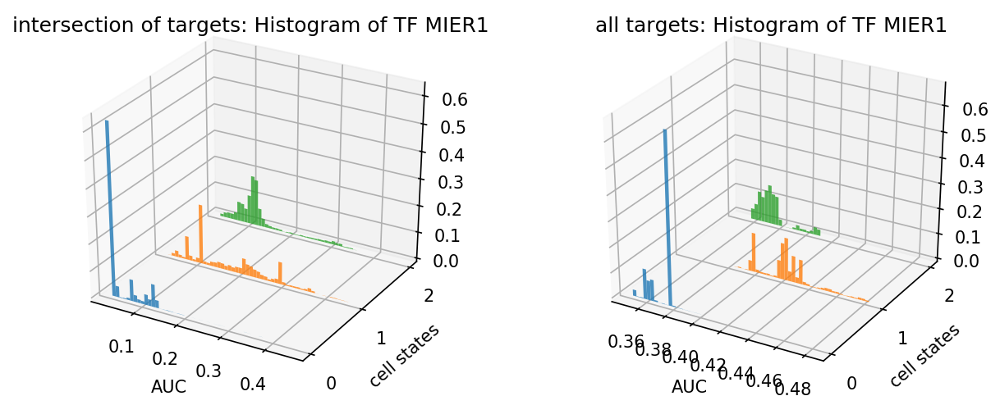

Smarce1


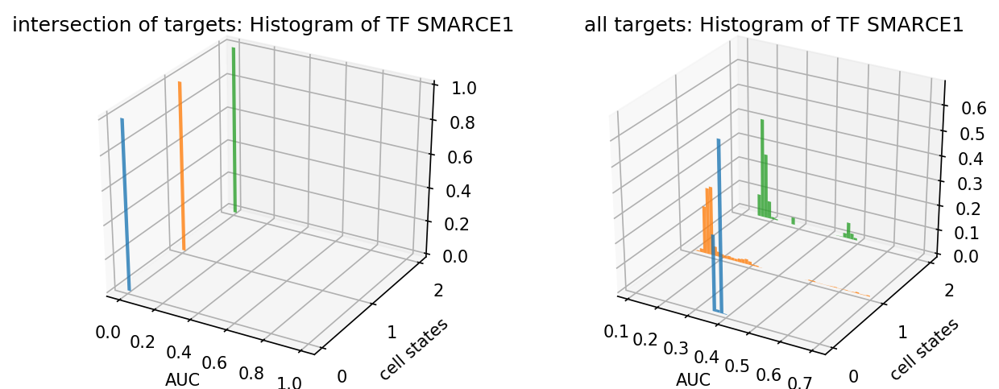

Rxra


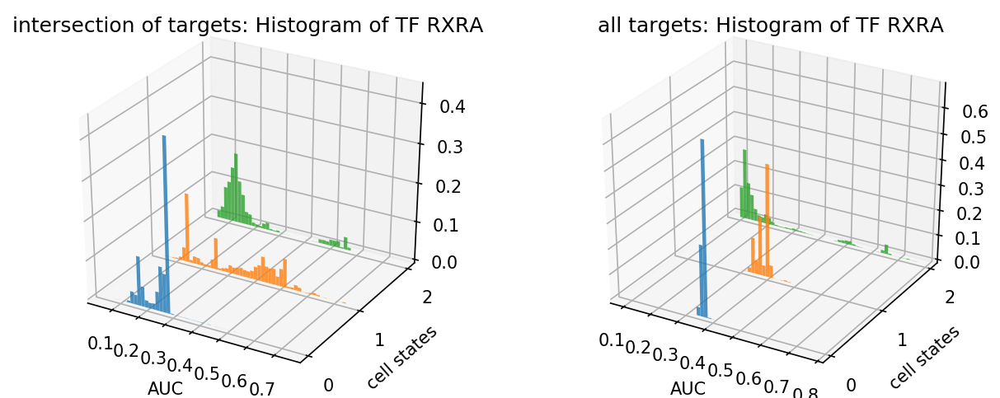

Klf13


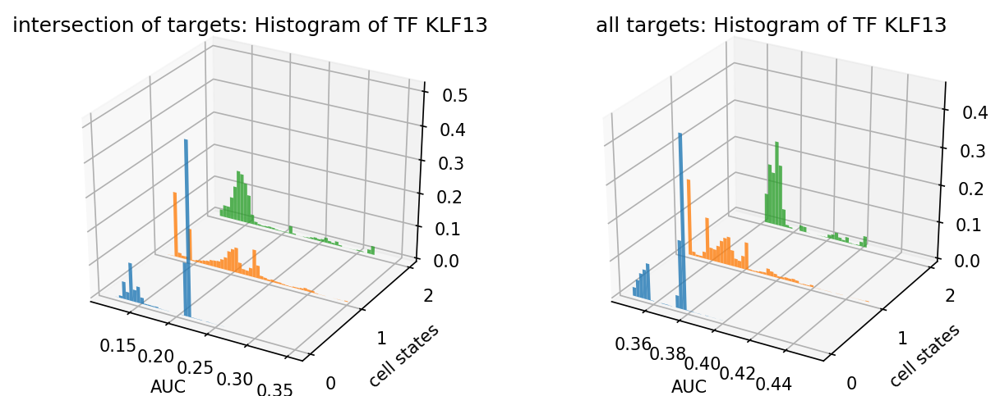

Nr1i3


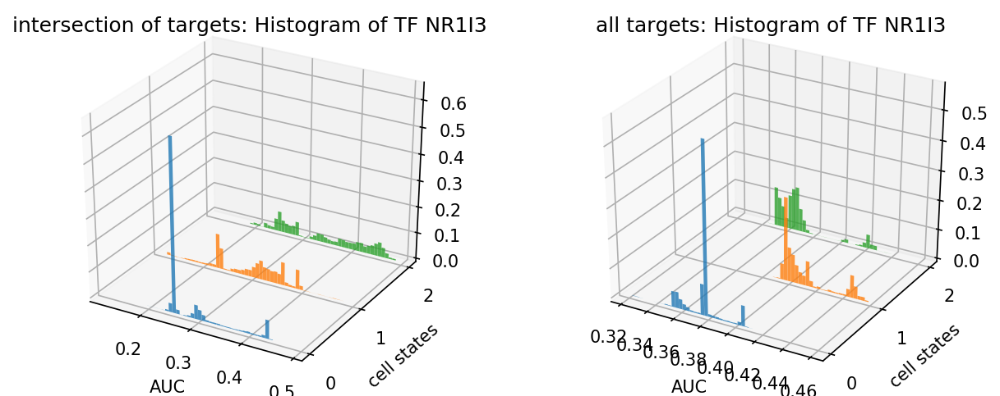

Nfic


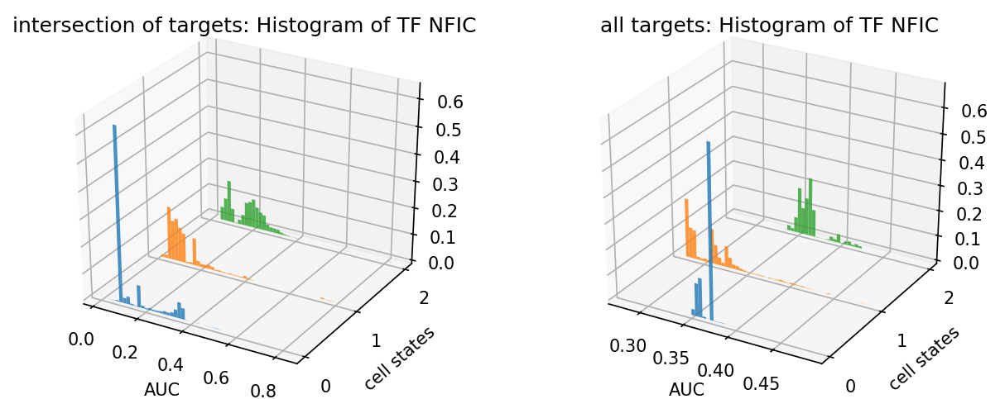

Nr0b2


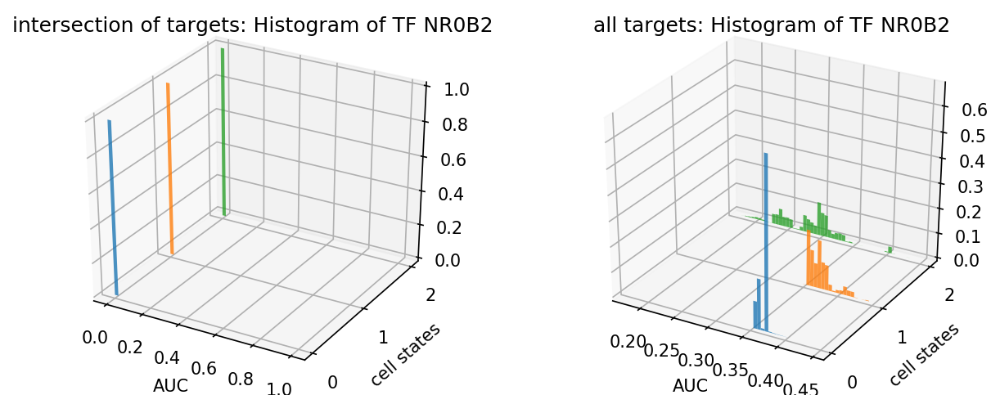

Nfib


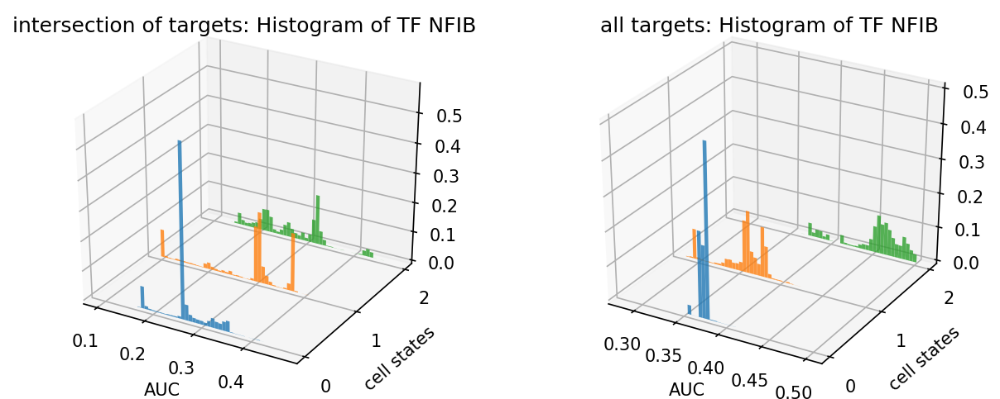

Foxp1


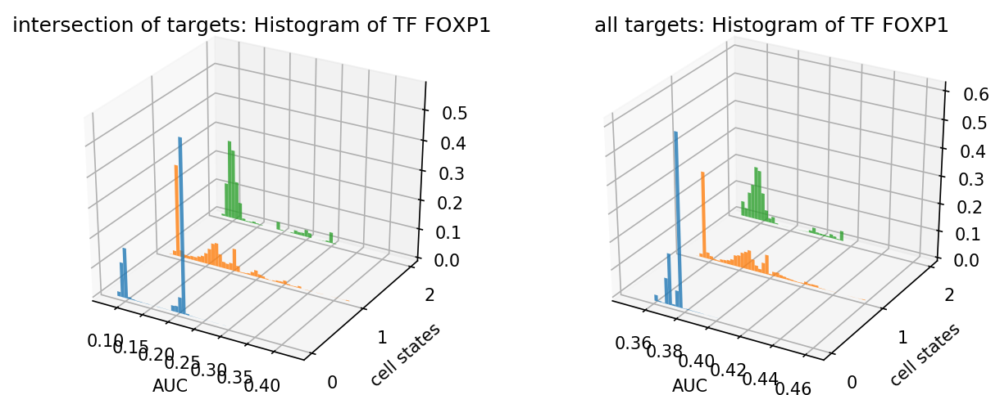

Nr3c1


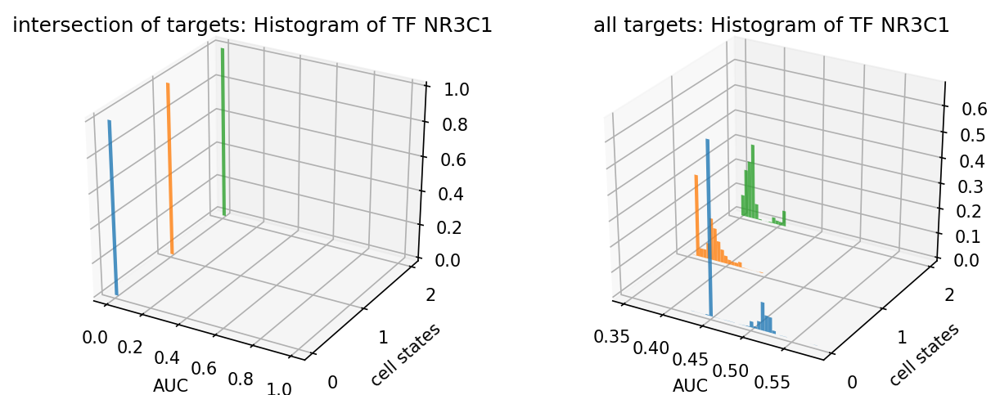

Peg3


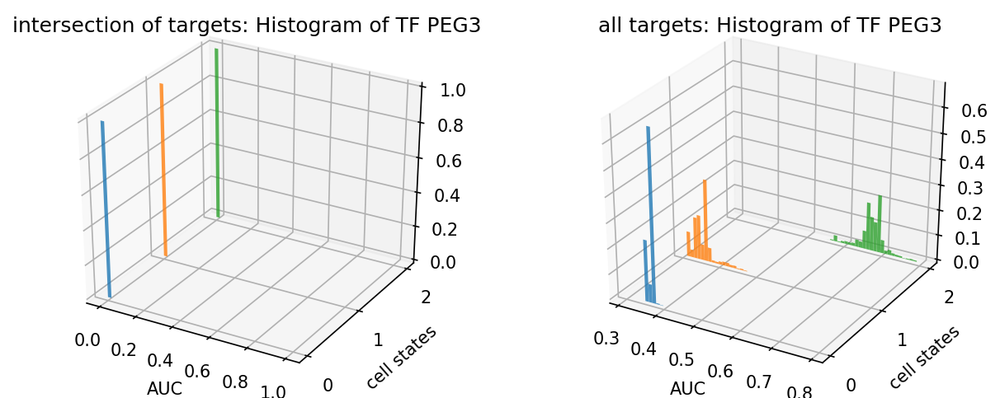

Bhlhe40


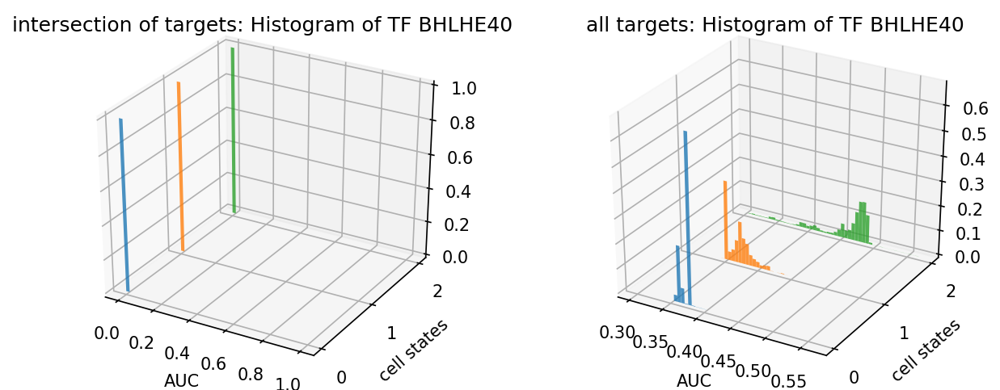

Ahr


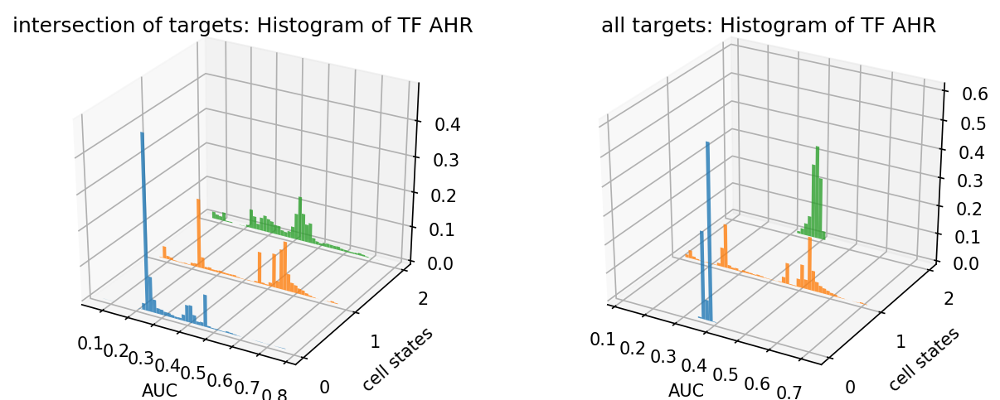

In [13]:
plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, top_only_no_simic)

--------
# TFs that are only rank last variant in intersection

Bcl3


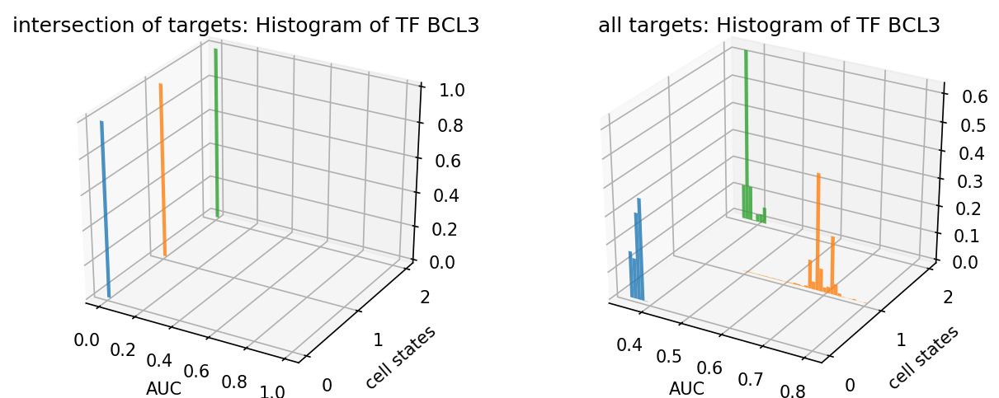

Tfam


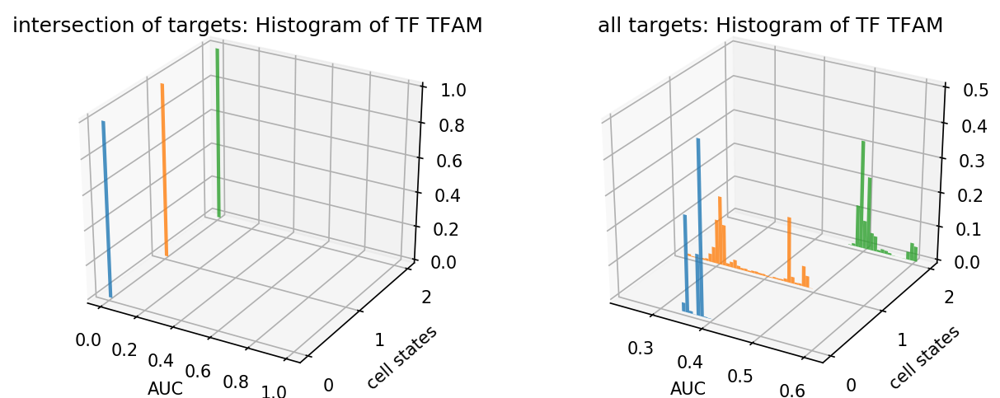

Tsc22d3


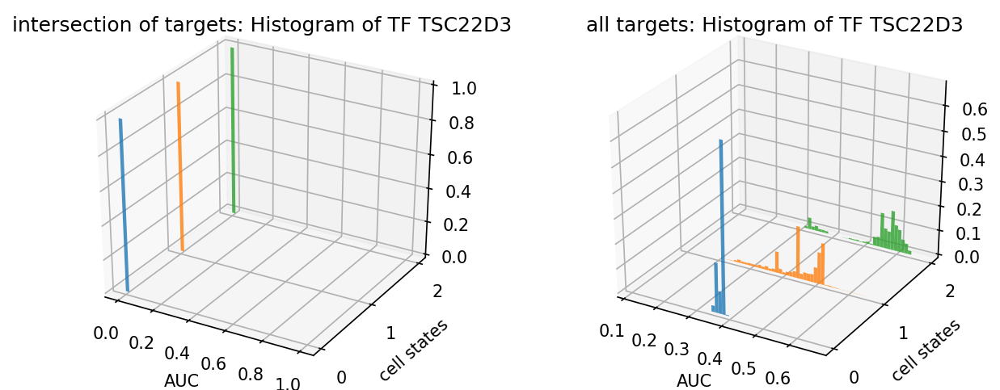

Nfix


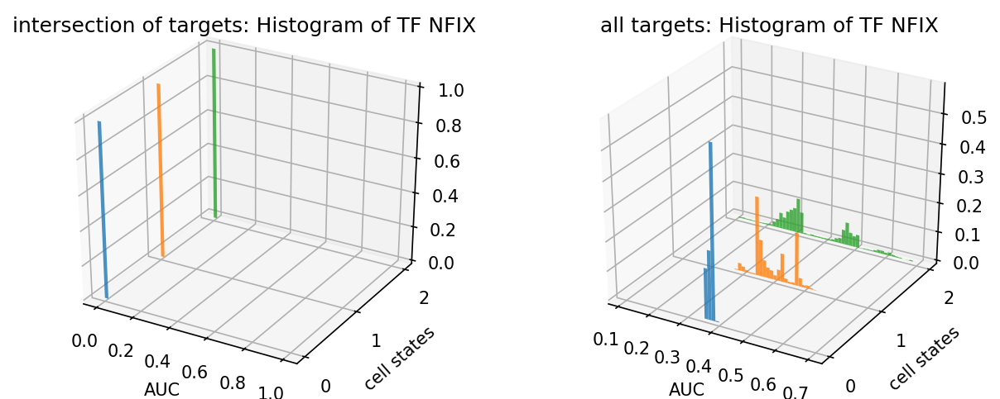

Nono


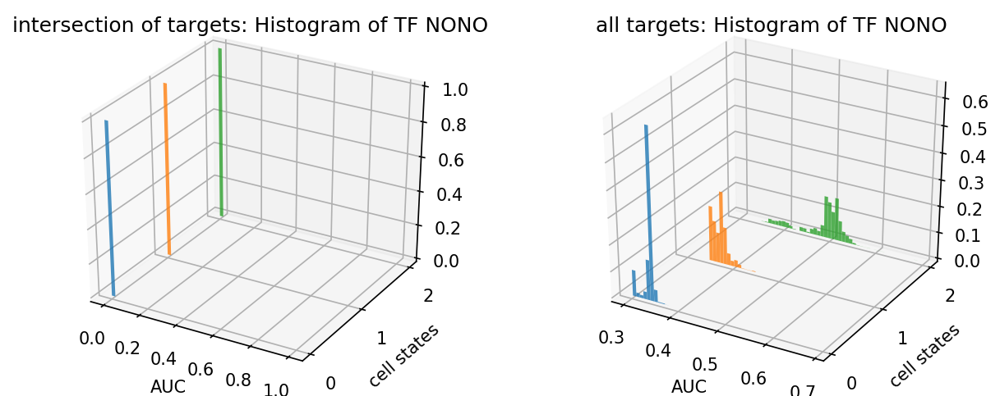

Junb


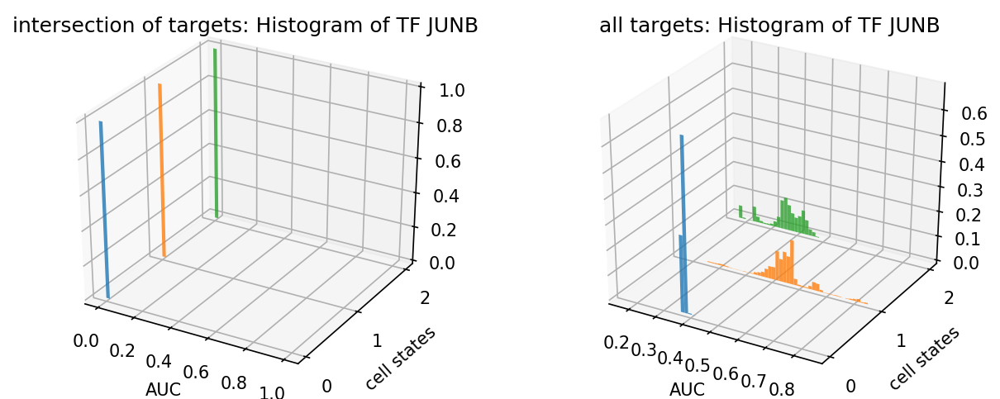

Pbrm1


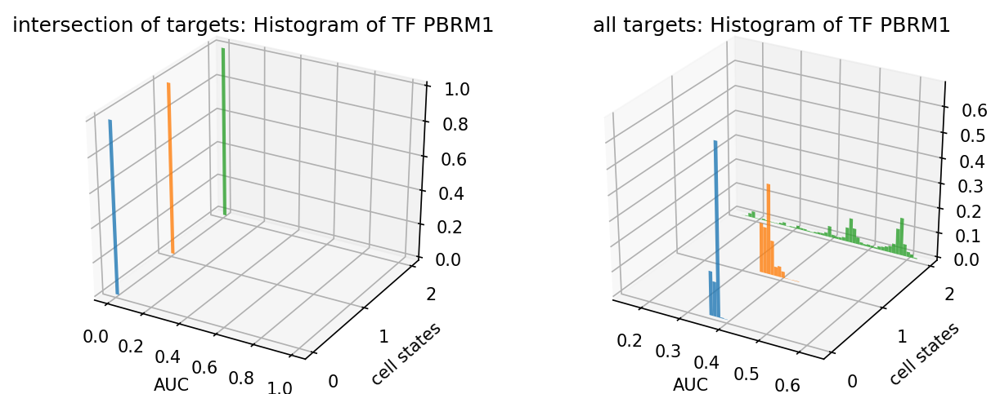

Ncoa2


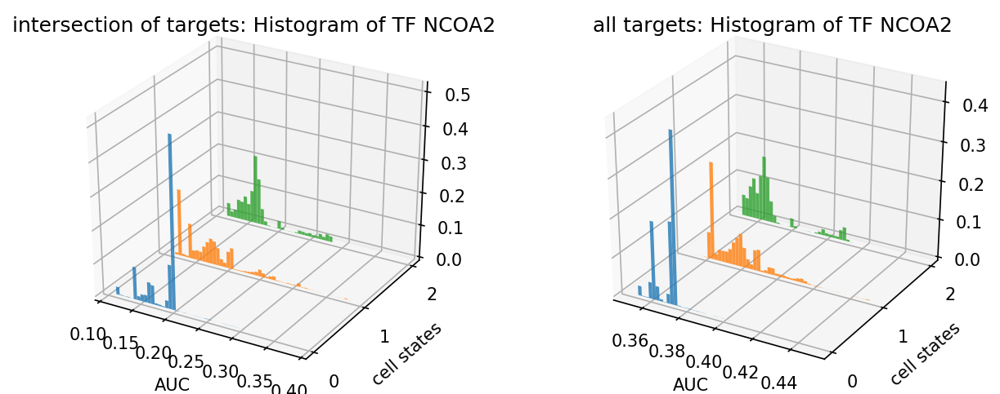

Sfpq


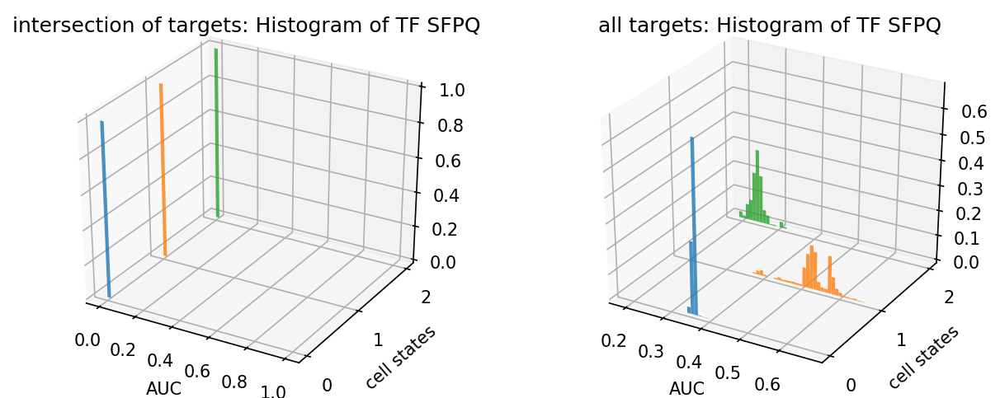

Mlxipl


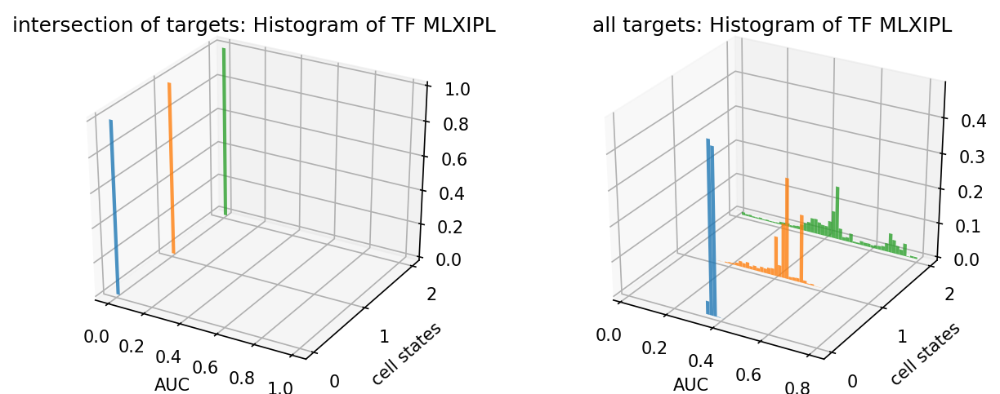

Rora


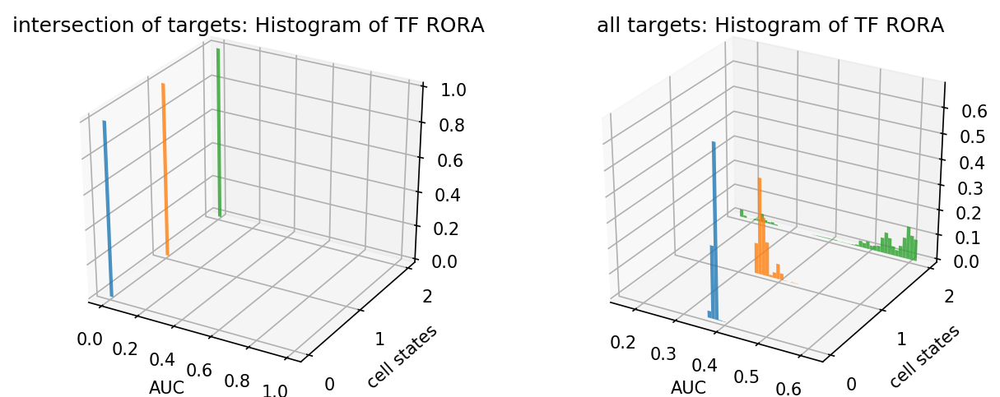

Mef2a


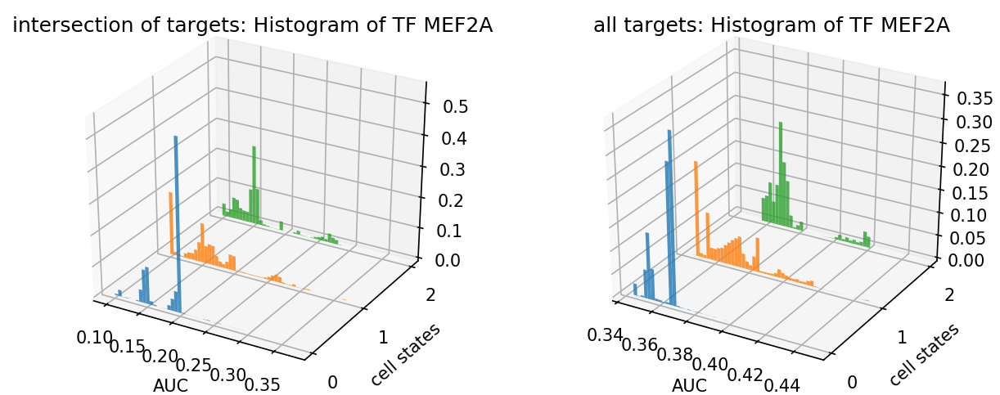

Gtf3a


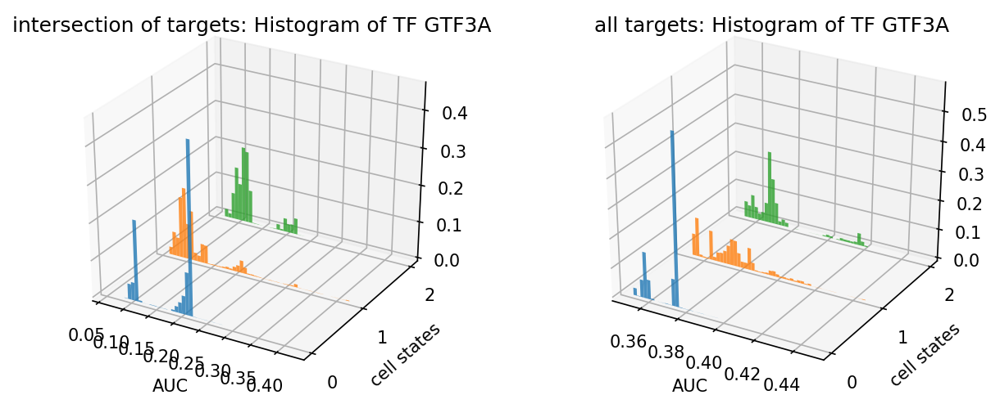

Zbtb38


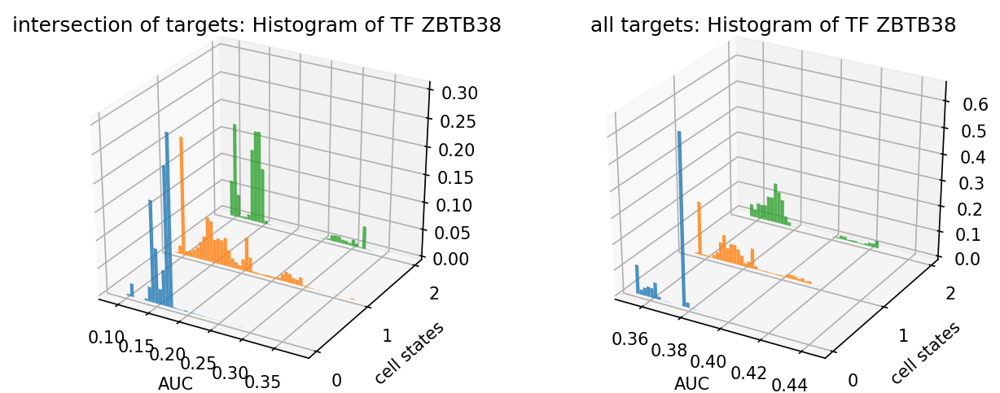

Dnmt1


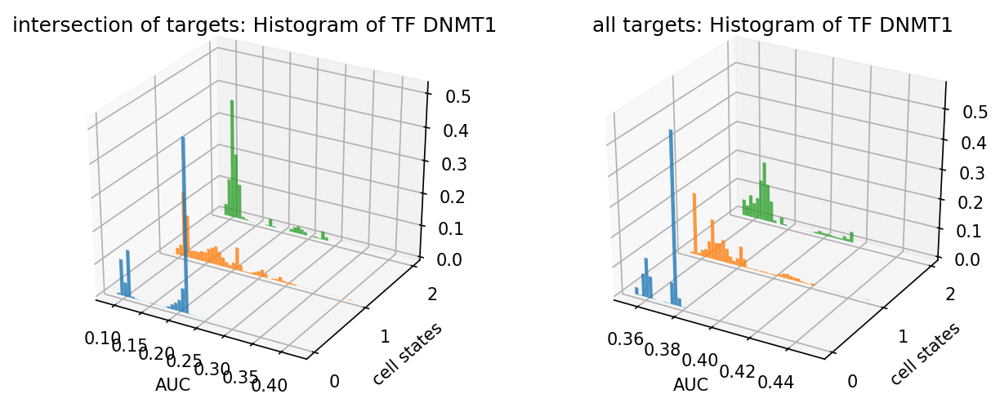

Zfp91


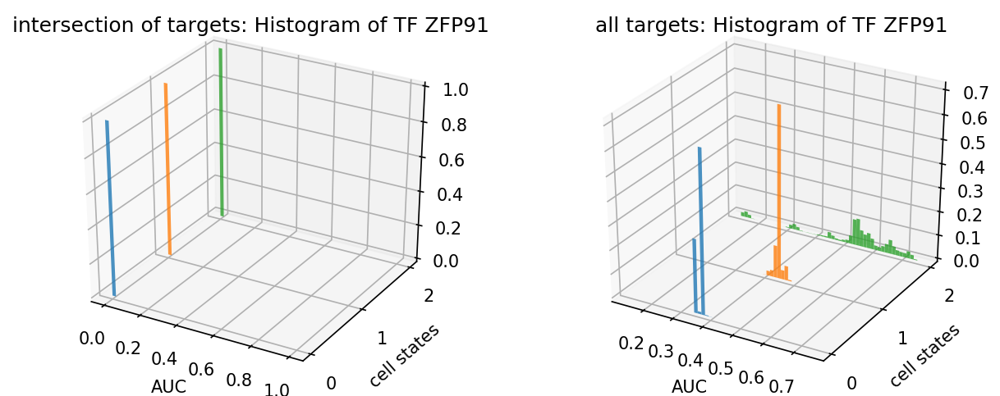

Lrrfip1


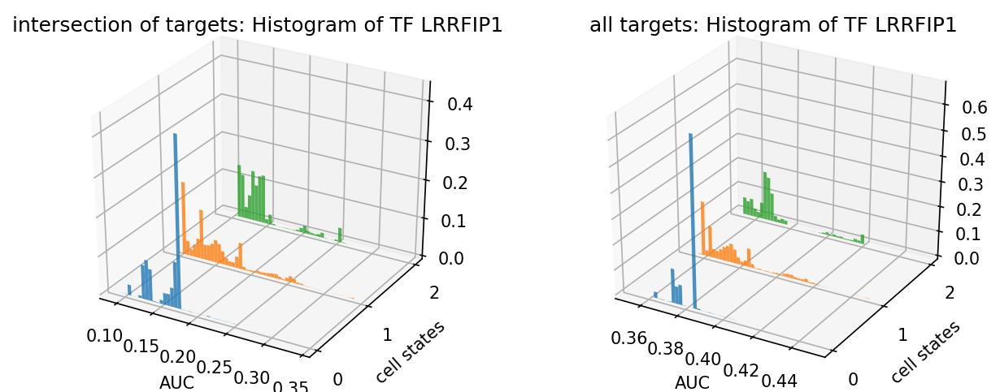

Nr1h3


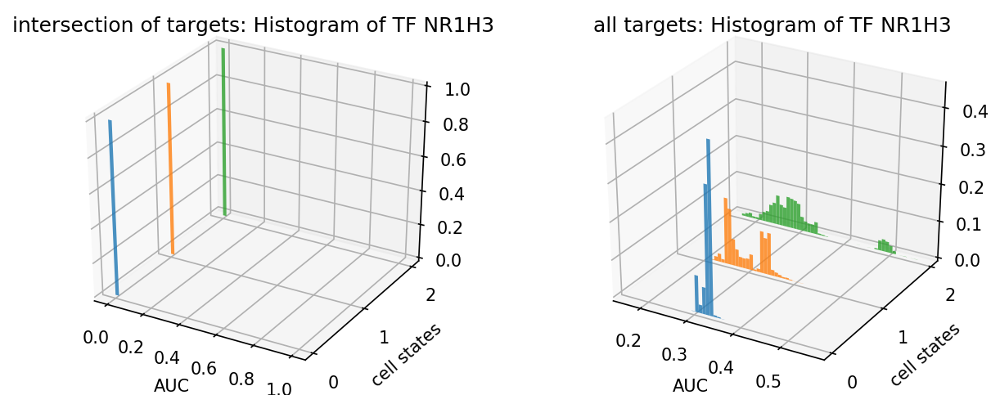

Rreb1


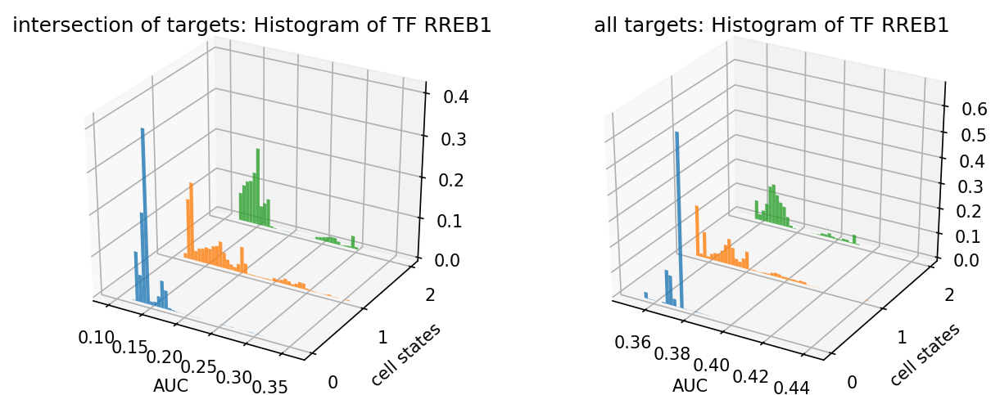

Klf9


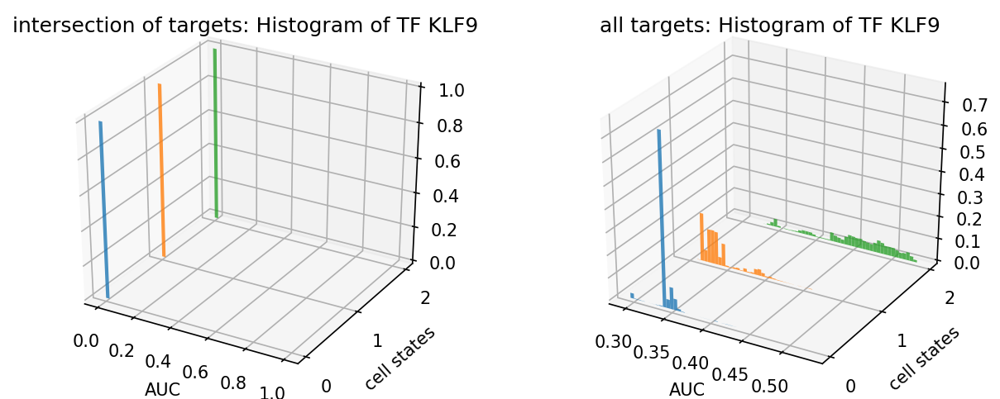

Nr5a2


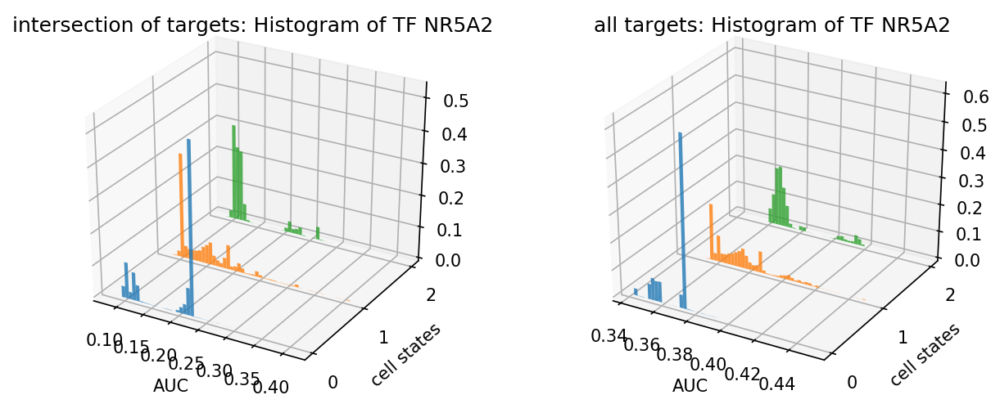

Smarce1


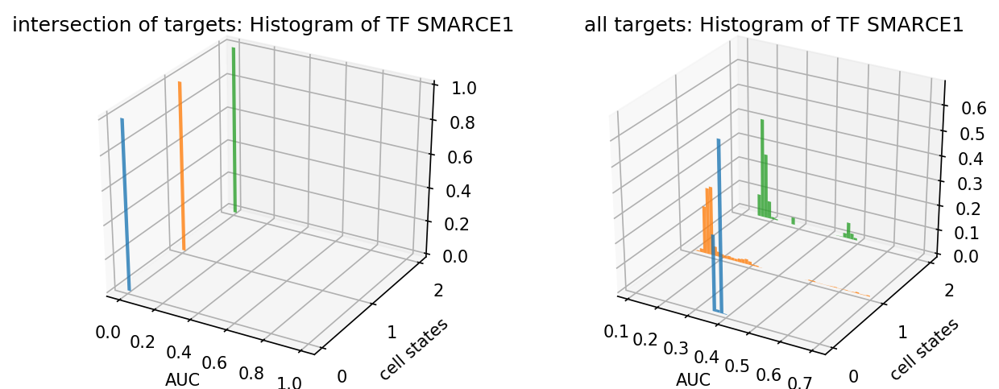

Nfic


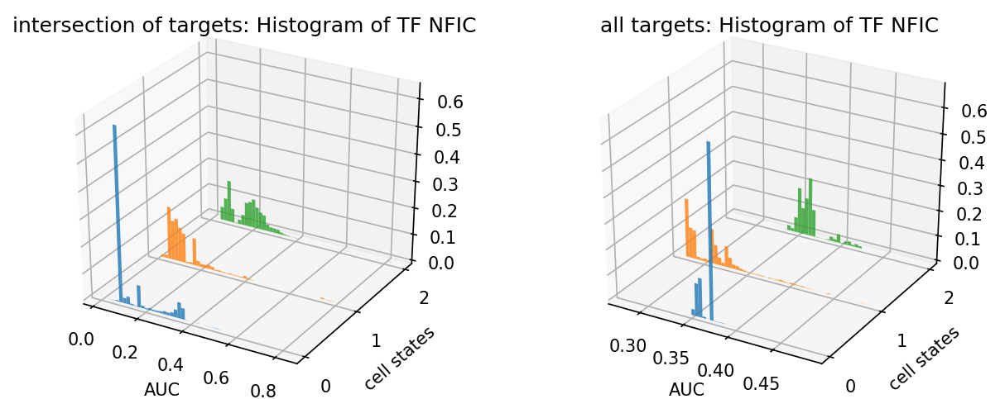

Nr0b2


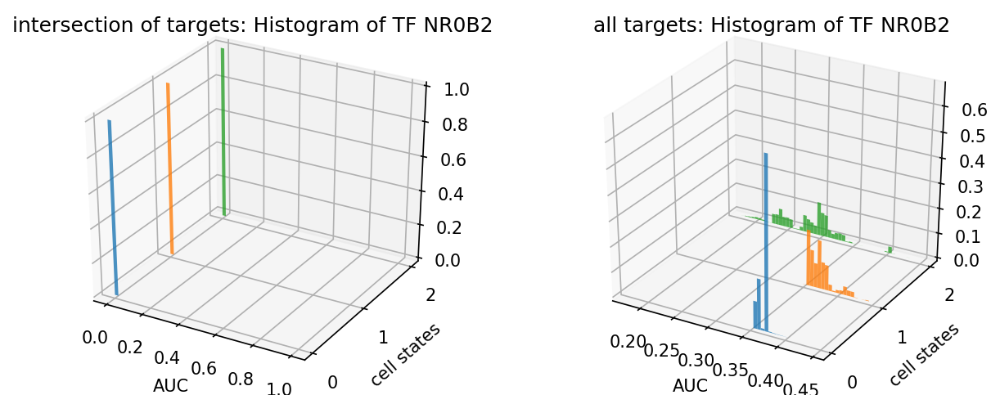

Phf5a


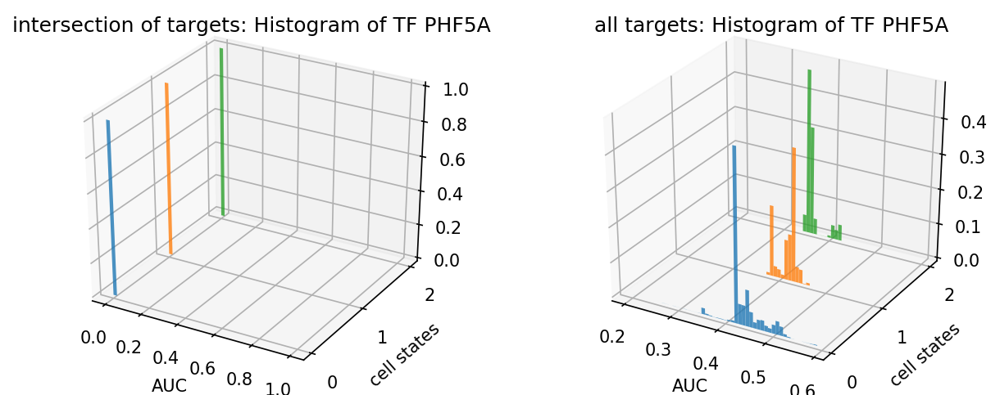

Nr3c1


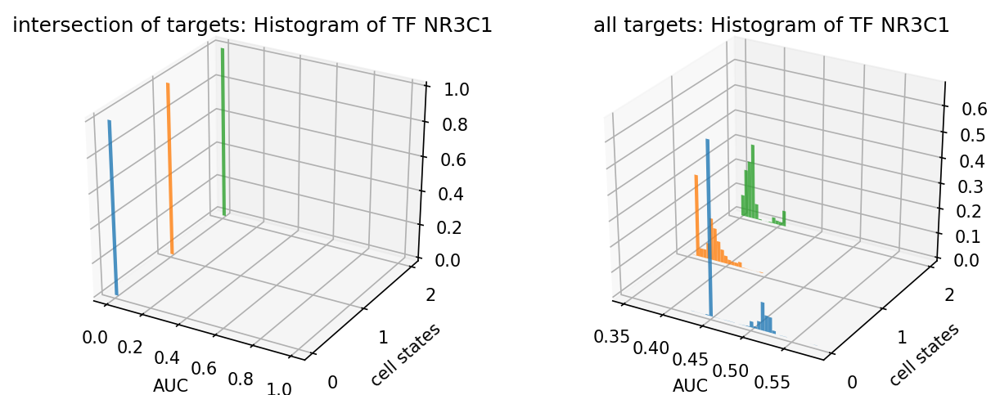

Peg3


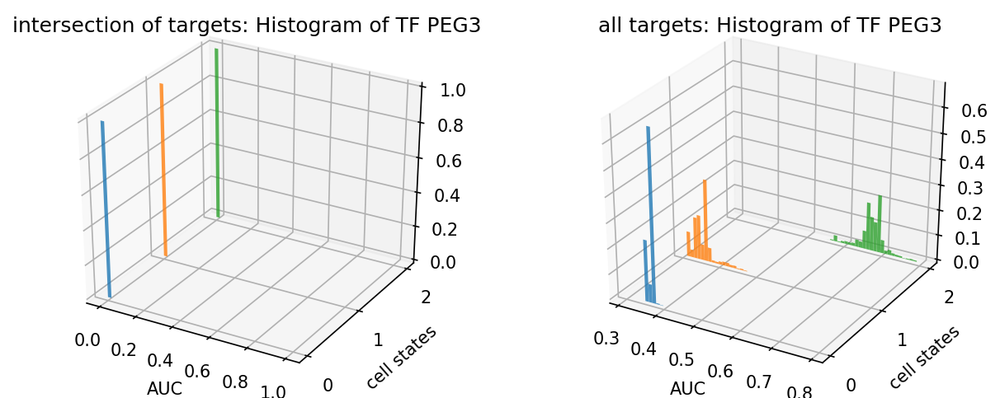

Bhlhe40


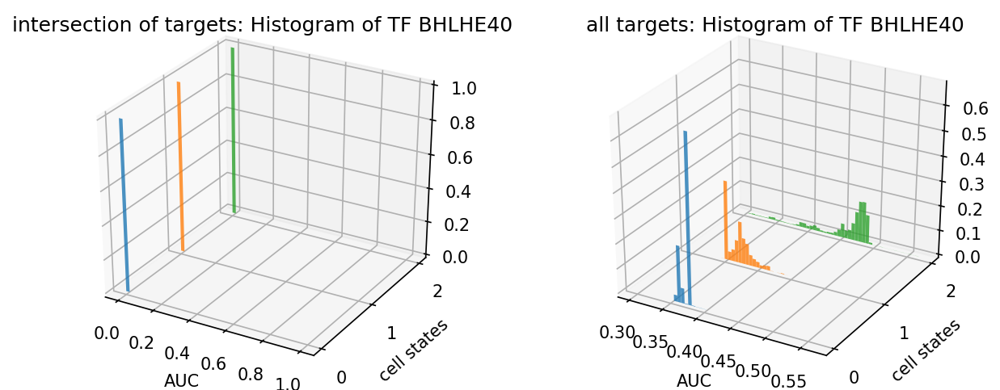

Tcf25


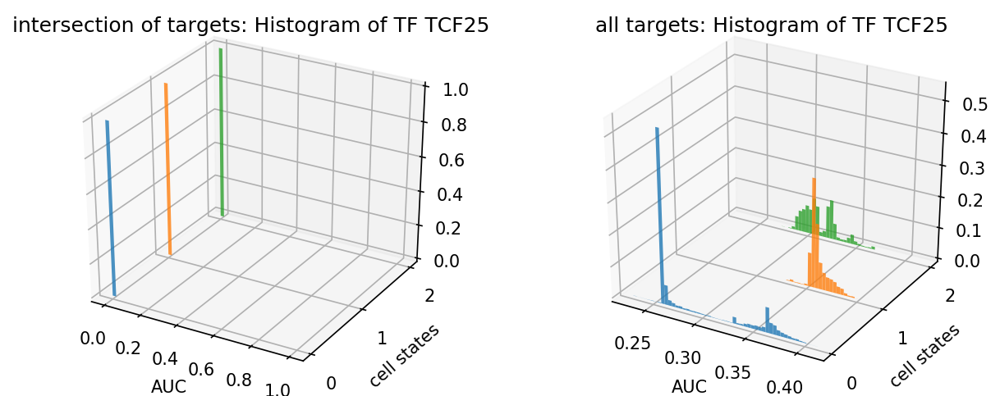

In [14]:
plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, last_only_simic)

--------
# TFs that are only rank last variant in all targets

Sox5


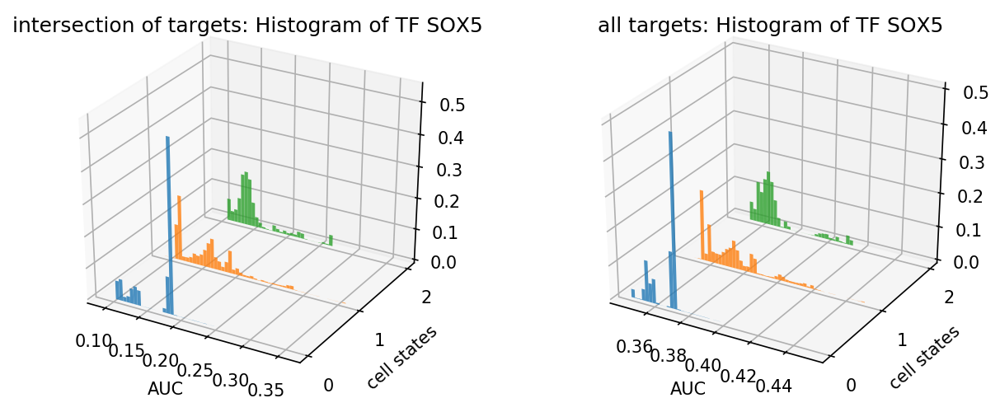

Zbtb7b


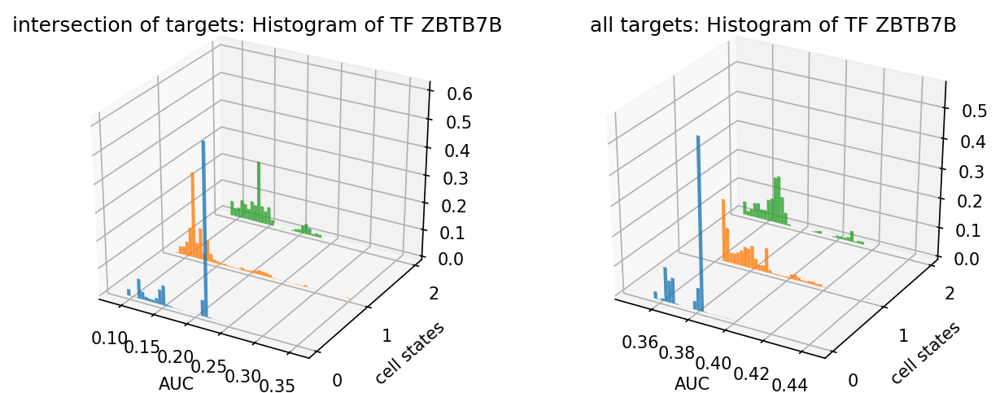

Elk4


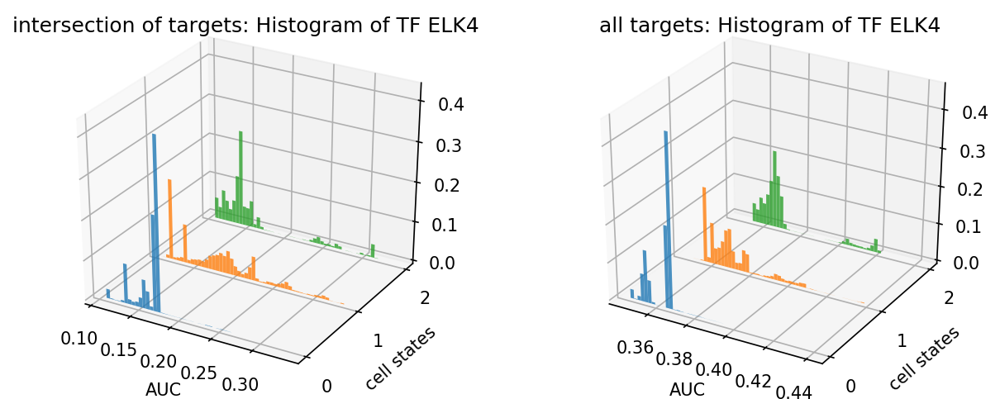

Stat5b


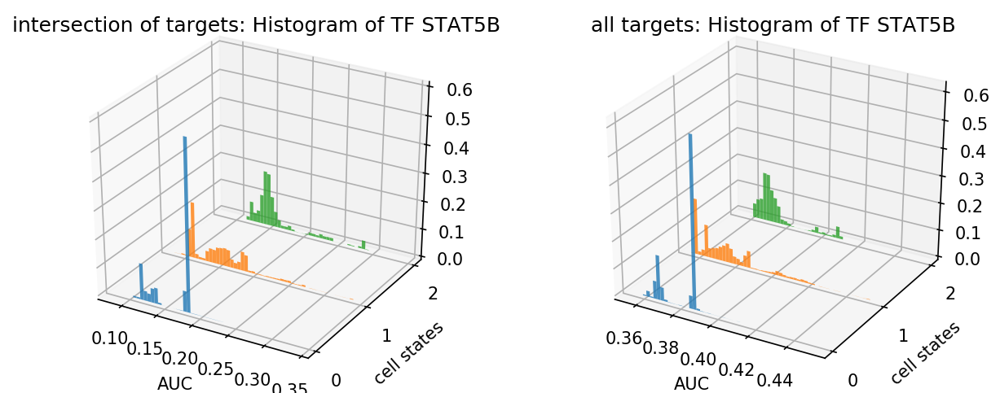

Onecut1


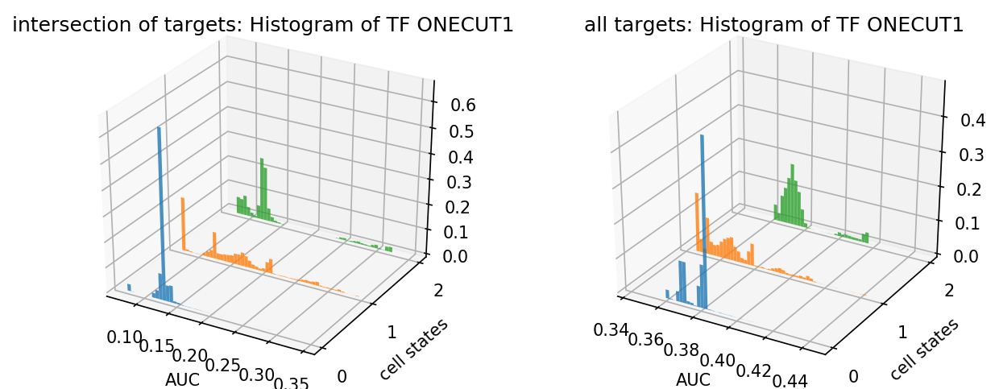

Kdm2a


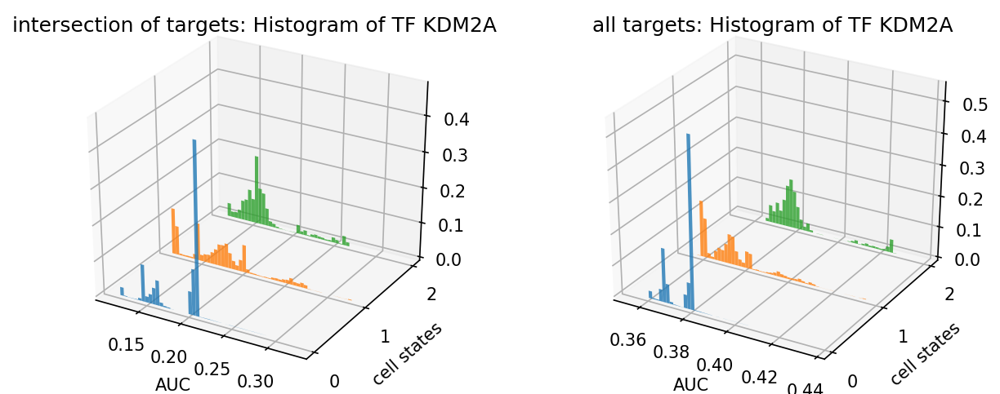

Sox9


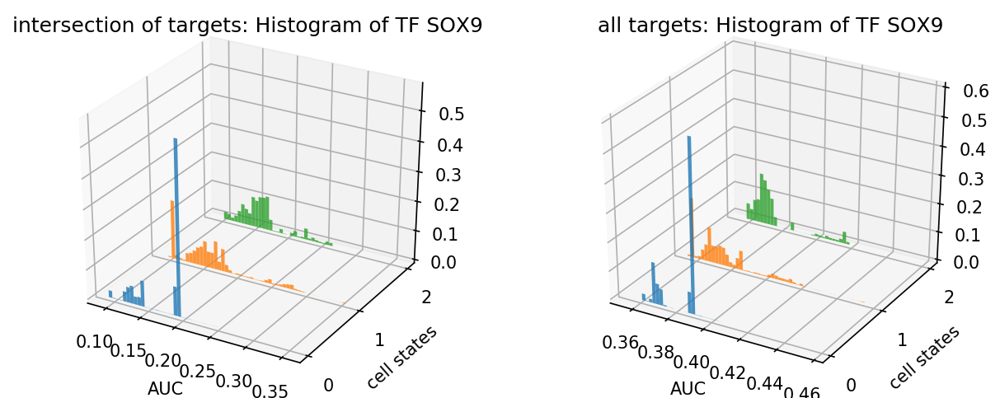

Sall1


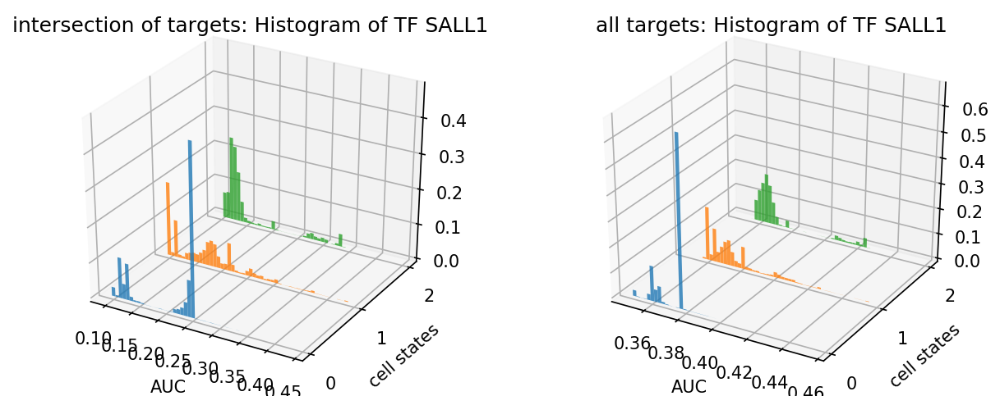

Rlf


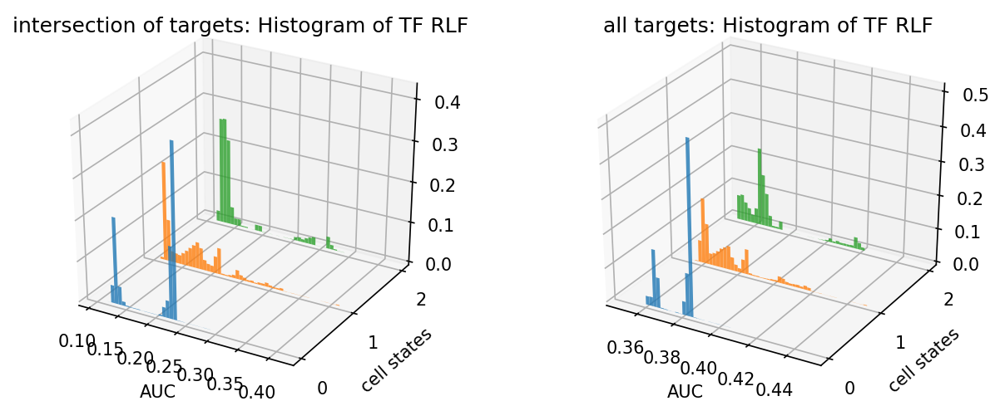

Atf6


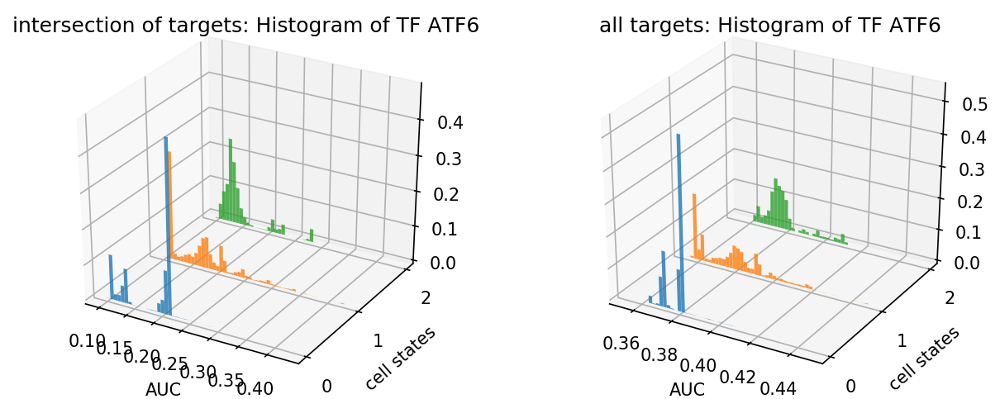

Tox4


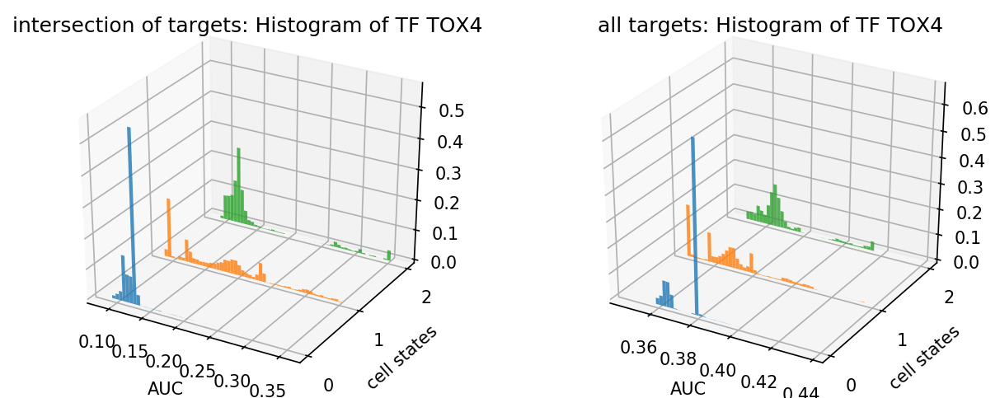

Irf6


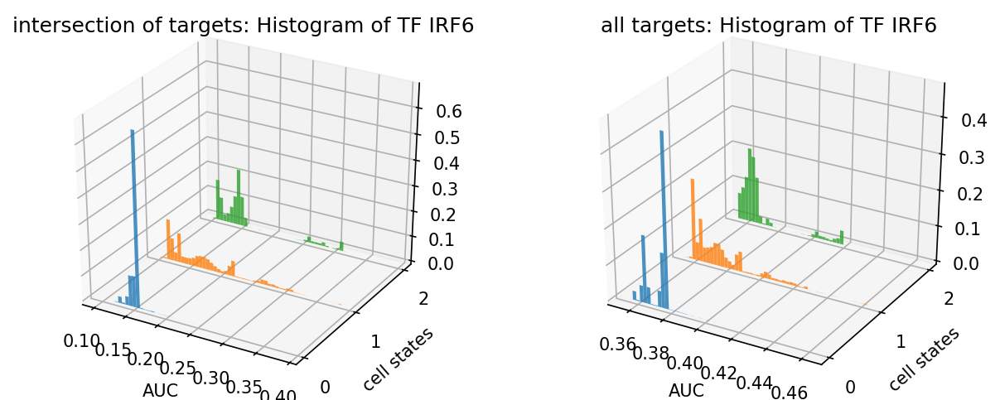

Tshz1


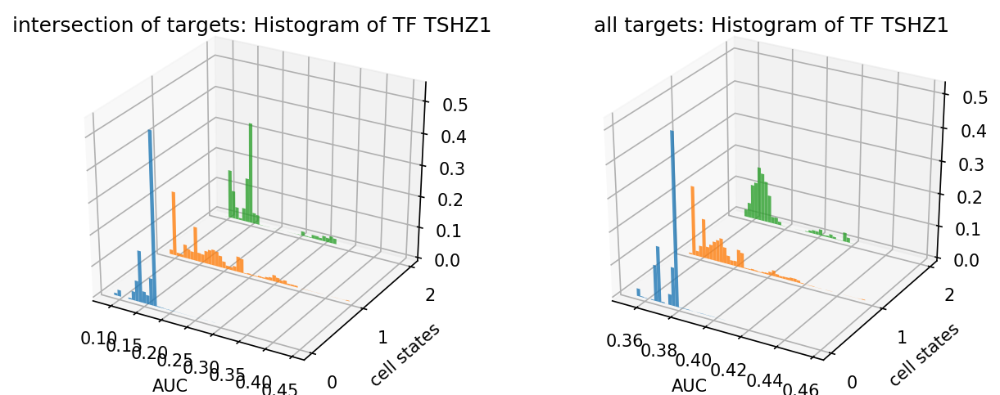

Nfe2l1


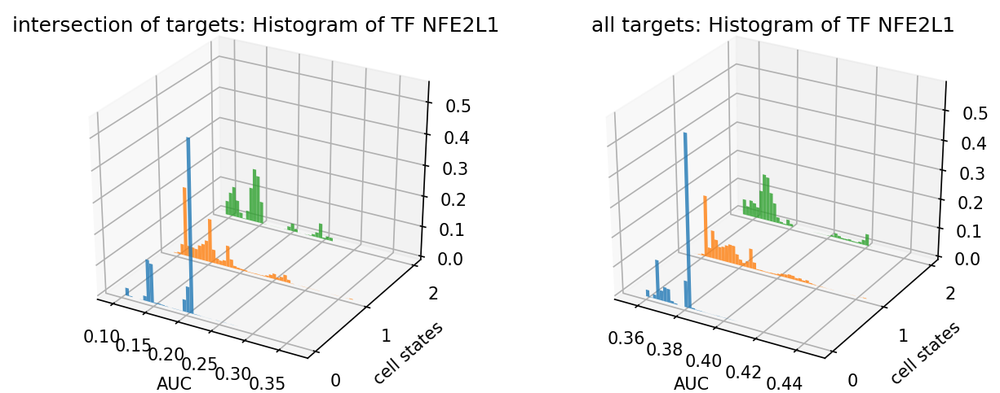

Tfdp1


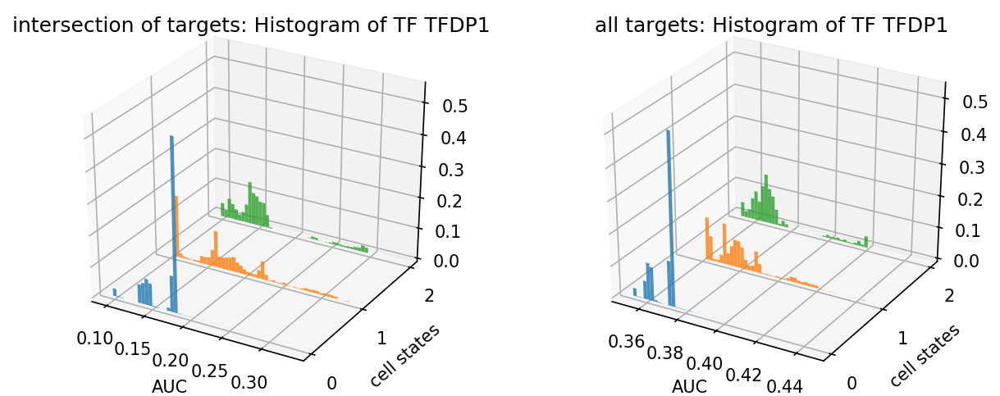

Nfkbia


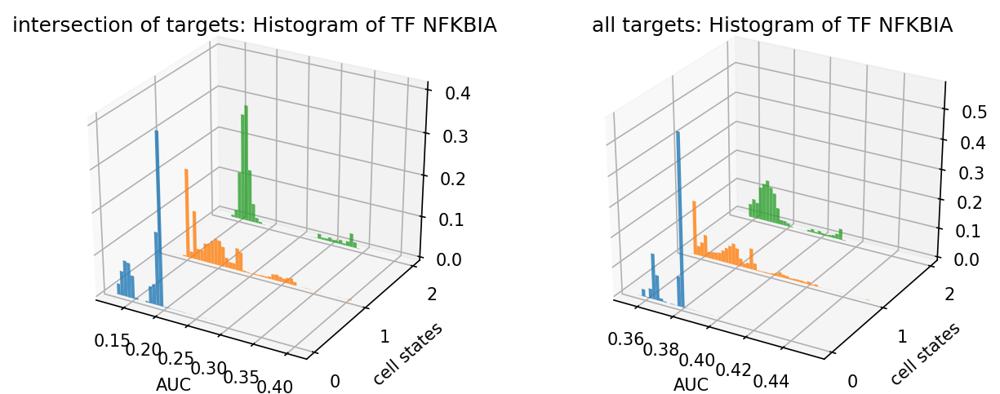

Klf12


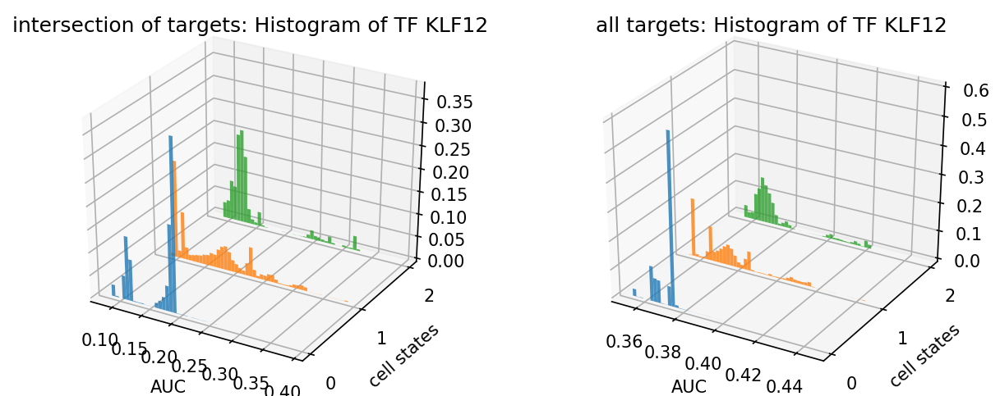

Cux1


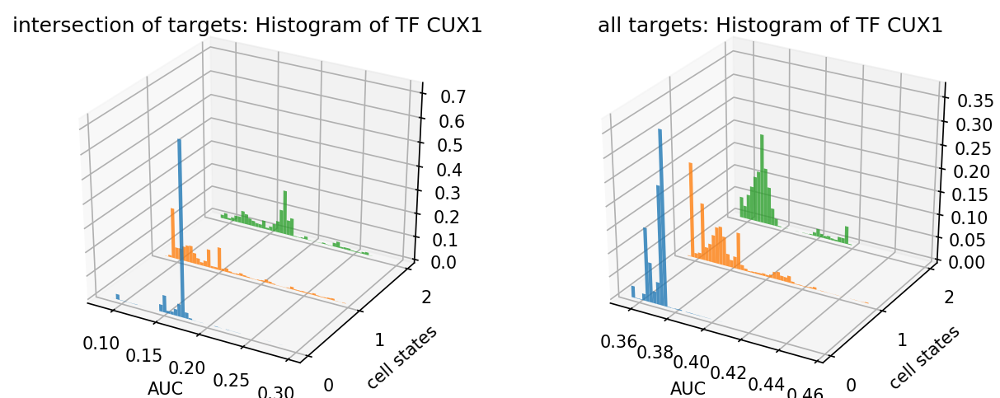

Nr2f2


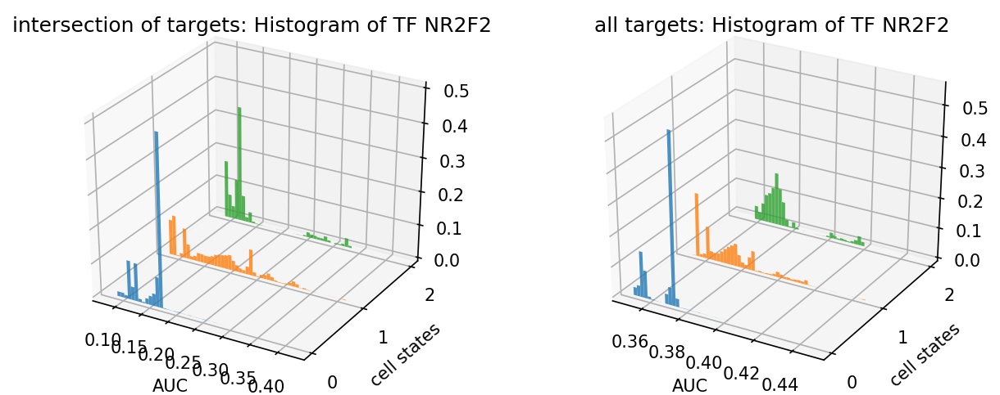

Gzf1


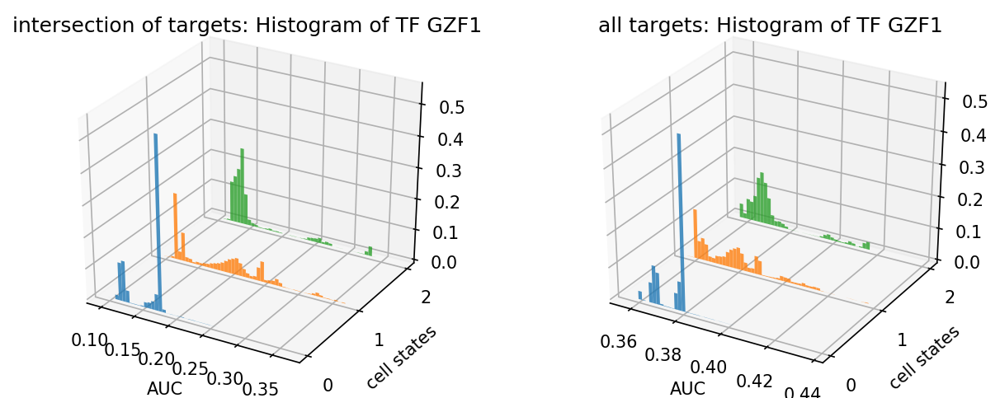

Atf1


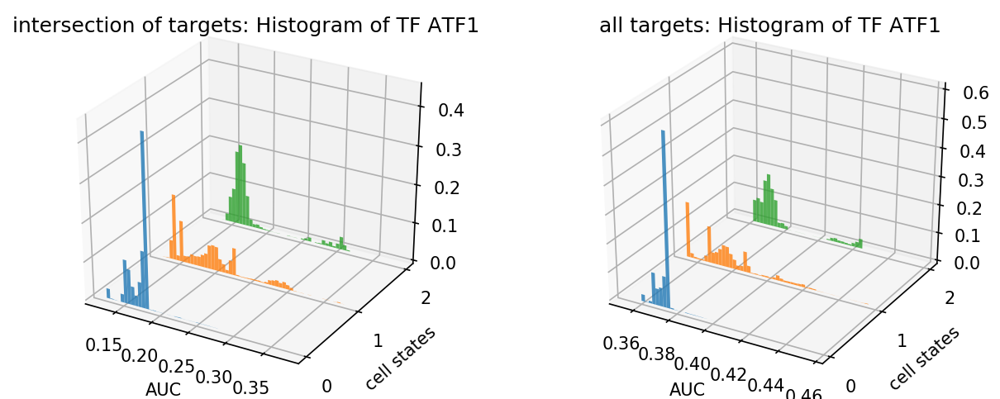

Zhx1


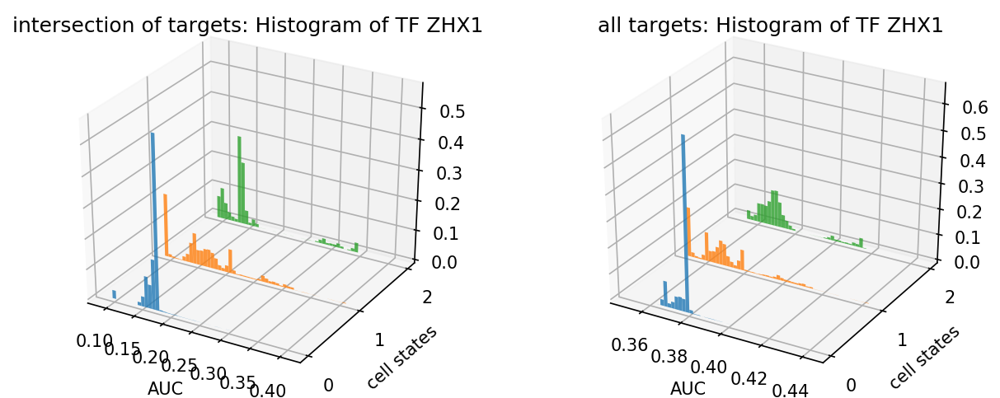

Tef


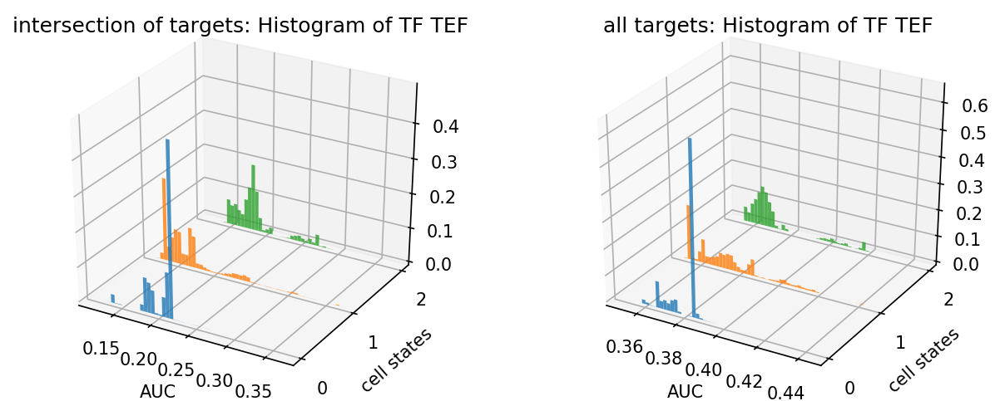

Sp3


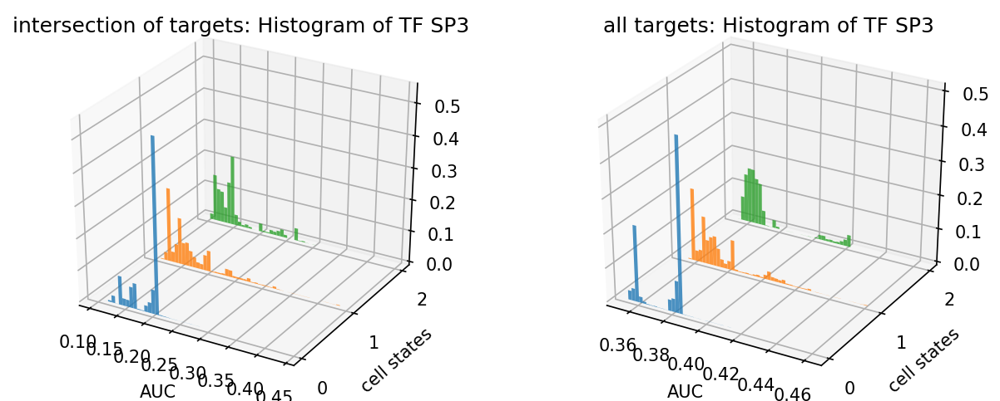

Foxo3


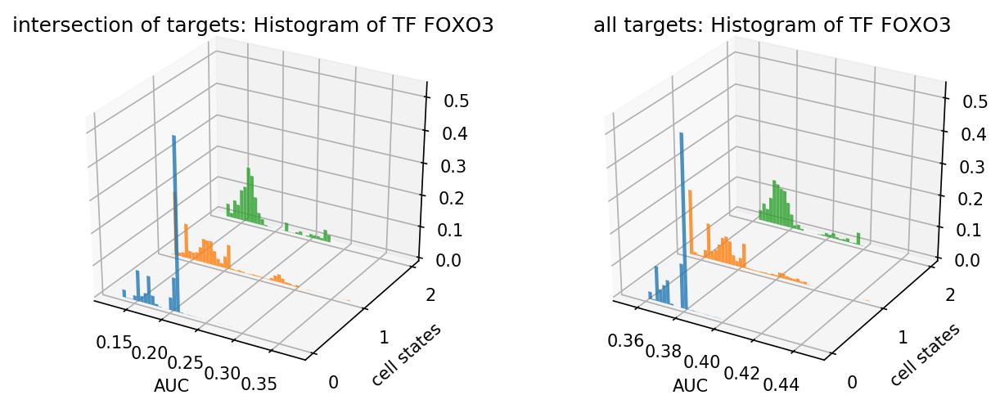

In [15]:
plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, last_only_no_simic)

---------
# TFs that are rank top in intersection, but last in all-targets

In [16]:
plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, top_simic_last_no_simic)

---
# TFs that are rank last in intersection, but top in all targets

Bcl3


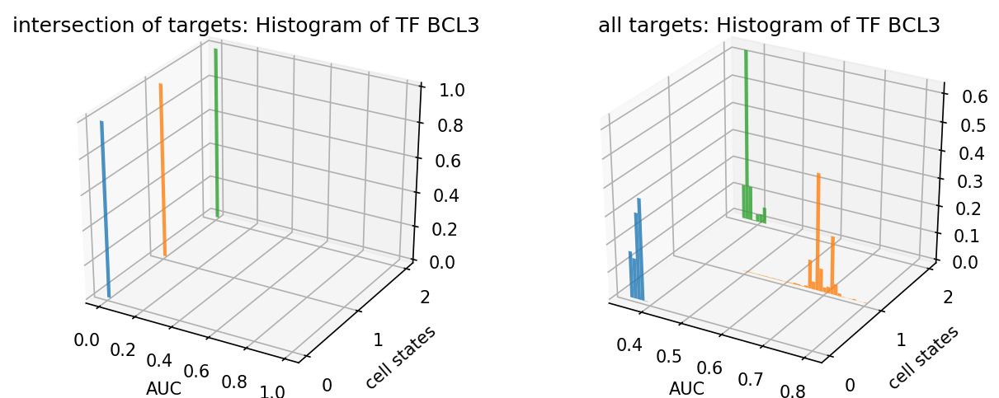

Nfic


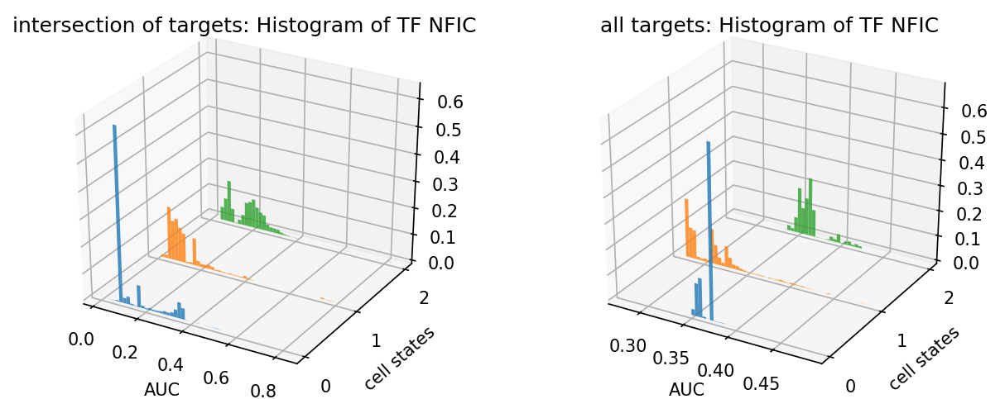

Tfam


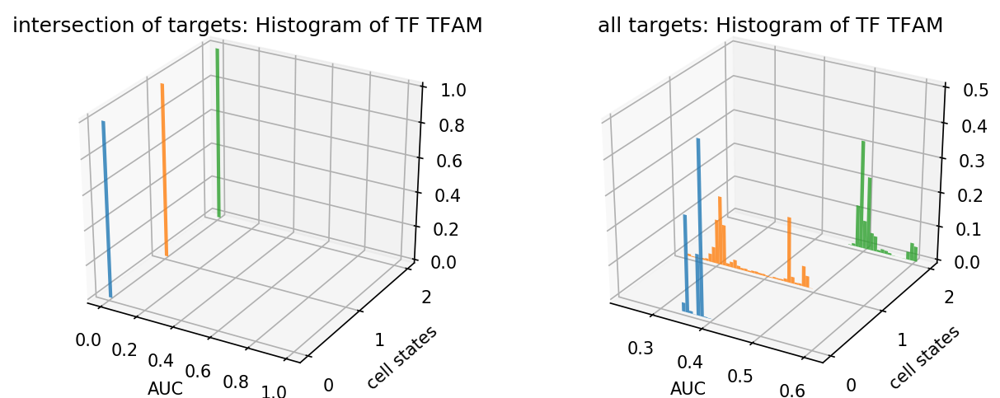

Zfp91


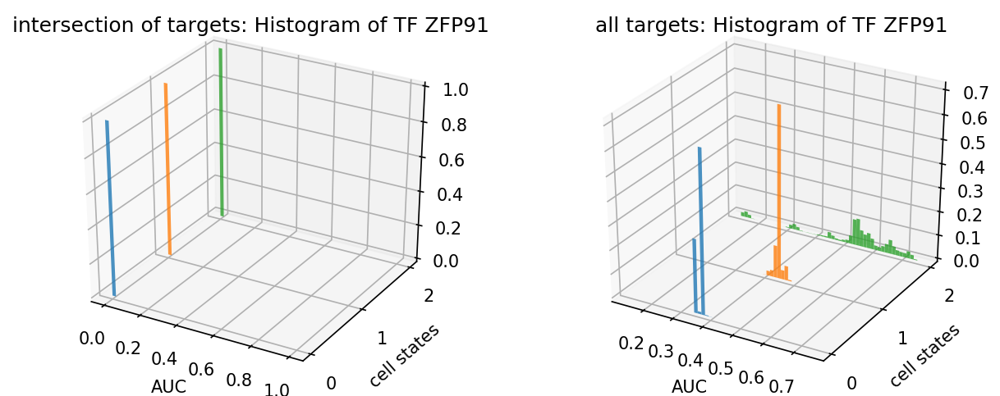

Sfpq


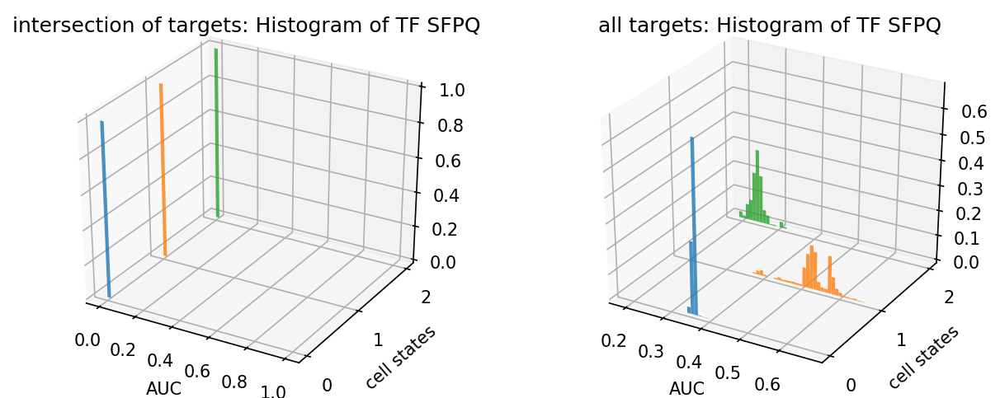

Nr0b2


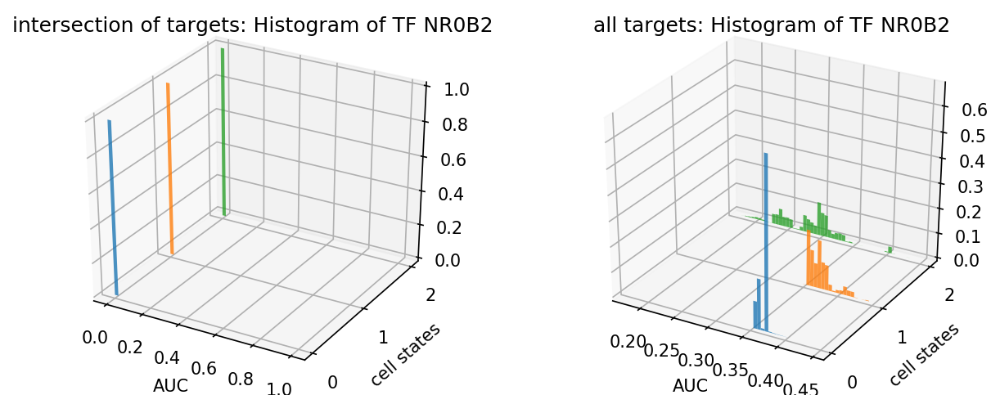

Rora


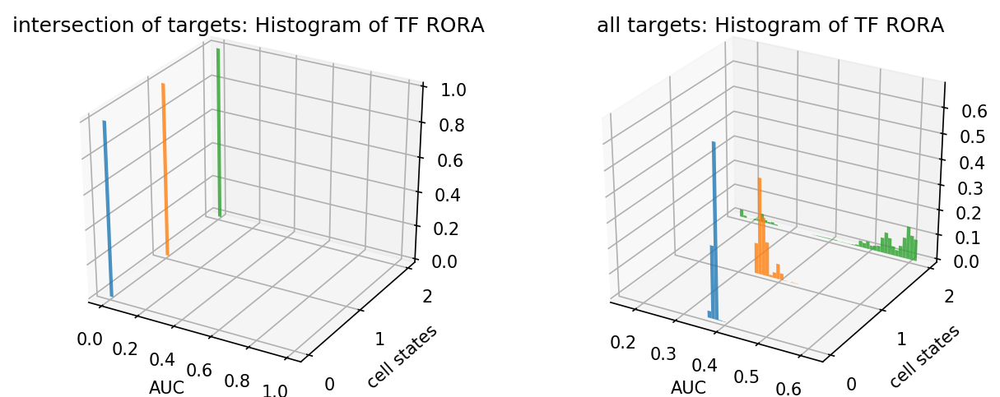

Nr3c1


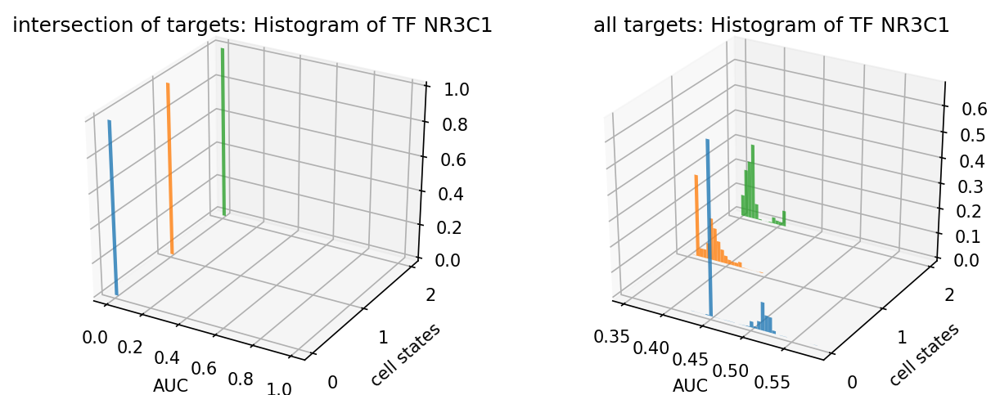

Tsc22d3


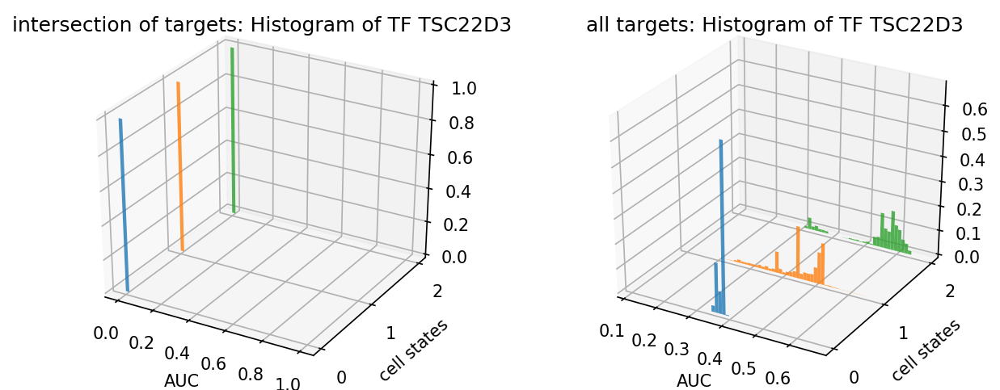

Junb


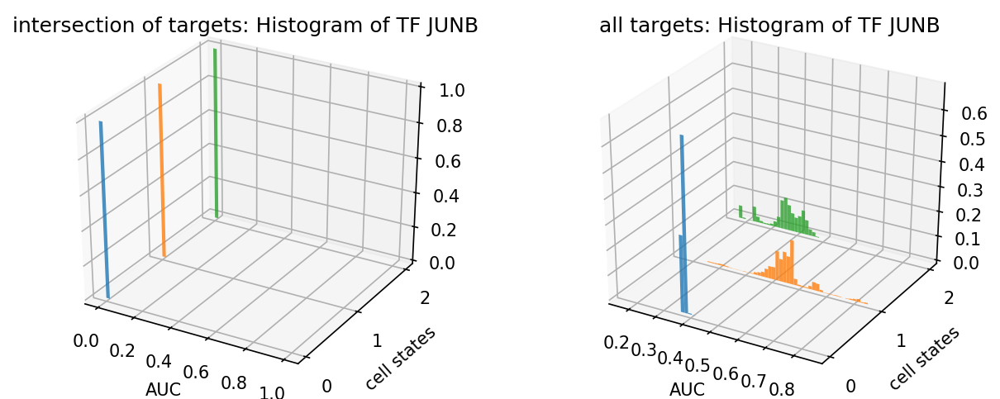

Nono


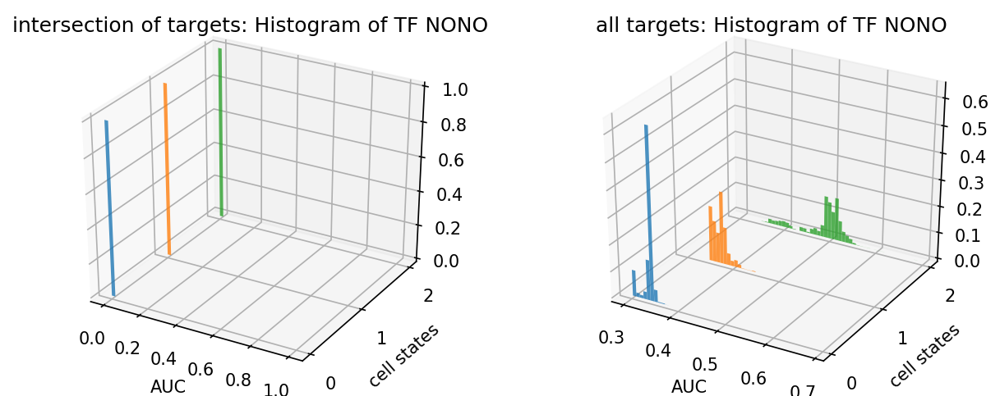

Peg3


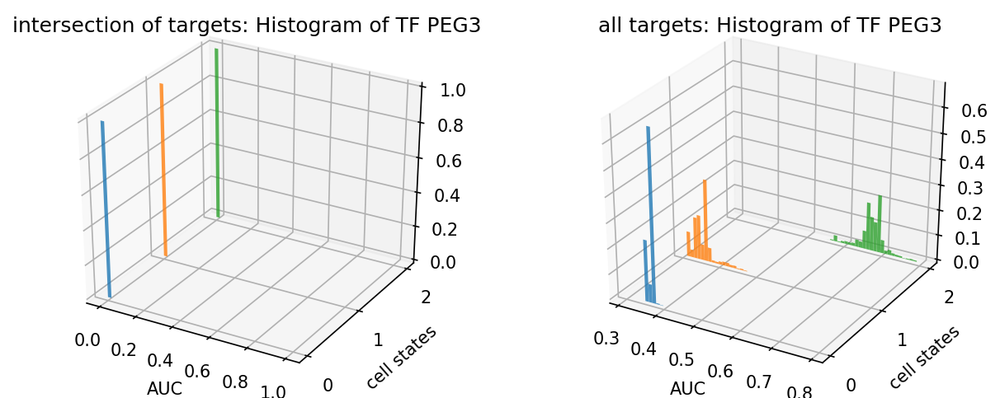

Bhlhe40


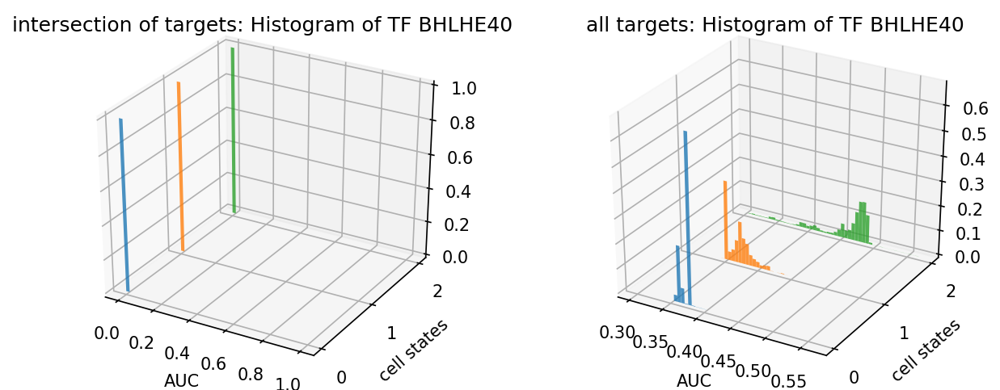

Tcf25


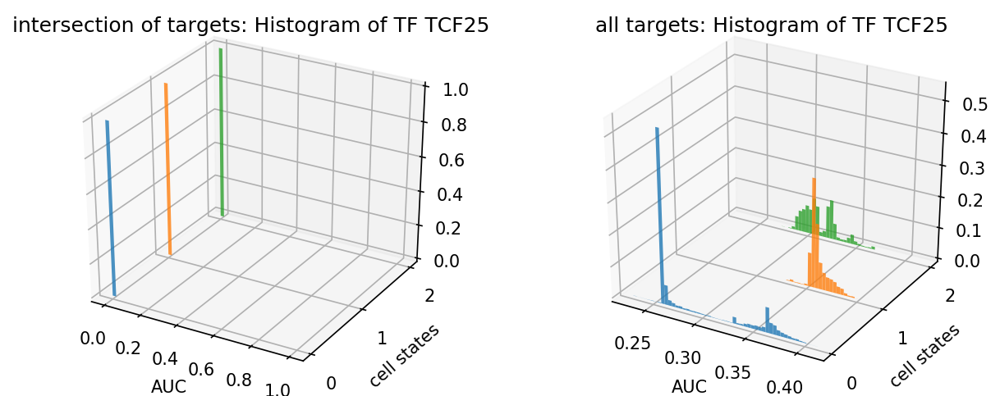

Pbrm1


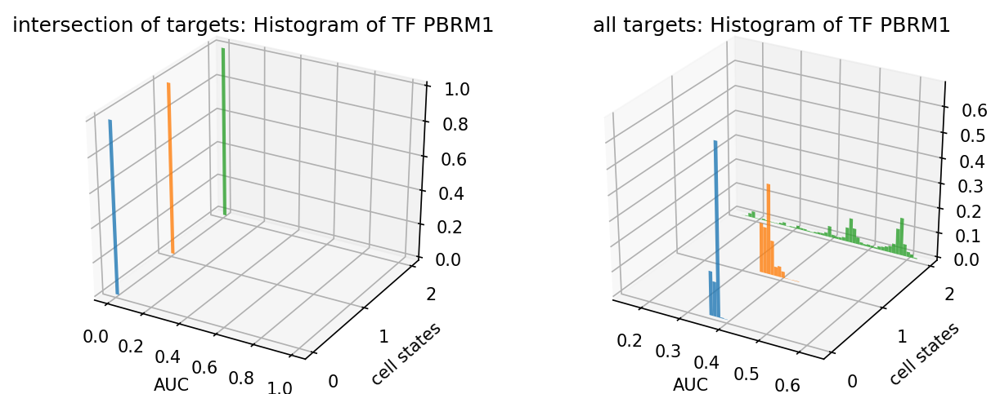

Smarce1


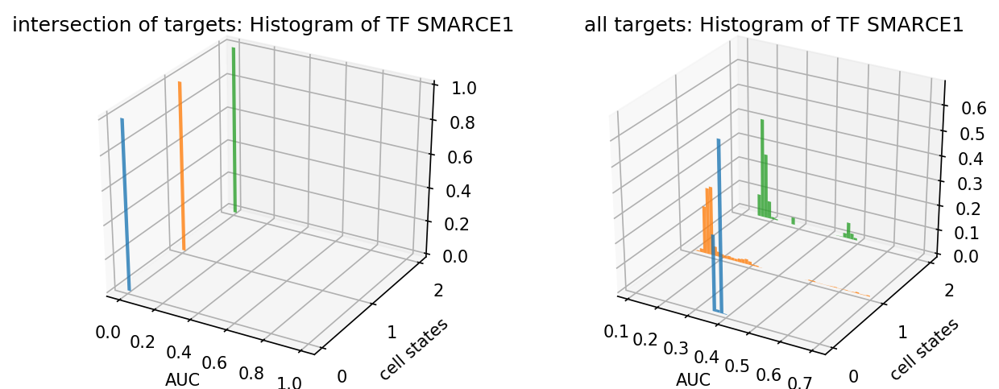

In [17]:
plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, last_simic_top_no_simic)

-----
# UMAP plot of imputed expression colorred in binarized AUC

In [18]:
import umap
%matplotlib inline

import pickle
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from functools import reduce
import numpy as np
import pandas as pd
import ipdb
import copy
import seaborn as sns

plt.rcParams['figure.dpi'] = 150

In [19]:
p2df = '/data/jianhao/hepatocyte_update_dataset_101619/magic_cell_mat_w_label_pd'
# p2assign = '/data/jianhao/hepatocyte_update_dataset_101619/hepa_A249P_assign'

# assignment = []
# with open(p2assign, 'r') as f:
#     for line in f:
#         assignment.append(int(line))

df = pd.read_pickle(p2df)
df = df.drop(columns = ['label'])
df

,Rp1,Sox17,Mrpl15,Lypla1,Gm37988,Tcea1,Atp6v1h,Rb1cc1,4732440D04Rik,Pcmtd1,...,Prcd,Gm9465,Gm31508,AC154311.1,Fbxo40,AC168090.1,Wfikkn1,Crisp3,Peli3,Batf2
PN14_AAACCCAAGAAATGGG,0.004854,0.000539,0.591115,0.366935,0.000315,0.239336,0.120199,0.113393,0.002072,0.323168,...,-0.000244,0.000111,-0.000066,0.000232,-1.373859e-05,0.0,0.0,0.0,0.0,0.000152
PN14_AAACCCAAGCTGAGTG,0.004455,0.001884,0.358050,0.271369,0.000951,0.142879,0.088292,0.108493,0.003443,0.247182,...,0.000079,0.000028,0.000041,-0.000073,9.781208e-07,0.0,0.0,0.0,0.0,-0.000062
PN14_AAACCCACAACGTTAC,0.004492,0.001639,0.388067,0.285322,0.000816,0.155048,0.092182,0.108365,0.003189,0.256612,...,0.000009,0.000021,0.000021,-0.000035,-2.123797e-06,0.0,0.0,0.0,0.0,-0.000038
PN14_AAACCCAGTGCAATAA,0.004453,0.001879,0.358323,0.271515,0.000947,0.143037,0.088365,0.108483,0.003443,0.247273,...,0.000078,0.000027,0.000041,-0.000072,9.464348e-07,0.0,0.0,0.0,0.0,-0.000062
PN14_AAACCCAGTGCTCCGA,0.004463,0.001848,0.362035,0.273399,0.000929,0.144476,0.088859,0.108497,0.003409,0.248508,...,0.000068,0.000026,0.000038,-0.000068,4.196861e-07,0.0,0.0,0.0,0.0,-0.000059
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
PHx96_TTTGGTTGTACCCGAC,-0.000623,0.000605,1.137205,0.697996,-0.000048,0.472497,0.185700,0.190232,-0.000664,0.583412,...,0.003913,0.001488,0.000498,0.002821,1.312452e-03,0.0,0.0,0.0,0.0,0.001682
PHx96_TTTGGTTTCCAGTGTA,0.000141,-0.000569,0.940362,0.768103,-0.000276,0.415704,0.176906,0.225551,0.003126,0.655176,...,0.003943,0.000501,0.000726,0.002950,1.810040e-03,0.0,0.0,0.0,0.0,0.001591
PHx96_TTTGGTTTCCATGATG,-0.000056,-0.000831,0.883037,0.738153,-0.000483,0.388767,0.159912,0.214883,0.002815,0.619076,...,0.003794,0.000426,0.000728,0.002927,1.830409e-03,0.0,0.0,0.0,0.0,0.001548
PHx96_TTTGTTGCAAGCTACT,0.003265,0.002349,0.657112,1.464797,-0.000965,0.585532,0.355755,0.569388,0.017105,1.287136,...,0.001492,-0.000112,0.000185,0.001373,2.877550e-03,0.0,0.0,0.0,0.0,0.000824


In [20]:
set(assign_list)

{0, 1, 2}

In [21]:
reducer = umap.UMAP(random_state=42)
embedding = reducer.fit_transform(df.values)
print(embedding.shape)

/home/jianhao2/miniconda3/envs/conda3_py/lib/python3.6/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 4 separate connected components using meta-embedding (experimental)
  n_components


(18272, 2)


In [22]:
len(assign_list)

18272

In [23]:
def umap_plot(embedding, assignment, title, n_states = None, cmap_name = 'Spectral'):
    if n_states == None:
        n_states = len(set(assignment))
    plt.figure(figsize = (4, 3))
    scatter = plt.scatter(embedding[:, 0], embedding[:, 1], c=assignment, 
                          cmap = plt.get_cmap(cmap_name), s = 5)
    plt.colorbar(boundaries=np.arange(n_states + 1) - 0.5).set_ticks(np.arange(n_states))
    plt.title(title)
    
    plt.grid(alpha = 0.5)
    plt.show()

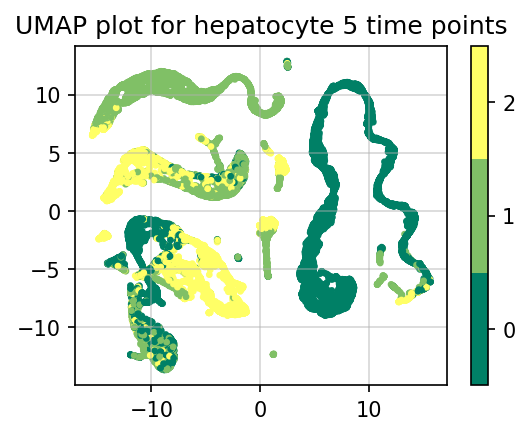

In [24]:
# n_states = len(set(assignment))
umap_plot(embedding, assign_list, 'UMAP plot for hepatocyte 5 time points', cmap_name = 'summer')

# UMAP plots with RAW/Binarized AUC value for each cell

In [25]:
selected_gene = 'Stat5b'
# selected_gene = 'Nono'

In [26]:
def four_plots_together(embedding, df, assign_list, gene_name, cmap_name = 'summer'):
#     if n_states == None:
#         n_states = len(set(assignment))
    fig, axs = plt.subplots(2, 2, sharex = True, sharey = True, figsize = (6, 5))
    normalize = colors.Normalize(vmin = 0, vmax=1)
    
    # plot of true label.
    ax = axs[0, 0]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=assign_list,
                          cmap = plt.get_cmap(cmap_name), 
                          s = 3, alpha = 0.6)
    n_states = len(set(assign_list))
    cb = fig.colorbar(im, ax = ax,
                     boundaries=np.arange(n_states + 1) - 0.5)
    cb.set_ticks(np.arange(n_states))
    title = 'UMAP of expression for {} states'.format(n_states)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False)
    
    # plot of normalized raw AUC value.
    ax = axs[0, 1]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = None,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar normalized)'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    
    # plot of normalized raw AUC value.
    ax = axs[1, 0]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = normalize,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar un-norm)'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False, labelbottom = False)
    
    # plot of binarized AUC value.
    ax = axs[1, 1]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['bin_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = normalize,
                          s = 3, alpha = 0.6)
    n_states = 2
    cb = fig.colorbar(im, ax = ax,
                     boundaries=np.arange(n_states + 1) - 0.5)
    cb.set_ticks(np.arange(n_states))
    title = 'UMAP labeled by binarized AUC value \n of gene {}'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False, labelbottom = False)
    plt.show()

Stat5b


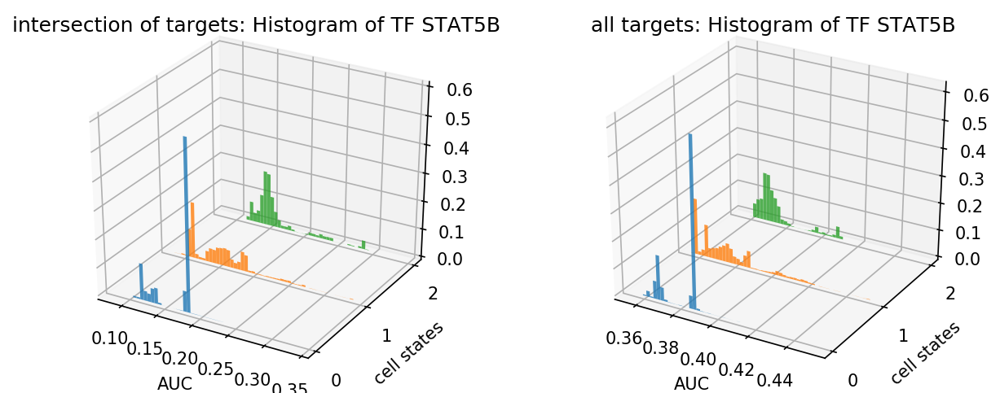

In [27]:
plot_two_in_row(TF_hist_dict_simic, TF_hist_dict_no_simic, [selected_gene])

## Results for intersection

In [28]:
with open(p2AUC_dict_intersect, 'rb') as f:
    AUC_dict_simic = pickle.load(f)
    AUC_dict_simic = separate_state(AUC_dict_simic)
AUC_dict_simic.keys()

dict_keys([0, 1, 2])

In [29]:
threshold = 0.4
state_label_list = []
raw_AUC_list = []
for state in AUC_dict_simic.keys():
#     AUC_dict_simic[0].keys()
    binarized_label = (AUC_dict_simic[state][selected_gene.capitalize()] > threshold).astype(int)
    state_label_list.append(binarized_label)
    raw_AUC_list.append(AUC_dict_simic[state][selected_gene.capitalize()])
total_bin_label = pd.concat(state_label_list)
# ipdb.set_trace()
df['bin_label'] = total_bin_label

total_raw_label = pd.concat(raw_AUC_list)
df['raw_label'] = total_raw_label

In [ ]:
four_plots_together(embedding, df, assign_list, selected_gene)
print('threshold = ', threshold)

## Results for all targets

In [30]:
with open(p2AUC_dict_all, 'rb') as f:
    AUC_dict_no_simic = pickle.load(f)
    AUC_dict_no_simic = separate_state(AUC_dict_no_simic)
AUC_dict_no_simic.keys()

dict_keys([0, 1, 2])

In [31]:
threshold = 0.375
# umap_plot(embedding, assign_list, 'UMAP plot for hepatocyte 5 time points')
state_label_list = []
raw_AUC_list = []
for state in AUC_dict_no_simic.keys():
#     AUC_dict_simic[0].keys()
    binarized_label = (AUC_dict_no_simic[state][selected_gene.capitalize()] > threshold).astype(int)
    state_label_list.append(binarized_label)
    raw_AUC_list.append(AUC_dict_no_simic[state][selected_gene.capitalize()])
total_bin_label = pd.concat(state_label_list)
# ipdb.set_trace()
df['bin_label'] = total_bin_label

total_raw_label = pd.concat(raw_AUC_list)
df['raw_label'] = total_raw_label

In [ ]:
four_plots_together(embedding, df, assign_list, selected_gene)
print('threshold = ', threshold)

# Side by side comparison of simic & no-simic

In [ ]:
def side_by_side_cmp(embedding, df, assign_list, gene_name, cmap_name = 'summer'):
#     if n_states == None:
#         n_states = len(set(assignment))
    fig, axs = plt.subplots(4, 2, sharex = True, sharey = True, figsize = (6, 10))
    normalize = colors.Normalize(vmin = 0, vmax=1)
    
    # plot of true label.
    ax = axs[0, 0]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=assign_list,
                          cmap = plt.get_cmap(cmap_name), 
                          s = 3, alpha = 0.6)
    n_states = len(set(assign_list))
    cb = fig.colorbar(im, ax = ax,
                     boundaries=np.arange(n_states + 1) - 0.5)
    cb.set_ticks(np.arange(n_states))
    title = 'UMAP of expression for {} states'.format(n_states)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False)
    axs[0, 1].axis('off')
    
    # plot of normalized raw AUC value.
    ax = axs[1, 0]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['simic_raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = None,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar normalized) - simic'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    
    # plot of normalized raw AUC value - no simic.
    ax = axs[1, 1]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['no_simic_raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = None,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar normalized) - NO simic'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    
    # plot of normalized raw AUC value.
    ax = axs[2, 0]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['simic_raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = normalize,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar un-norm) - simic'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False, labelbottom = False)
    
    # plot of normalized raw AUC value - no simic.
    ax = axs[2, 1]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['no_simic_raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = normalize,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar un-norm) - NO simic'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False, labelbottom = False)
    
    # plot of binarized AUC value.
    ax = axs[3, 0]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['simic_bin_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = normalize,
                          s = 3, alpha = 0.6)
    n_states = 2
    cb = fig.colorbar(im, ax = ax,
                     boundaries=np.arange(n_states + 1) - 0.5)
    cb.set_ticks(np.arange(n_states))
    title = 'UMAP labeled by binarized AUC value \n of gene {} - simic'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False, labelbottom = False)
    
    # plot of binarized AUC value - no simic.
    ax = axs[3, 1]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['no_simic_bin_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = normalize,
                          s = 3, alpha = 0.6)
    n_states = 2
    cb = fig.colorbar(im, ax = ax,
                     boundaries=np.arange(n_states + 1) - 0.5)
    cb.set_ticks(np.arange(n_states))
    title = 'UMAP labeled by binarized AUC value \n of gene {} - NO simic'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    ax.tick_params(axis = 'both', which = 'both', labelleft = False, labelbottom = False)
    
    plt.show()

In [ ]:
# --- simic
threshold = 0.4
state_label_list = []
raw_AUC_list = []
for state in AUC_dict_simic.keys():
    binarized_label = (AUC_dict_simic[state][selected_gene.capitalize()] > threshold).astype(int)
    state_label_list.append(binarized_label)
    raw_AUC_list.append(AUC_dict_simic[state][selected_gene.capitalize()])
total_bin_label = pd.concat(state_label_list)
# ipdb.set_trace()
df['simic_bin_label'] = total_bin_label

total_raw_label = pd.concat(raw_AUC_list)
df['simic_raw_label'] = total_raw_label

# --- no simic
threshold = 0.375
state_label_list = []
raw_AUC_list = []
for state in AUC_dict_no_simic.keys():
    binarized_label = (AUC_dict_no_simic[state][selected_gene.capitalize()] > threshold).astype(int)
    state_label_list.append(binarized_label)
    raw_AUC_list.append(AUC_dict_no_simic[state][selected_gene.capitalize()])
total_bin_label = pd.concat(state_label_list)
# ipdb.set_trace()
df['no_simic_bin_label'] = total_bin_label

total_raw_label = pd.concat(raw_AUC_list)
df['no_simic_raw_label'] = total_raw_label

In [ ]:
side_by_side_cmp(embedding, df, assign_list, selected_gene)

# UMAP plots for all TFS

In [32]:
def intersect_vs_all(embedding, df, assign_list, AUC_dict_simic, AUC_dict_no_simic, gene_name, cmap_name = 'summer'):
    # --- simic
    raw_AUC_list = []
    for state in AUC_dict_simic.keys():
        raw_AUC_list.append(AUC_dict_simic[state][gene_name.capitalize()])

    total_raw_label = pd.concat(raw_AUC_list)
    df['inter_raw_label'] = total_raw_label

    # --- no simic
    raw_AUC_list = []
    for state in AUC_dict_no_simic.keys():

        raw_AUC_list.append(AUC_dict_no_simic[state][gene_name.capitalize()])

    total_raw_label = pd.concat(raw_AUC_list)
    df['all_raw_label'] = total_raw_label


    fig, axs = plt.subplots(1, 2, sharex = True, sharey = True, figsize = (6, 2))
    normalize = colors.Normalize(vmin = 0, vmax=1)

    
    # plot of normalized raw AUC value.
    ax = axs[0]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['inter_raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = None,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar normalized) - intersection'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    
    # plot of normalized raw AUC value - no simic.
    ax = axs[1]
    im = ax.scatter(embedding[:, 0], embedding[:, 1], c=df['all_raw_label'].values,
                          cmap = plt.get_cmap(cmap_name), norm = None,
                          s = 3, alpha = 0.6)
    cb = fig.colorbar(im, ax = ax)
    title = 'UMAP labeled by AUC value of gene {}\n states (colorbar normalized) - all'.format(gene_name)
    ax.set_title(title, fontsize = 6)
    ax.grid(alpha = 0.5)
    print('-' * 7)
    print(gene_name)
    
    plt.show()

In [33]:
# intersect_top_only_simic = {'Smarcc1', 'Aebp2', 'Smarcc2', 'Stat3', 'Rara', 'Dnajc2', 'Tsc22d2', 'Usf2', 'Ubp1', 'Mga', 'Ncoa2', 'Nfe2l1', 'Nr1i2', 'Zhx3', 'Srebf1', 'Nfatc3', 'Hmg20b', 'Tshz1', 'Ssrp1', 'Nfx1', 'Smad4', 'Foxo1', 'Tbx3', 'Purb', 'Id1', 'Elk4'}
# intersect_last_only_simic = {'Pbrm1', 'Hnf4a', 'Dnajc1', 'Creb3l2', 'Egr1', 'Junb', 'Foxq1', 'Nono', 'Bhlhe40', 'Epas1', 'Rxra', 'Rora', 'Smarce1', 'Nr1h4', 'Tfam', 'Smarca5', 'Nfix', 'Bcl3', 'Nr1h3', 'Phf5a', 'Zfp91', 'Nr0b2', 'Mafb', 'Mlx', 'Hopx', 'Onecut2', 'Hes6', 'Nfic', 'Ybx1', 'Ahr', 'Sfpq', 'Stat1', 'Nr3c1', 'Nr2f6', 'Mlxipl', 'Nfib', 'Crem', 'Ncor1', 'Arid5b', 'Peg3', 'Klf9', 'Mier1', 'Tsc22d3', 'Foxn3', 'Tcf25', 'Klf15'}

# top_inter_last_all = {'Nfe2l1', 'Elk4', 'Tshz1'}
# last_inter_top_all = {'Pbrm1', 'Junb', 'Nono', 'Bhlhe40', 'Epas1', 'Rxra', 'Rora', 'Smarce1', 'Tfam', 'Smarca5', 'Bcl3', 'Zfp91', 'Nr0b2', 'Onecut2', 'Hes6', 'Nfic', 'Ahr', 'Sfpq', 'Stat1', 'Nr3c1', 'Nr2f6', 'Nfib', 'Peg3', 'Mier1', 'Tsc22d3', 'Foxn3', 'Tcf25', 'Klf15'}

intersect_top_only_simic = {'Stat3', 'Foxq1', 'Irf9', 'Stat6', 'Mafg', 'Ncor1', 'Mxd4', 'Nfyb', 'Srebf1', 'Crebl2', 'Foxa2', 'Tsc22d2', 'Ssrp1', 'Jund', 'Hnf4a', 'Zkscan3', 'Foxo1', 'Nfx1'}
intersect_last_only_simic ={'Bcl3', 'Tfam', 'Tsc22d3', 'Nfix', 'Nono', 'Junb', 'Pbrm1', 'Ncoa2', 'Sfpq', 'Mlxipl', 'Rora', 'Mef2a', 'Gtf3a', 'Zbtb38', 'Dnmt1', 'Zfp91', 'Lrrfip1', 'Nr1h3', 'Rreb1', 'Klf9', 'Nr5a2', 'Smarce1', 'Nfic', 'Nr0b2', 'Phf5a', 'Nr3c1', 'Peg3', 'Bhlhe40', 'Tcf25'}

top_inter_last_all = {}
last_inter_top_all = {'Bcl3', 'Nfic', 'Tfam', 'Zfp91', 'Sfpq', 'Nr0b2', 'Rora', 'Nr3c1', 'Tsc22d3', 'Junb', 'Nono', 'Peg3', 'Bhlhe40', 'Tcf25', 'Pbrm1', 'Smarce1'}



-------
STAT3


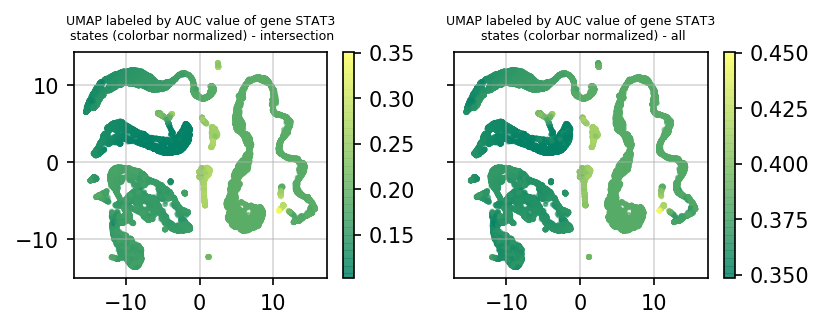

-------
FOXQ1


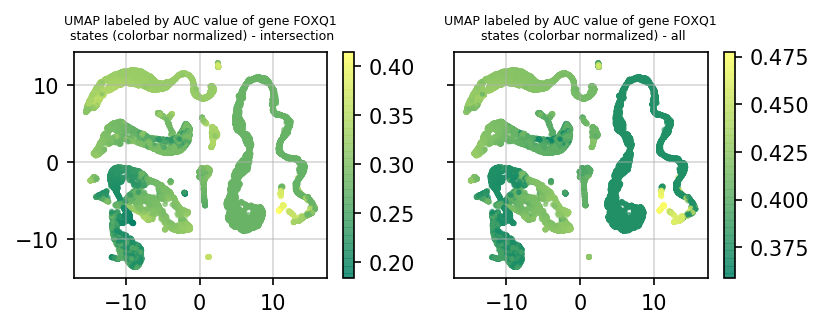

-------
IRF9


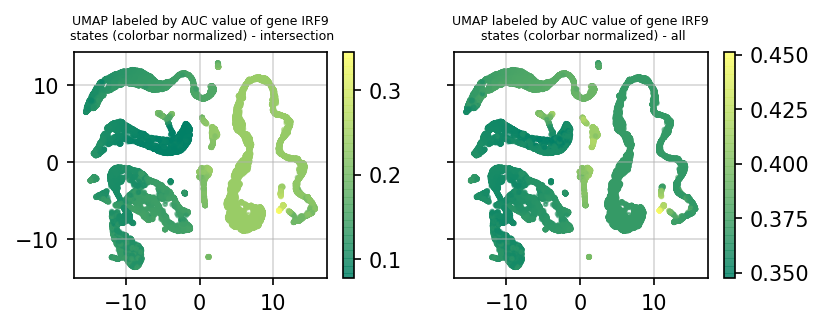

-------
STAT6


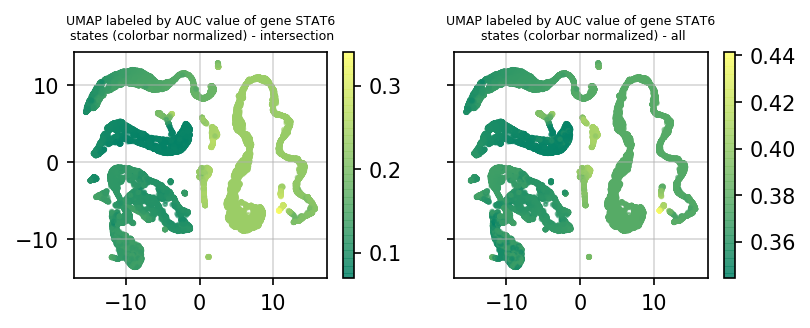

-------
MAFG


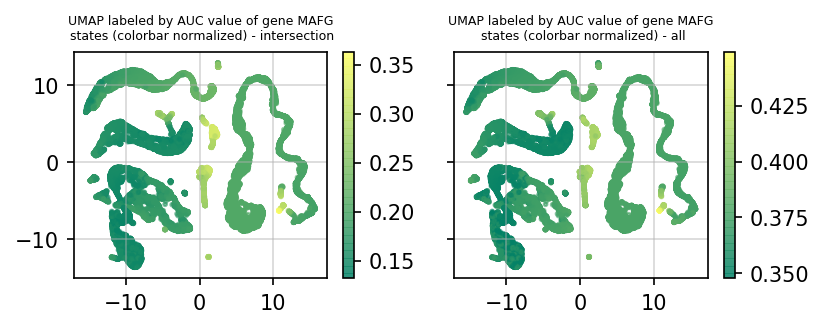

-------
NCOR1


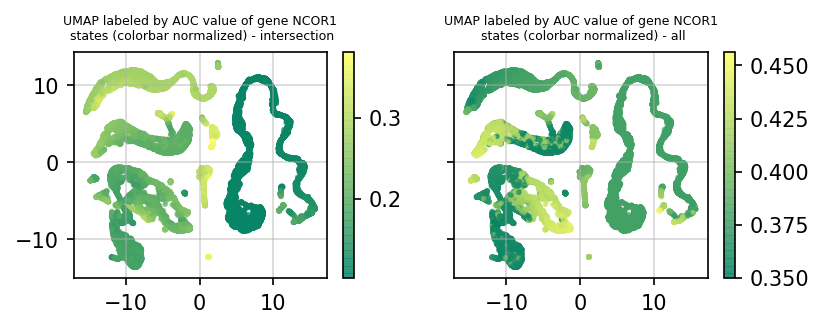

-------
MXD4


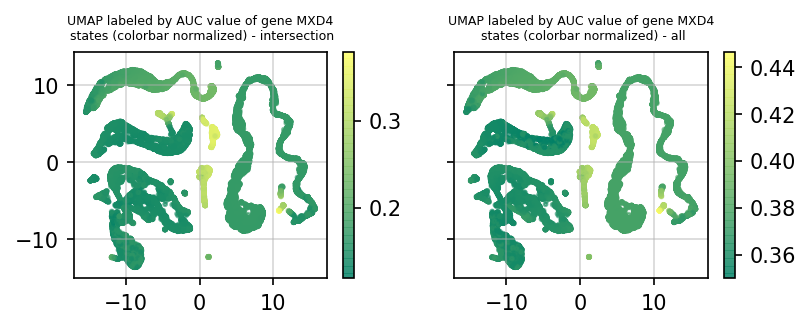

-------
NFYB


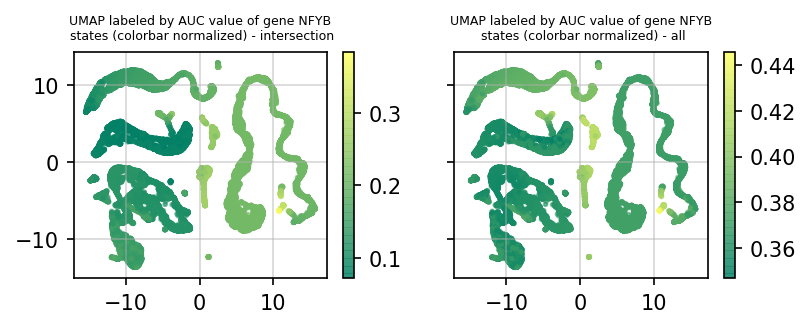

-------
SREBF1


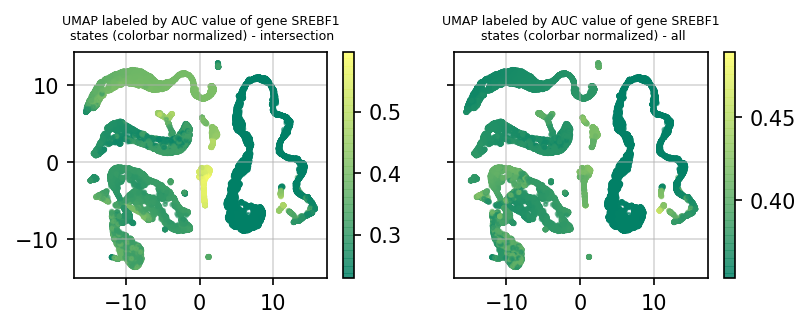

-------
CREBL2


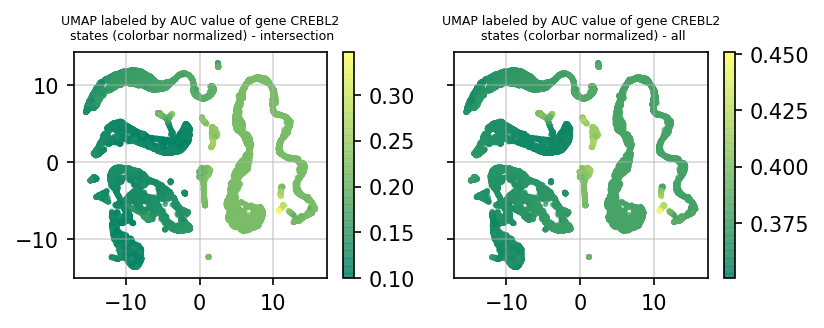

-------
FOXA2


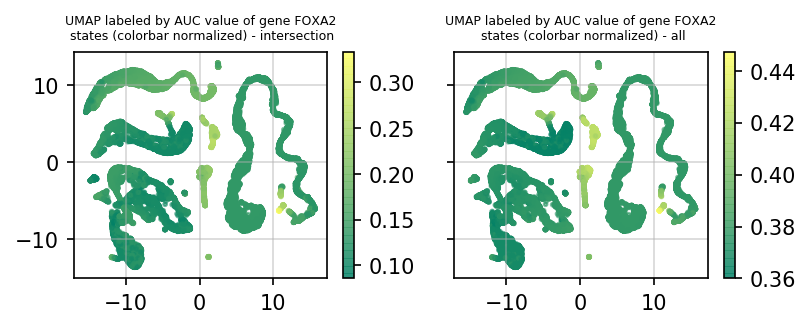

-------
TSC22D2


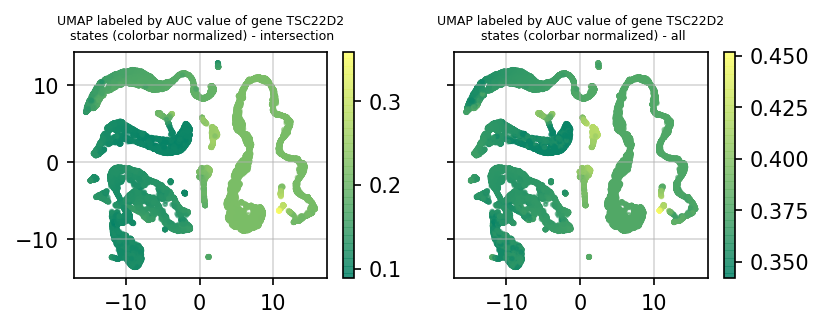

-------
SSRP1


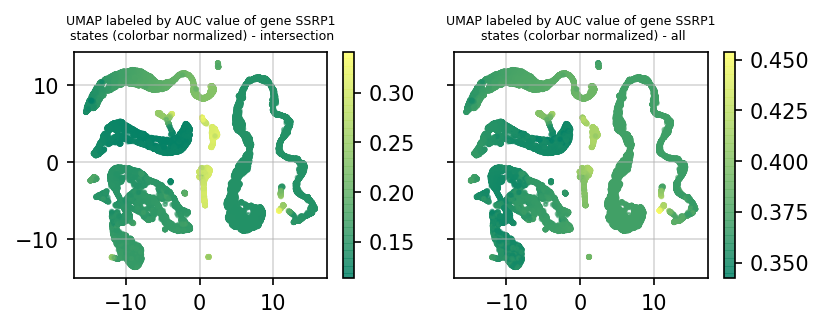

-------
JUND


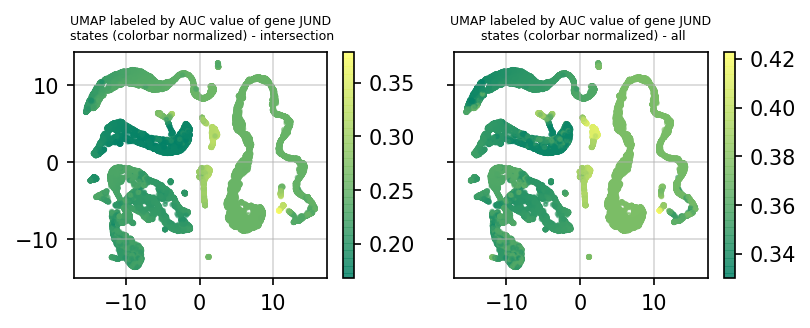

-------
NFX1


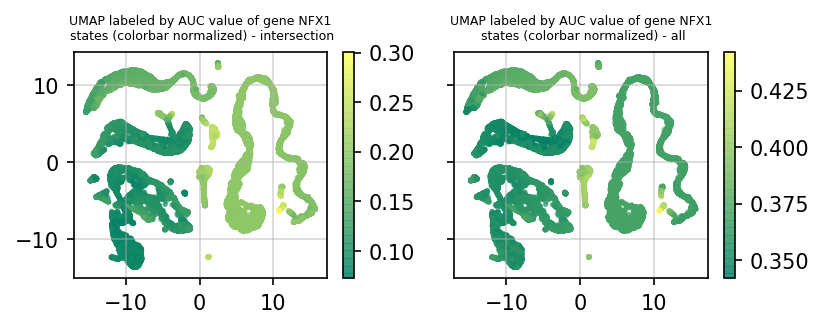

-------
ZKSCAN3


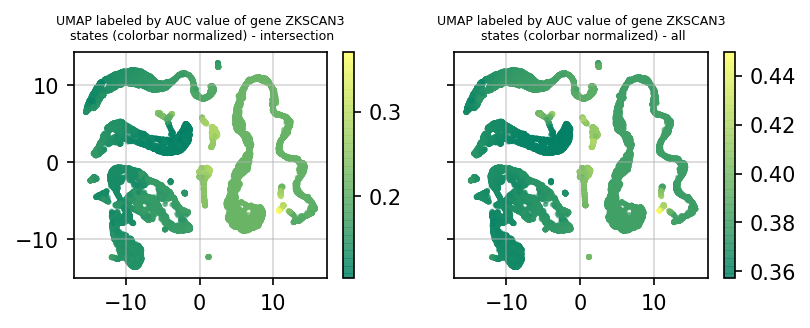

-------
FOXO1


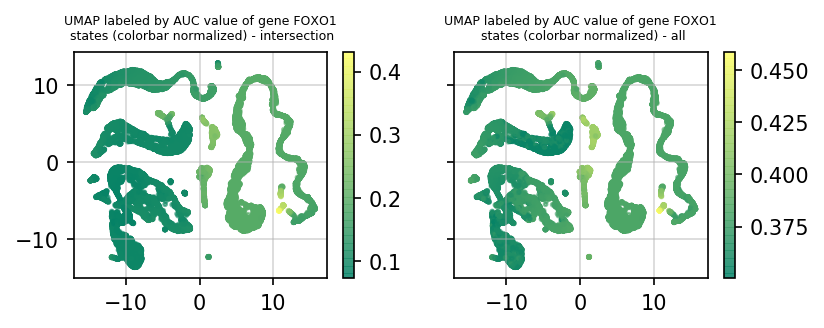

-------
HNF4A


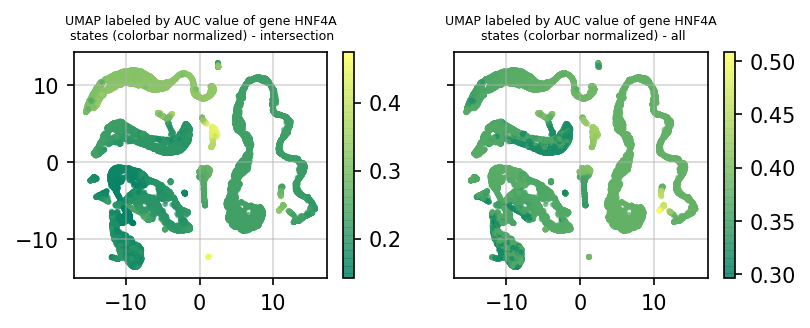

In [34]:
for gene in intersect_top_only_simic:
    intersect_vs_all(embedding, df, assign_list, AUC_dict_simic, AUC_dict_no_simic, gene.upper(), cmap_name = 'summer')
    

-------
BCL3


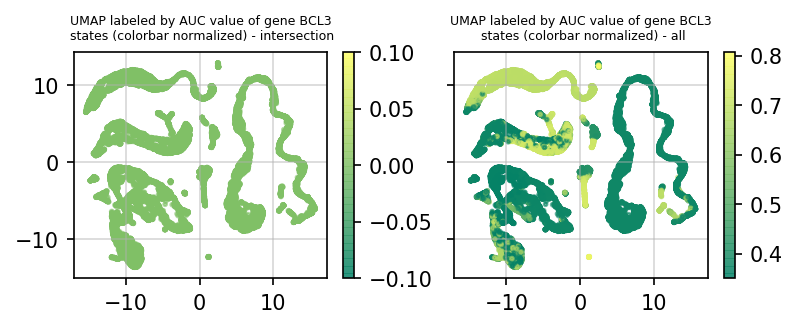

-------
TFAM


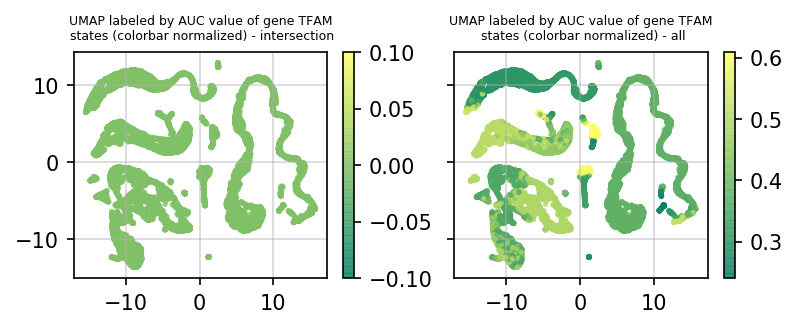

-------
TSC22D3


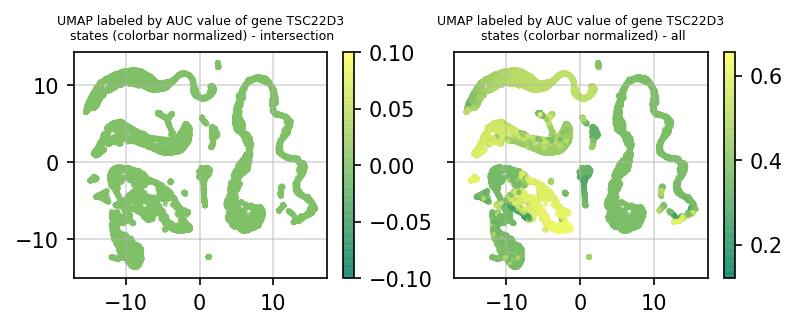

-------
NFIX


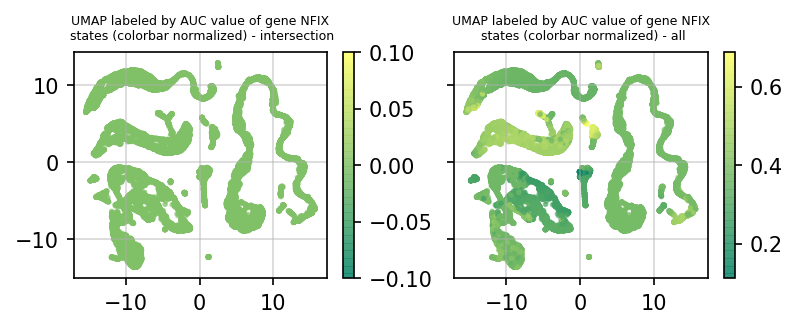

-------
NONO


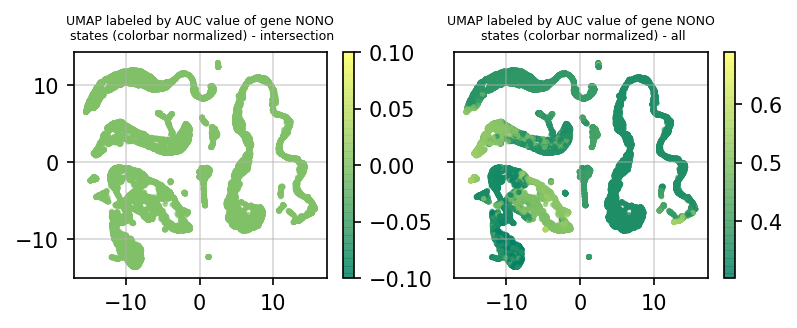

-------
JUNB


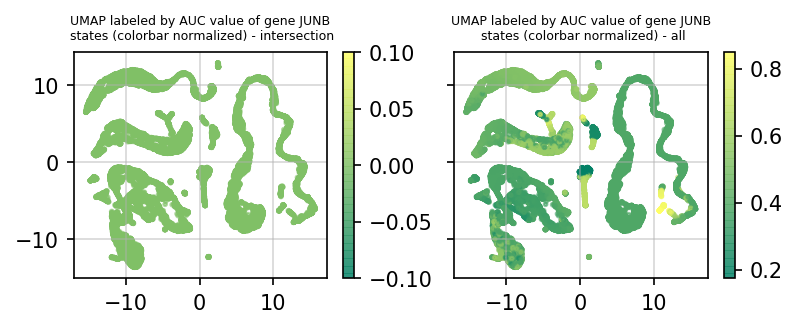

-------
PBRM1


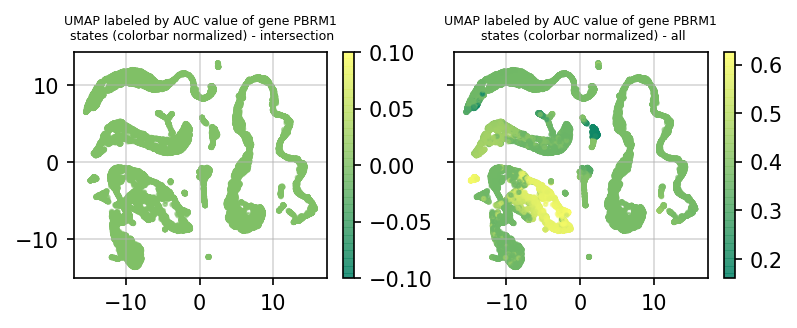

-------
NCOA2


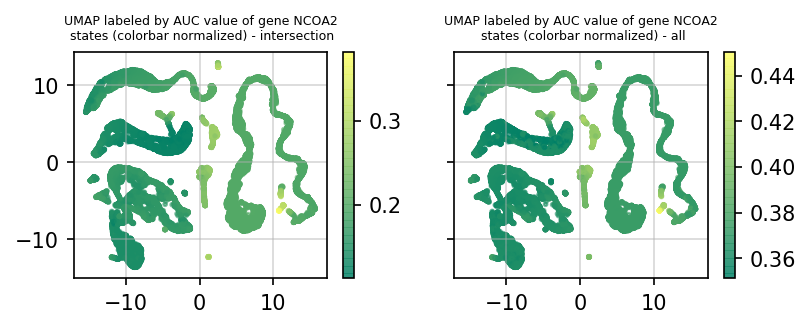

-------
SFPQ


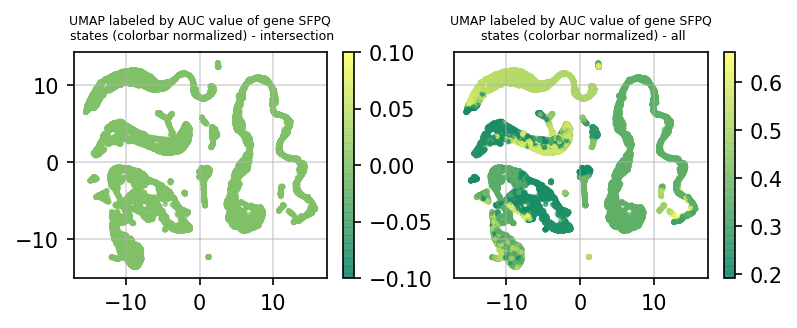

-------
MLXIPL


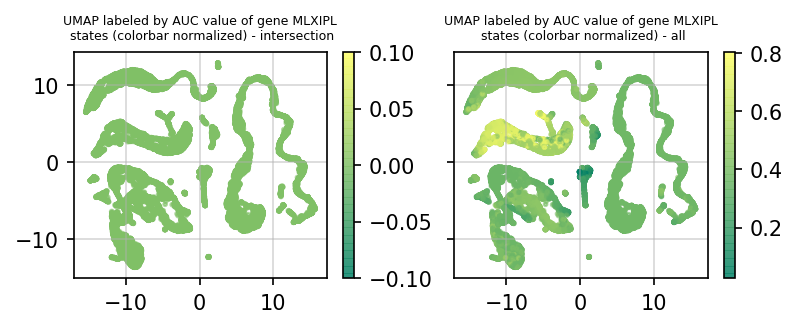

-------
RORA


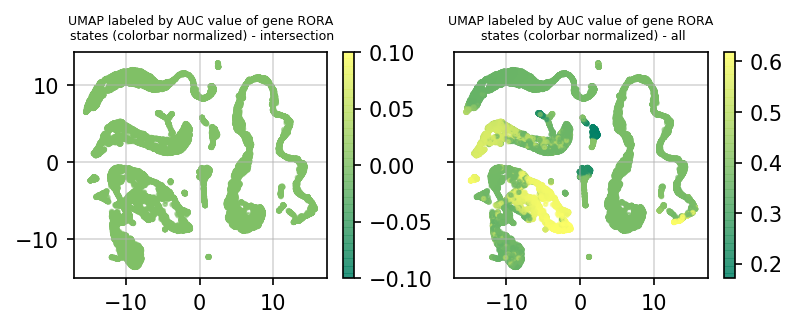

-------
MEF2A


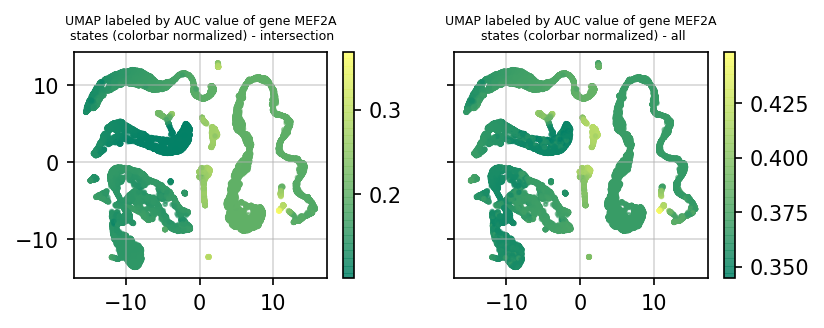

-------
GTF3A


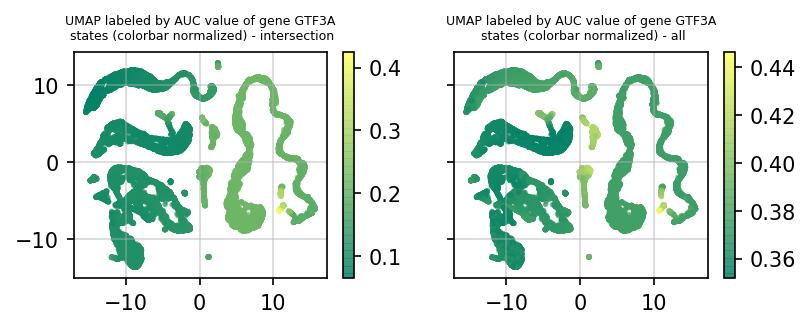

-------
ZBTB38


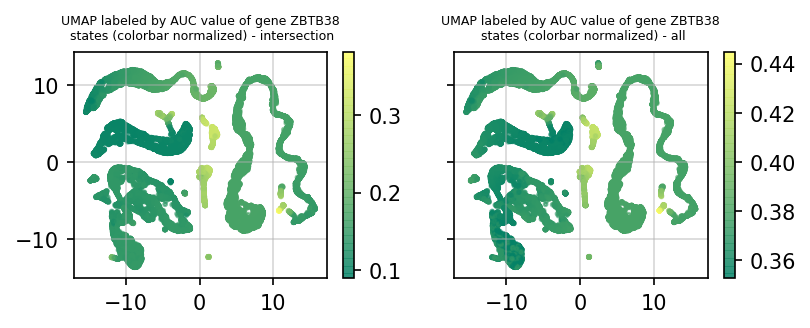

-------
DNMT1


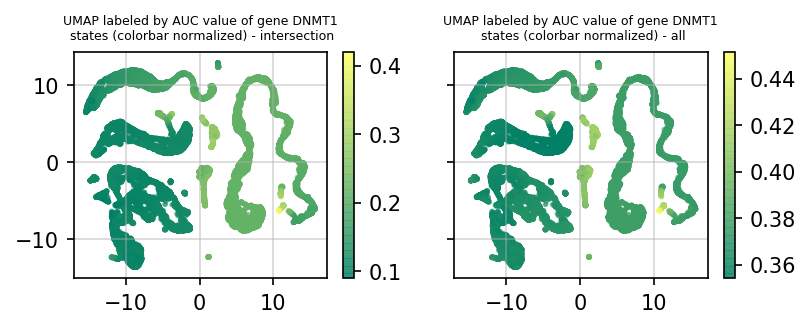

-------
ZFP91


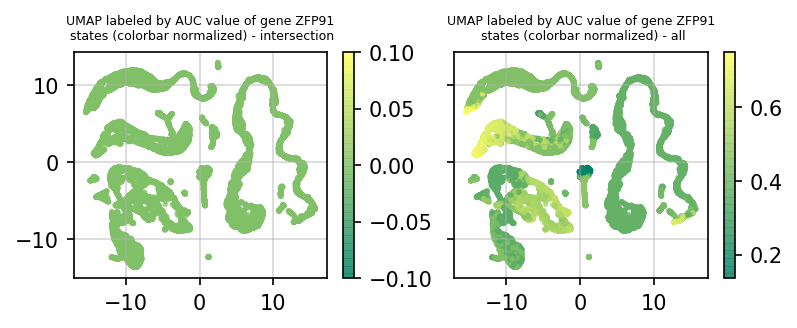

-------
LRRFIP1


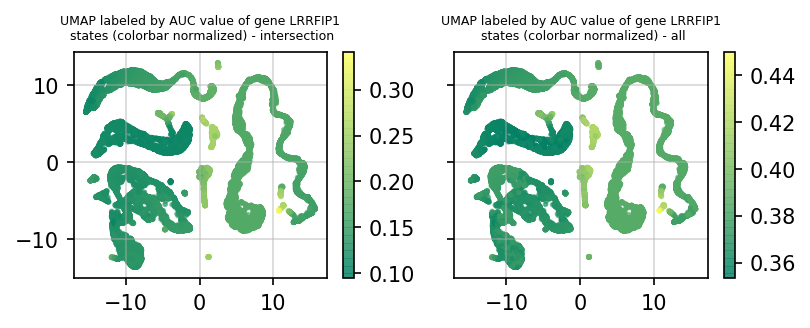

-------
NR1H3


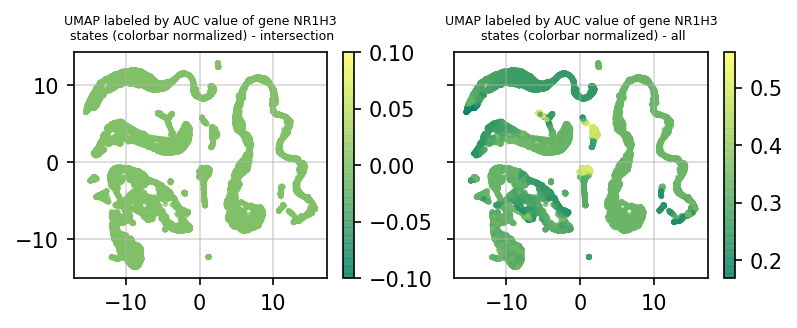

-------
RREB1


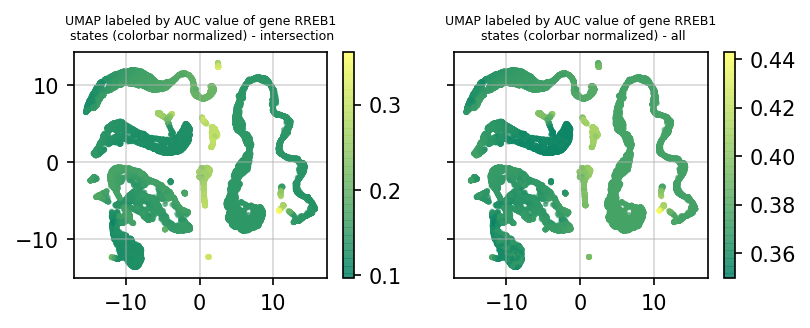

-------
KLF9


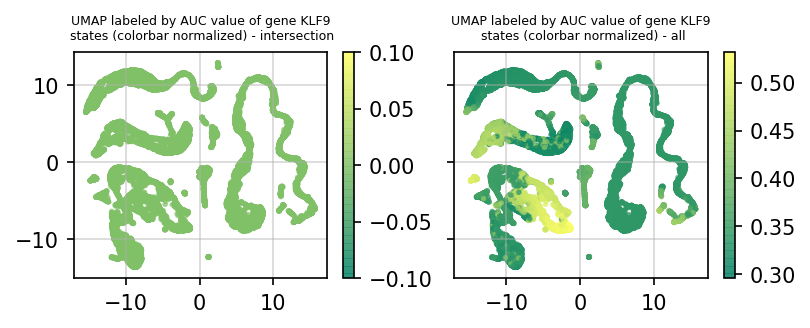

-------
NR5A2


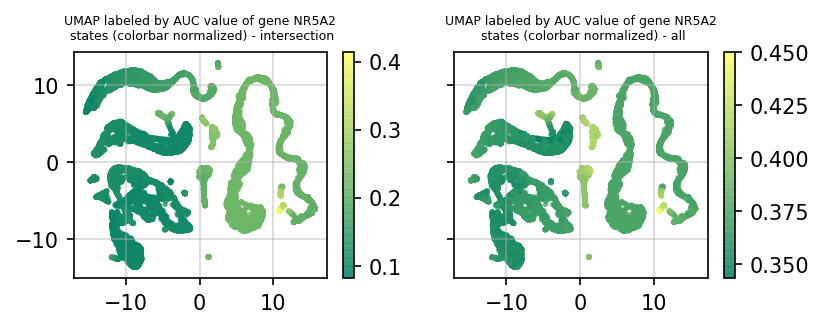

-------
SMARCE1


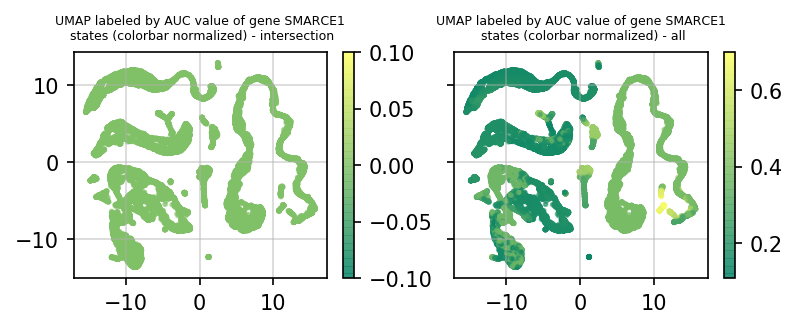

-------
NFIC


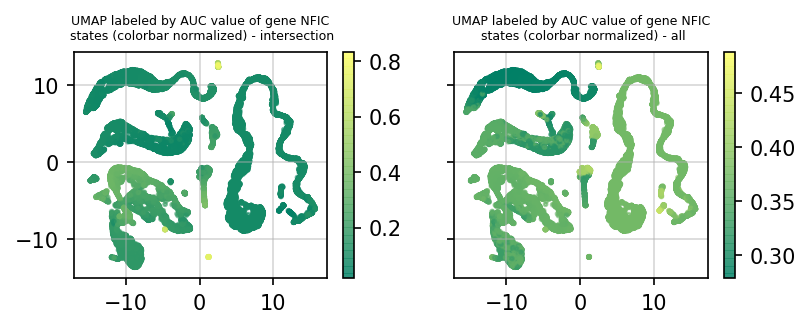

-------
NR0B2


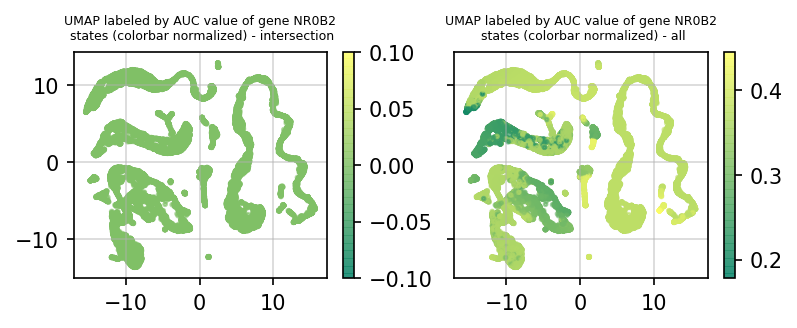

-------
PHF5A


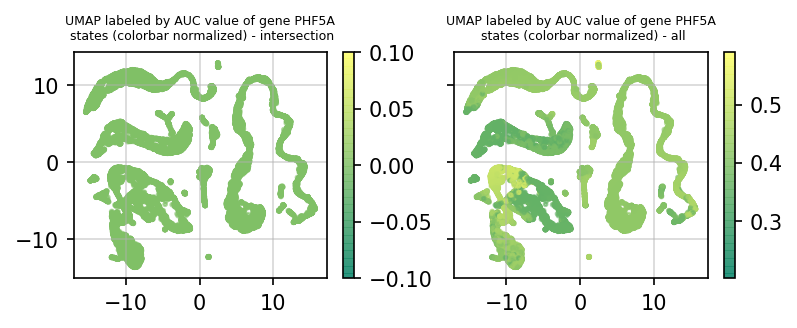

-------
NR3C1


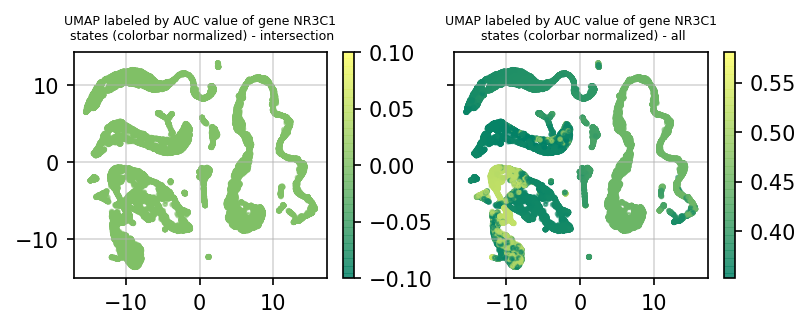

-------
PEG3


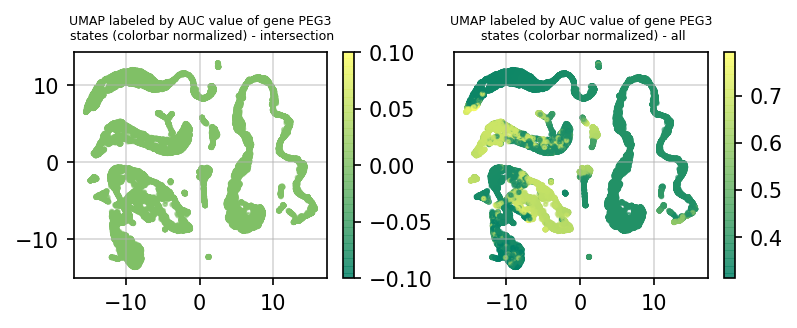

-------
BHLHE40


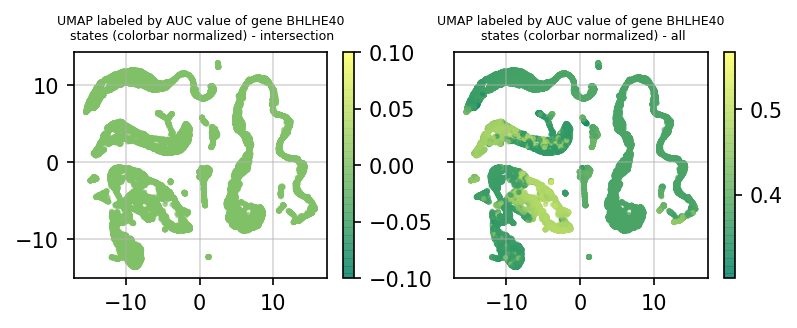

-------
TCF25


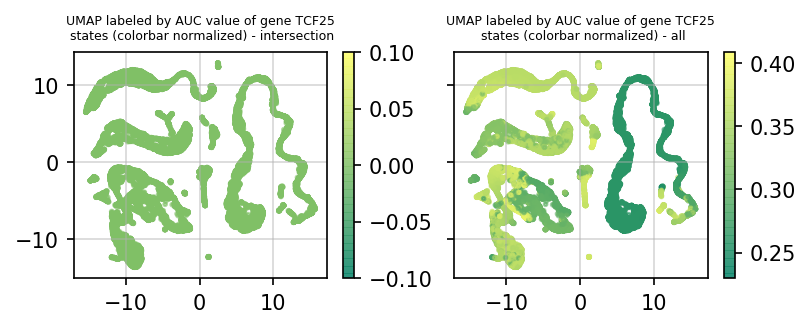

In [35]:
for gene in intersect_last_only_simic:
    intersect_vs_all(embedding, df, assign_list, AUC_dict_simic, AUC_dict_no_simic, gene.upper(), cmap_name = 'summer')
    

-------
BCL3


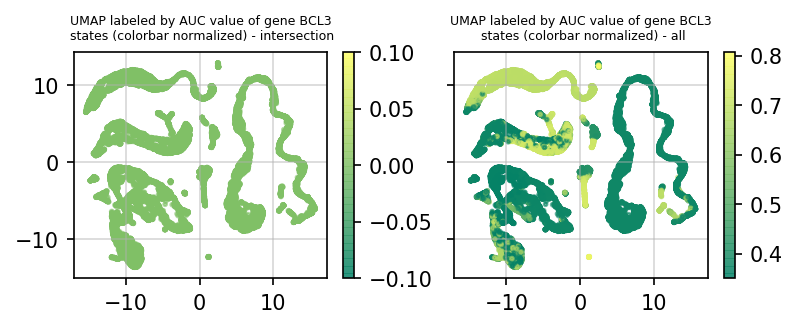

-------
NFIC


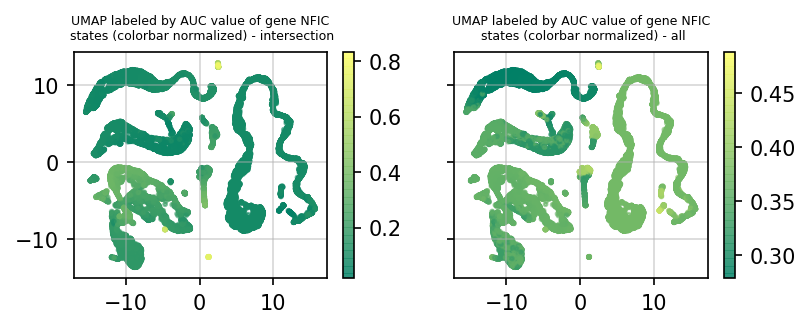

-------
ZFP91


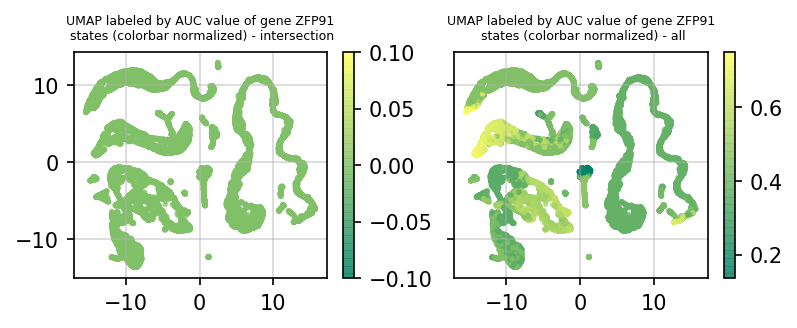

-------
TFAM


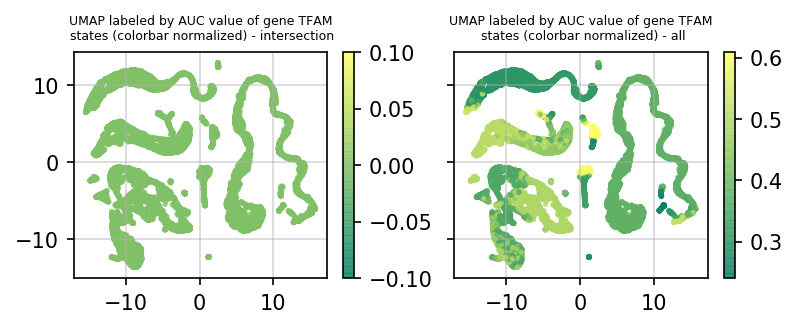

-------
SFPQ


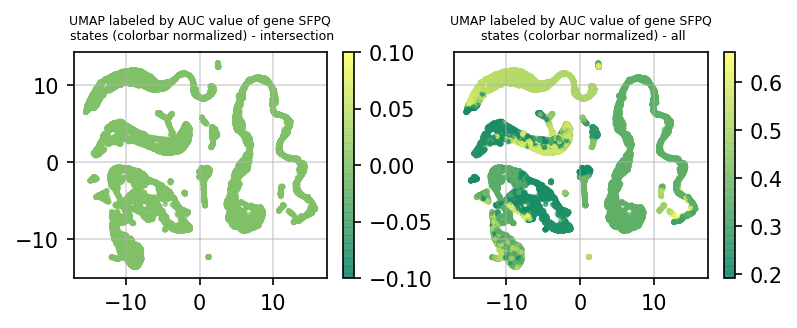

-------
NR0B2


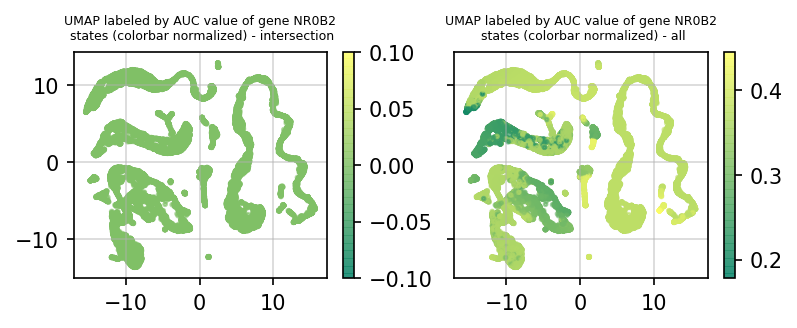

-------
RORA


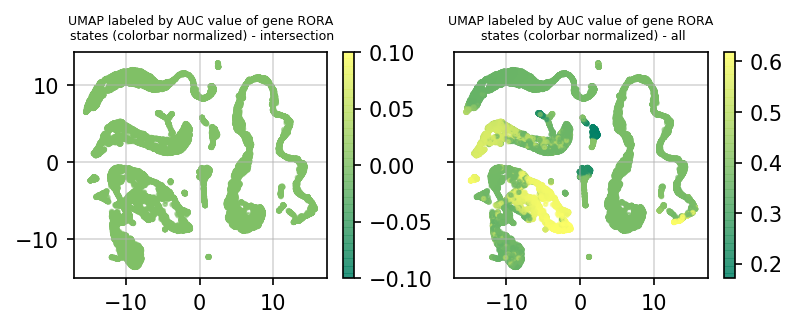

-------
NR3C1


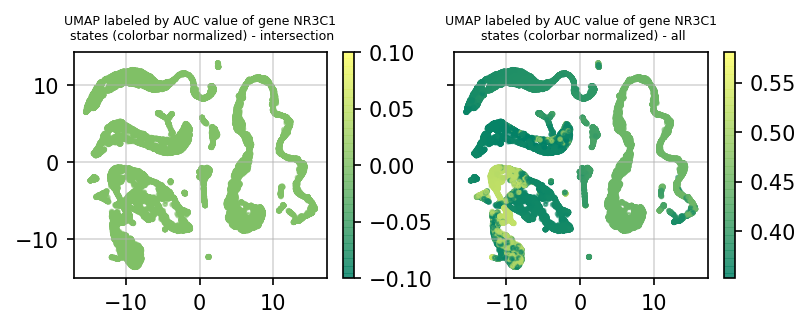

-------
TSC22D3


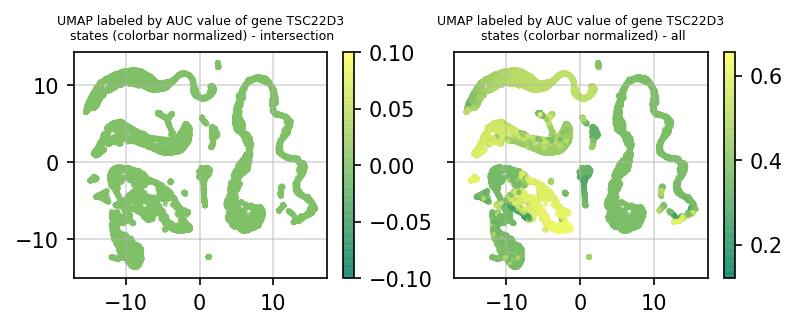

-------
JUNB


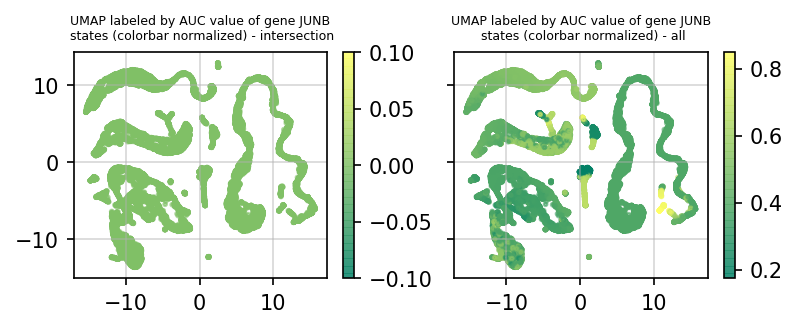

-------
NONO


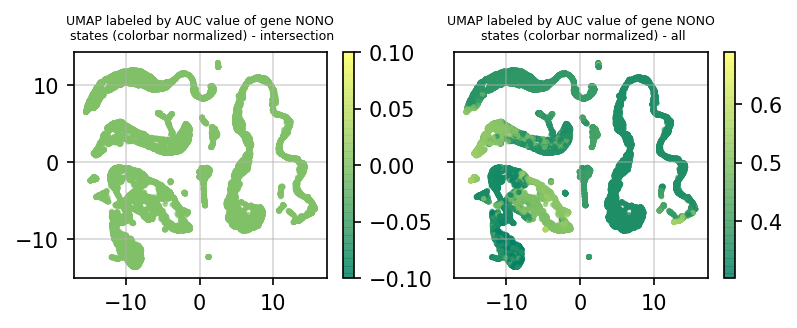

-------
PEG3


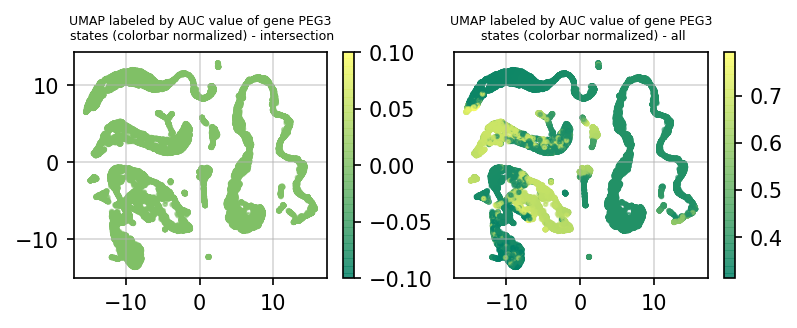

-------
BHLHE40


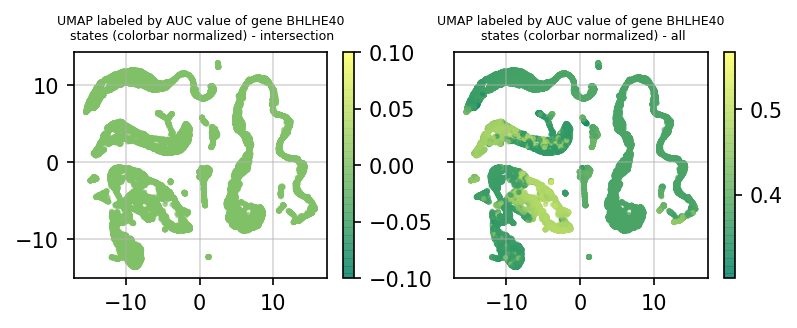

-------
TCF25


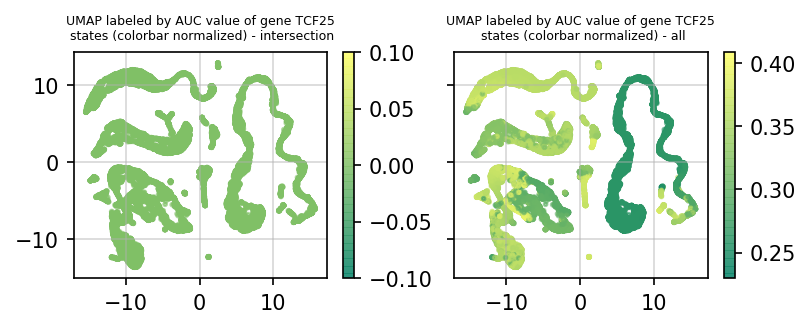

-------
PBRM1


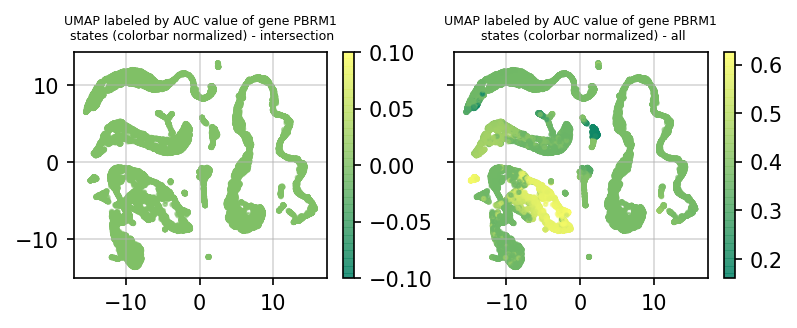

-------
SMARCE1


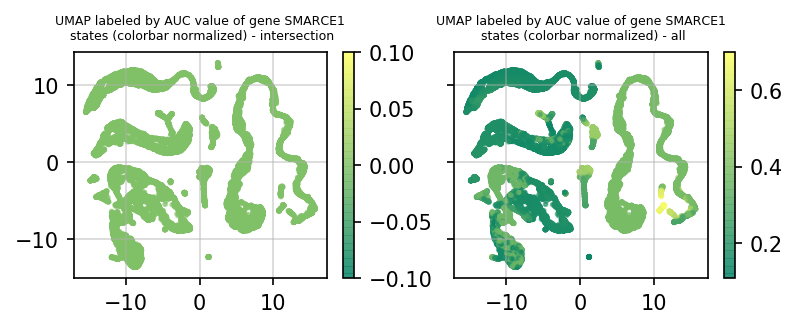

In [36]:
for gene in last_inter_top_all:
    intersect_vs_all(embedding, df, assign_list, AUC_dict_simic, AUC_dict_no_simic, gene.upper(), cmap_name = 'summer')
    

-------
NONO


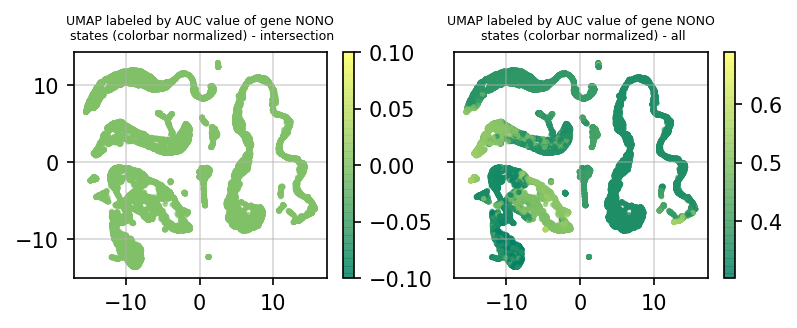

-------
NR0B2


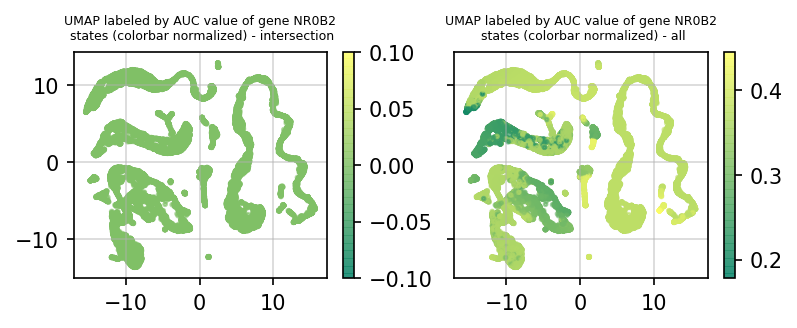

-------
BCL3


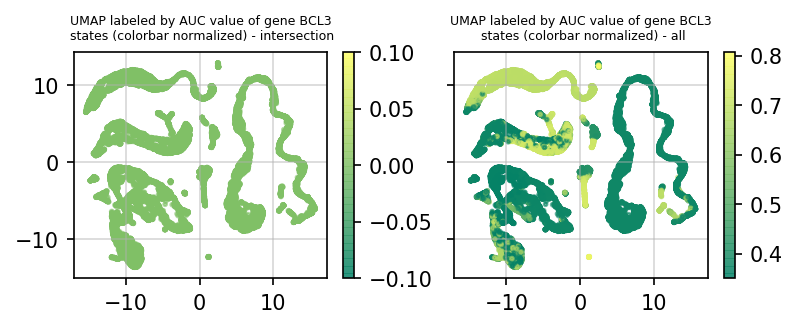

-------
PEG3


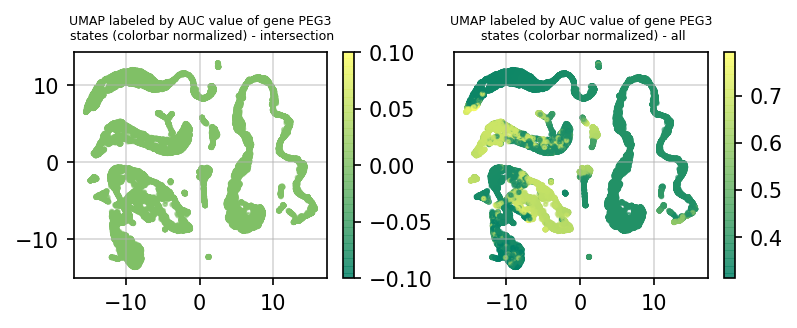

-------
SFPQ


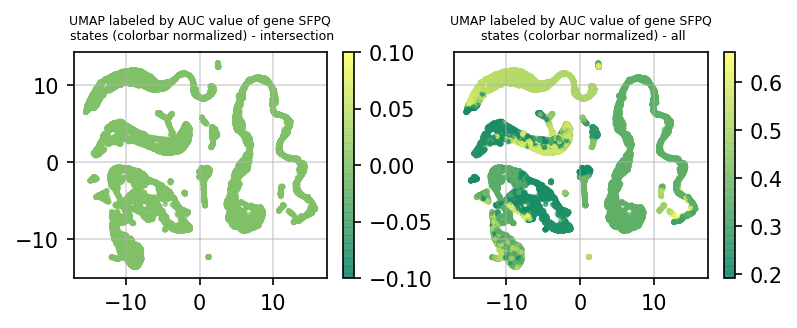

-------
NCOR1


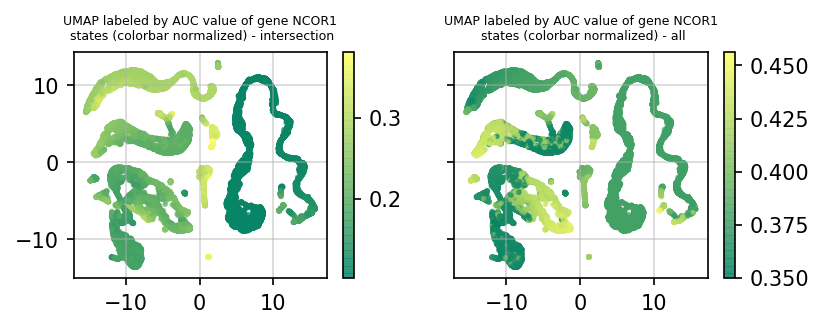

-------
ZFP91


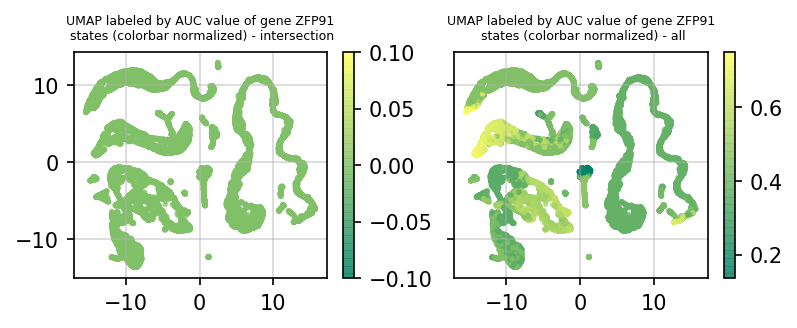

-------
FOXQ1


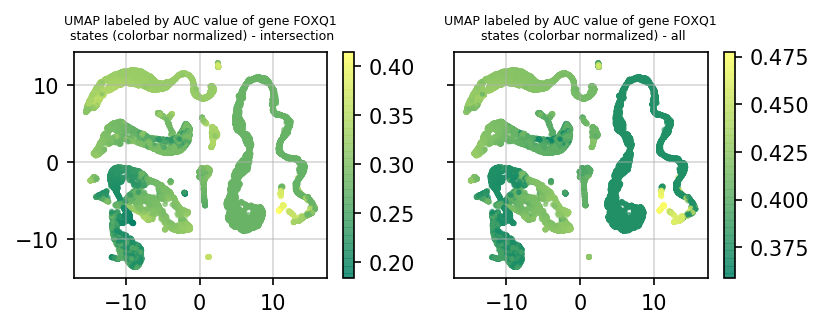

-------
RORA


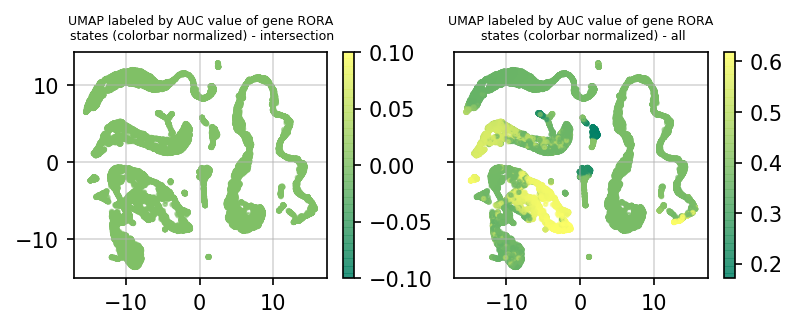

-------
BHLHE40


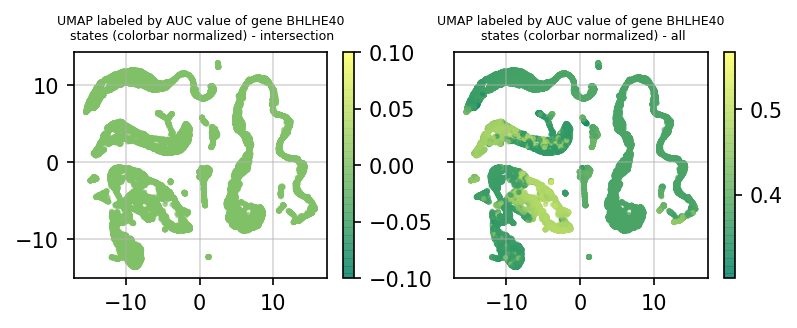

-------
NR3C1


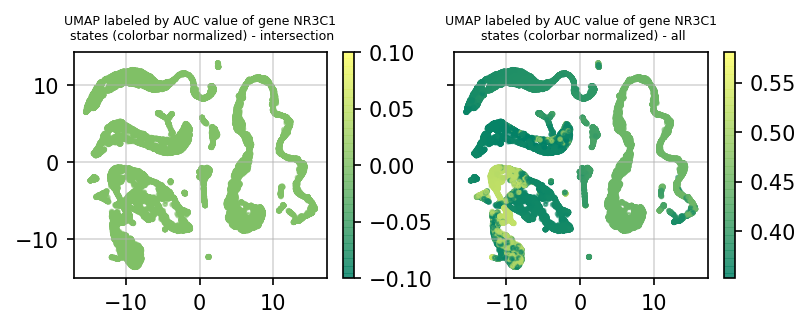

-------
TFAM


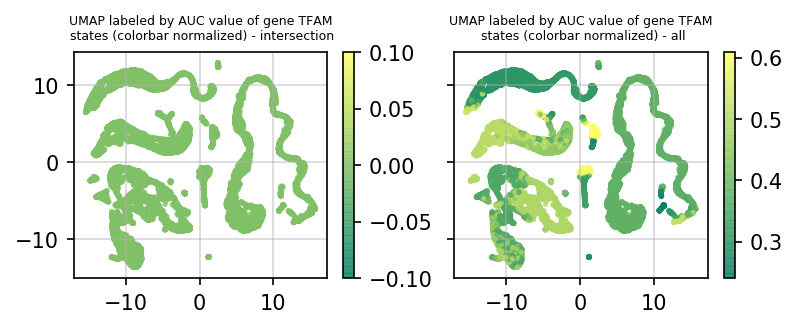

-------
KLF9


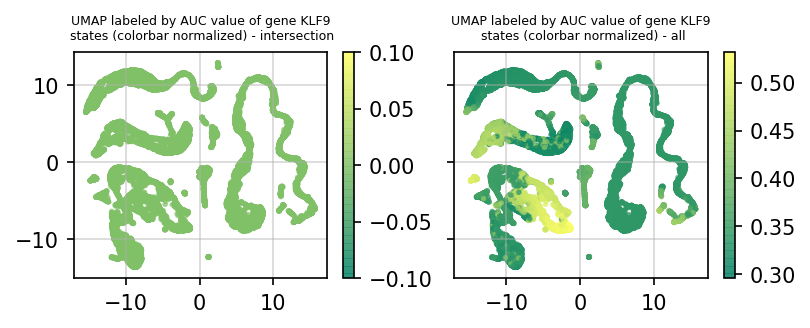

In [37]:
for gene in ['NONO', 'NR0B2', 'BCL3', 'PEG3', 'SFPQ', 'NCOR1', 'ZFP91', 'FOXQ1', 'RORA', 'BHLHE40', 'NR3C1', 'TFAM', 'KLF9']:
    intersect_vs_all(embedding, df, assign_list, AUC_dict_simic, AUC_dict_no_simic, gene.upper(), cmap_name = 'summer')